In [1]:
!apt-get install python3-dev graphviz libgraphviz-dev pkg-config
!pip install pygraphviz

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
pkg-config is already the newest version (0.29.2-1ubuntu3).
graphviz is already the newest version (2.42.2-6).
python3-dev is already the newest version (3.10.6-1~22.04).
python3-dev set to manually installed.
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common libgvc6-plugins-gtk
  librsvg2-common libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk librsvg2-common libxdot4
0 upgraded, 9 newly installed, 0 to remove and 15 not upgraded.
Need to get 2,433 kB of archives.
After this operation, 7,694 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-common all 2.24.33-2ubuntu2 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/m

In [2]:
import os
import numpy as np
import random
import math
from PIL import Image
import cv2
import networkx as nx
from networkx.drawing.nx_agraph import graphviz_layout
import matplotlib.pyplot as plt

In [80]:
def make_dir(folder_path):
  # Check if the folder doesn't exist, then create it
  if not os.path.exists(folder_path):
      os.makedirs(folder_path)
      print(f"Folder '{folder_path}' created.")
  else:
      print(f"Folder '{folder_path}' already exists.")
  return folder_path

In [11]:
def random_color():
  a = random.random()
  b = random.random()
  c = random.random()
  return (a,b,c)

In [116]:
"""
Generate a image(512, 512, 3) corresponding to input graph(nodes, edges)
nodes(list): all nodes in a graph, randomly assigned in range [0, 100)
edges(list): all edges in a graph with the given nodes
img_number(int): denote the img_number-th image would be generated
            <'gi' + img_number> is the name of the generated image
path(str): where the image saved
layout(func): way to denote a graph
is_colored(bool): True then we randomize the node, edge, node_edge, and font colors
"""
def graph_to_image(nodes, edges, img_number, path, layout, is_colored):
  n = len(nodes)
  node_color, edgecolors, font_color, edge_color = 'white', 'black', 'black', 'black'

  # Generate a graph
  G = nx.Graph()
  G.add_nodes_from(nodes)
  G.add_edges_from(edges)

  if is_colored:
    node_colors = {node: random_color() for node in G.nodes}
    edge_colors = {(u,v): random_color() for u,v in G.edges}
    nedgecolors = {ne: random_color() for ne in G.nodes}
    font_colors = {node: random_color() for node in G.nodes}

    node_color = list(node_colors.values())
    edgecolors = list(nedgecolors.values())
    edge_color = list(edge_colors.values())

  """
  nx.circular_layout, nx.planar_layout, nx.kamada_kawai_layout work well for our problem.
  nx.planar_layout fits with our problem best but has an issue of edges crossing irelavant
  nodes. (All these three layouts have the problem.) nx.kamada_kawai_layout works the best
  in edges crossing irelavant nodes, but still has the problem when the there is
  self-pointing node.
  """
  #pos = nx.circular_layout(G, scale=1)
  #pos = nx.planar_layout(G)
  #pos = nx.kamada_kawai_layout(G)
  #pos = nx.nx_pydot.graphviz_layout(G)
  pos = layout(G)

  # Draw the generated graph
  nx.draw(G, pos, with_labels=not is_colored, font_weight='bold',
          node_color=node_color,
          edgecolors=edgecolors,
          edge_color=edge_color,
          font_color=font_color,
          font_size=8,
          linewidths=1)

  if is_colored:
    for node, (r, g, b) in font_colors.items():
      x, y = pos[node]
      plt.text(x, y, str(node), color=(r, g, b), fontsize=8, fontweight='bold',
              ha='center', va='center')

  # Generate the figure
  fig = plt.gcf().set_size_inches(500/64, 500/64, forward=False)
  save_path = path + '/gi' + str(img_number) +'.png'
  plt.savefig(save_path, format='png', dpi=64, bbox_inches='tight')

  # Show the plot (don't delete this line!)
  plt.show()
  return save_path

In [14]:
def image_to_vectors(src_path):
  image = cv2.imread(src_path)
  image_array = np.array(image)

  return image_array

In [78]:
def gen_graphs(num):
  node_list = []
  edge_list = []
  random.seed(493) # change the random seed to generate diff graphs
  for i in range(num):
    n = random.randint(1, 40)
    m = random.randint(0, 80)
    nodes = random.sample(range(0, 100), n)
    edge_left = random.choices(nodes, k=m)
    edge_right = random.choices(nodes, k=m)
    edges = list(zip(edge_left, edge_right))
    """
    print("n:", n, " m:", m)
    print("nodes:", nodes)
    print("edges:", edges)
    """
    node_list.append(nodes)
    edge_list.append(edges)
  return node_list, edge_list

In [95]:
def update_edges(e):
  e2 = [(min(x), max(x)) for x in e]
  e2.sort()
  e2=list(set(e2))
  e2.sort()
  return e2

In [109]:
def generate_label(n,e):
  labels = dict()
  n.sort()
  e2 = update_edges(e)
  for i in n:
    labels[i] = []
    for j in e2:
      if (j[0] == i and j[1] == i) or \
         (j[0] == i or j[1] == i):
        labels[i].append(j)
  return labels

In [111]:
# example of output(label), delete it
s = [62, 96, 48, 91, 70, 75, 77, 27, 76, 52, 36, 6, 56, 95, 79, 49, 11, 26, 46, 2, 28]
q = [(77, 36), (91, 46), (76, 77), (91, 36), (95, 49), (6, 49), (70, 79), (46, 52),(2,2)]
p=generate_label(s,q)
print(p)

{2: [(2, 2)], 6: [(6, 49)], 11: [], 26: [], 27: [], 28: [], 36: [(36, 77), (36, 91)], 46: [(46, 52), (46, 91)], 48: [], 49: [(6, 49), (49, 95)], 52: [(46, 52)], 56: [], 62: [], 70: [(70, 79)], 75: [], 76: [(76, 77)], 77: [(36, 77), (76, 77)], 79: [(70, 79)], 91: [(36, 91), (46, 91)], 95: [(49, 95)], 96: []}


In [112]:
gv0 = make_dir('/content/graph_images_gv') # dir for nx.nx_pydot.graphviz_layout without color
kk0 = make_dir('/content/graph_images_kk') # dir for nx.kamada_kawai_layout without color
gv1 = make_dir('/content/graph_images_gv_color') # dir for nx.nx_pydot.graphviz_layout with color
kk1 = make_dir('/content/graph_images_kk_color') # dir for nx.kamada_kawai_layout with color

Folder '/content/graph_images_gv' created.
Folder '/content/graph_images_kk' created.
Folder '/content/graph_images_gv_color' created.
Folder '/content/graph_images_kk_color' created.


In [119]:
def generate_data(num, layout, is_colored, saved_path):
  nodes, edges = gen_graphs(50)
  data = []
  for i in range(len(nodes)):
    n = nodes[i]
    e = edges[i]
    path = graph_to_image(n, e, i, saved_path, layout, is_colored)
    arr = image_to_vectors(path) # x
    label = generate_label(n,e) # y
    data.append((arr, label))
  return data

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


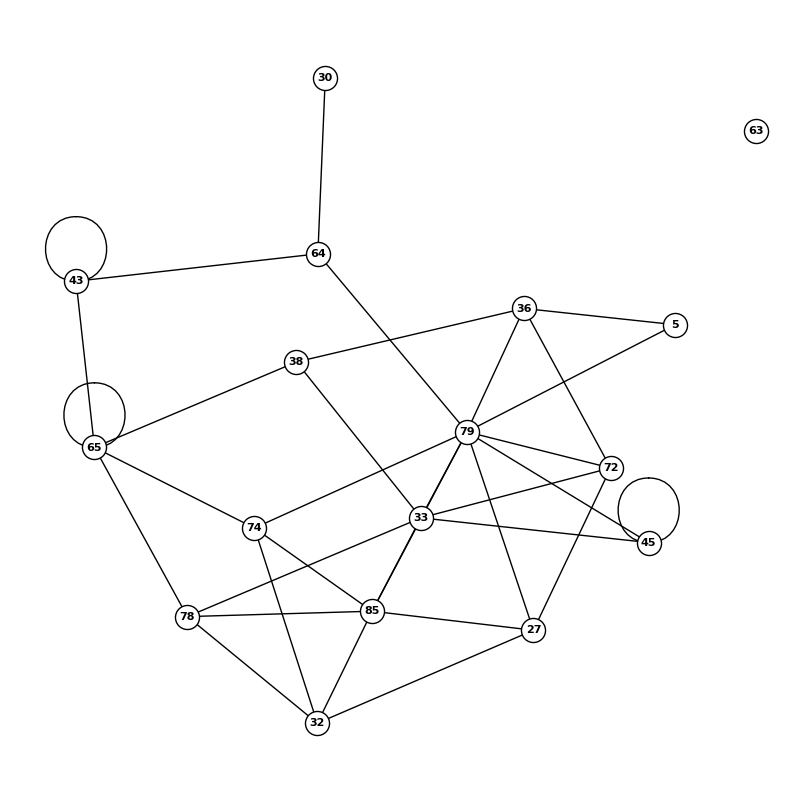

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


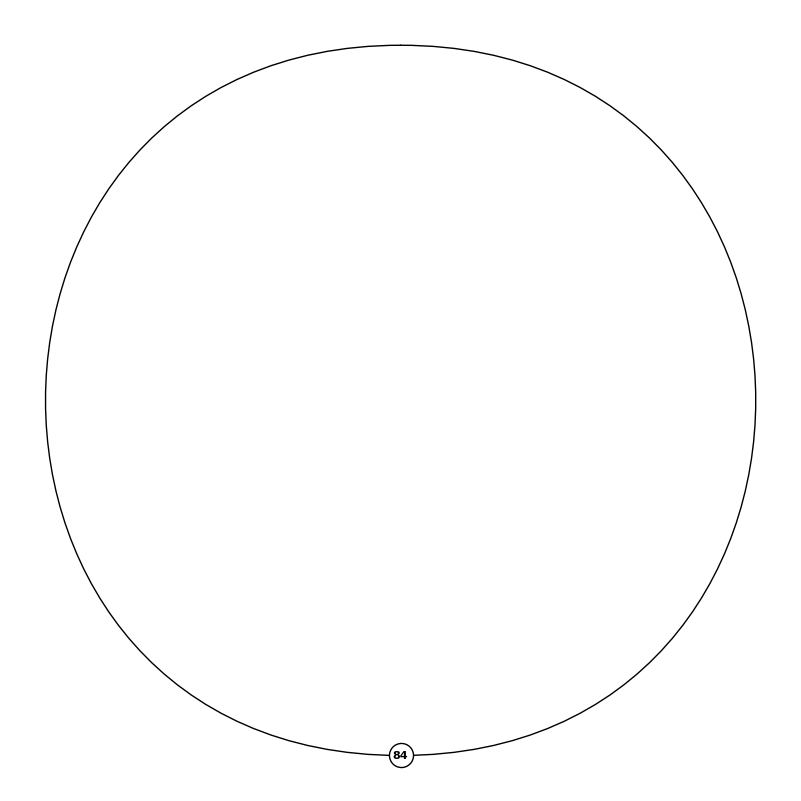

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


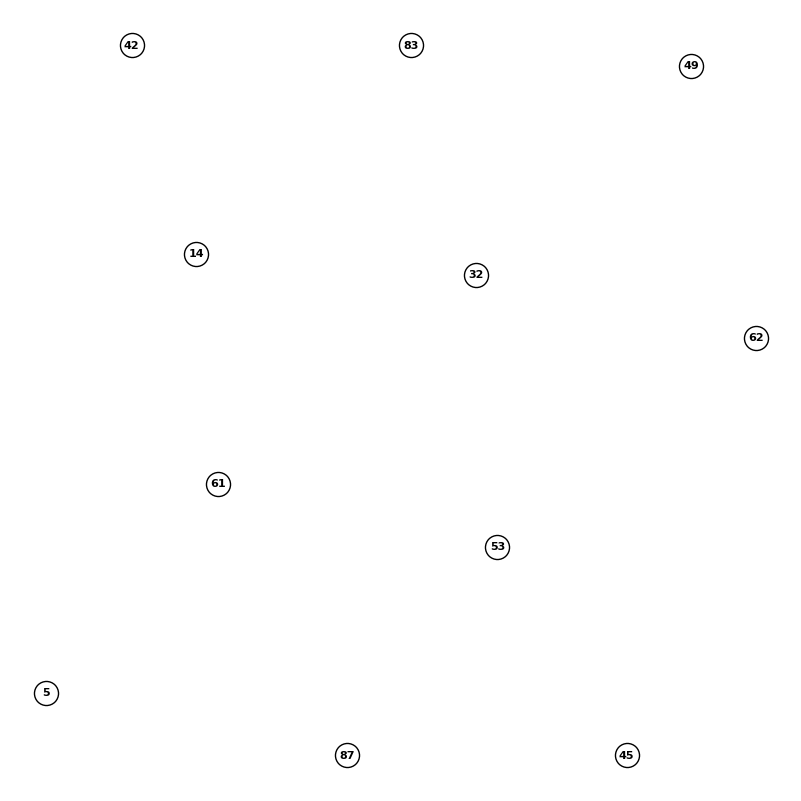

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


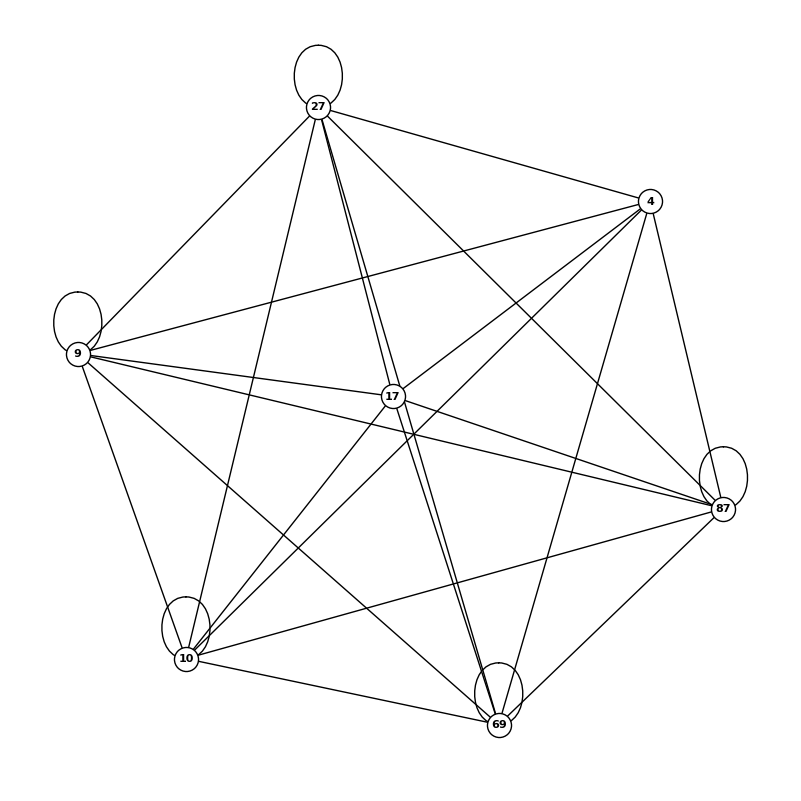

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


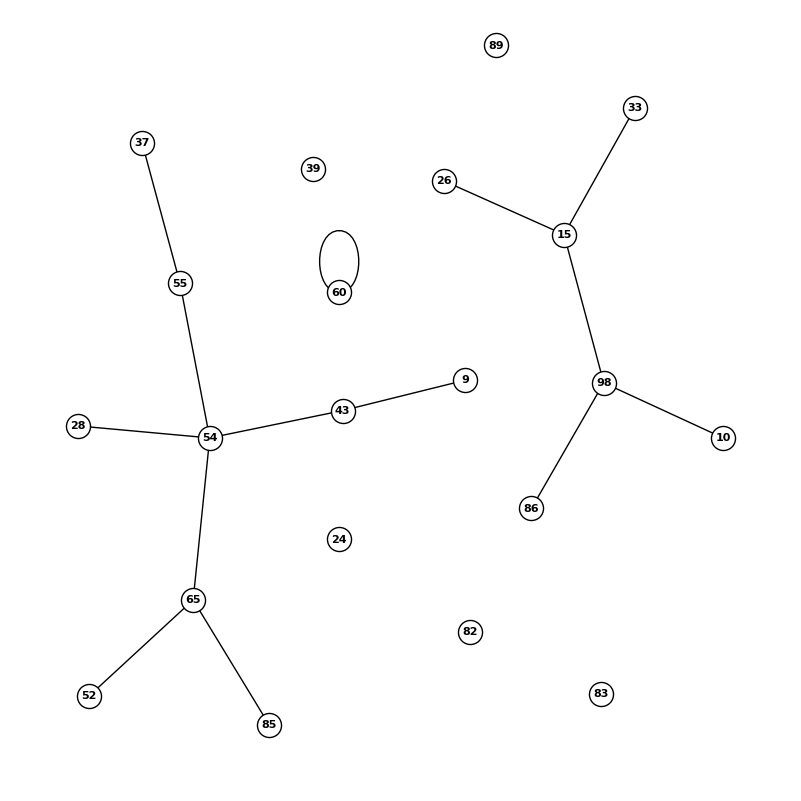

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


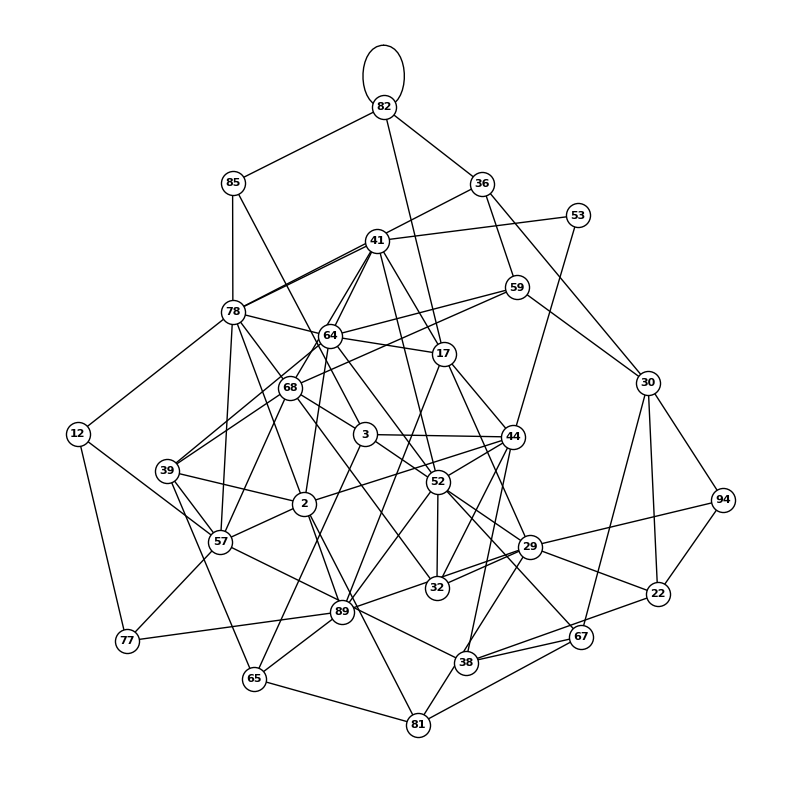

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


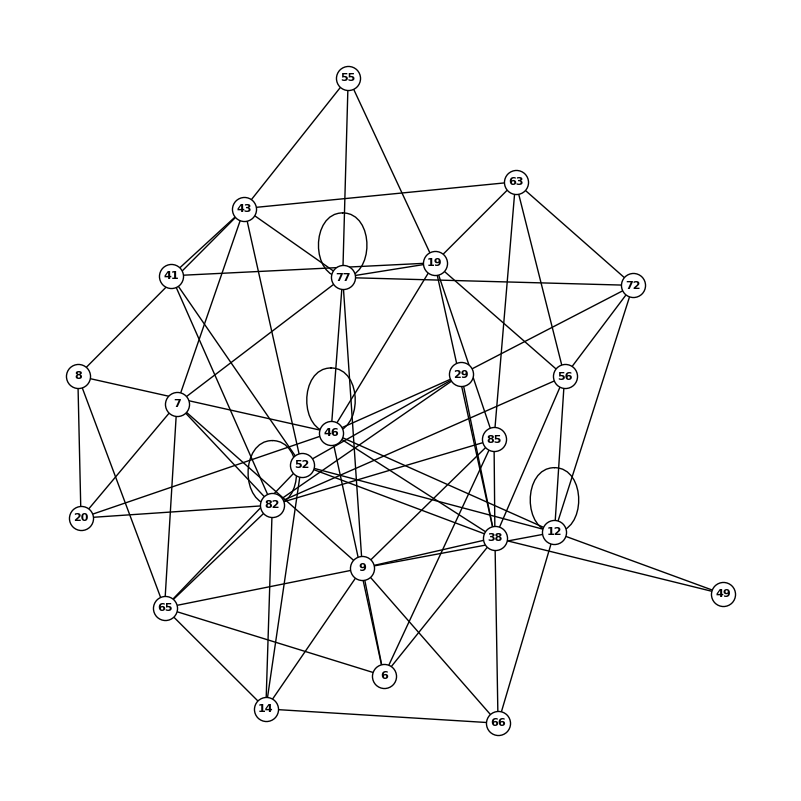

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


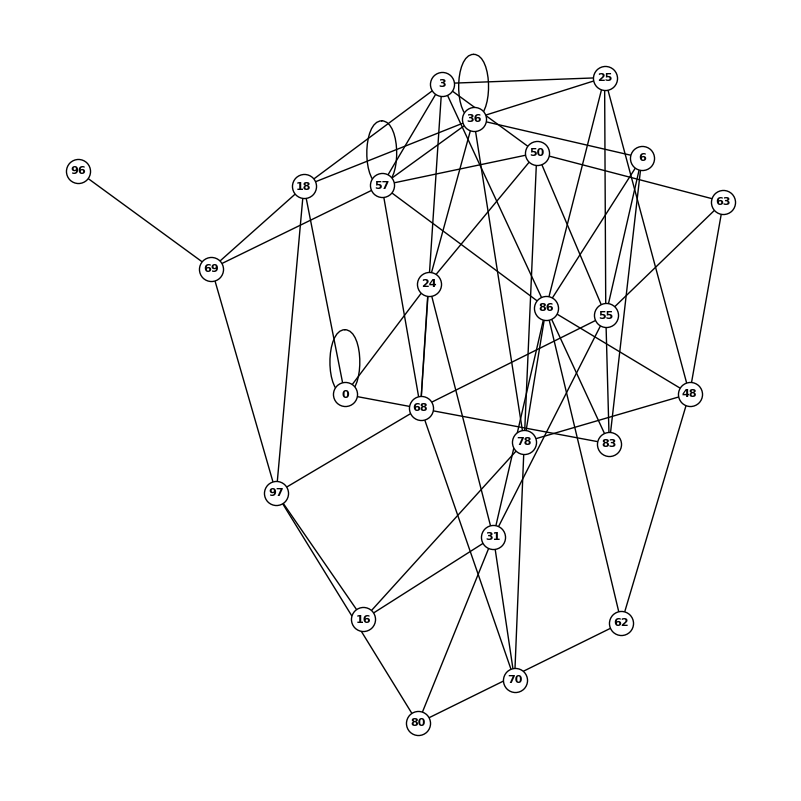

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


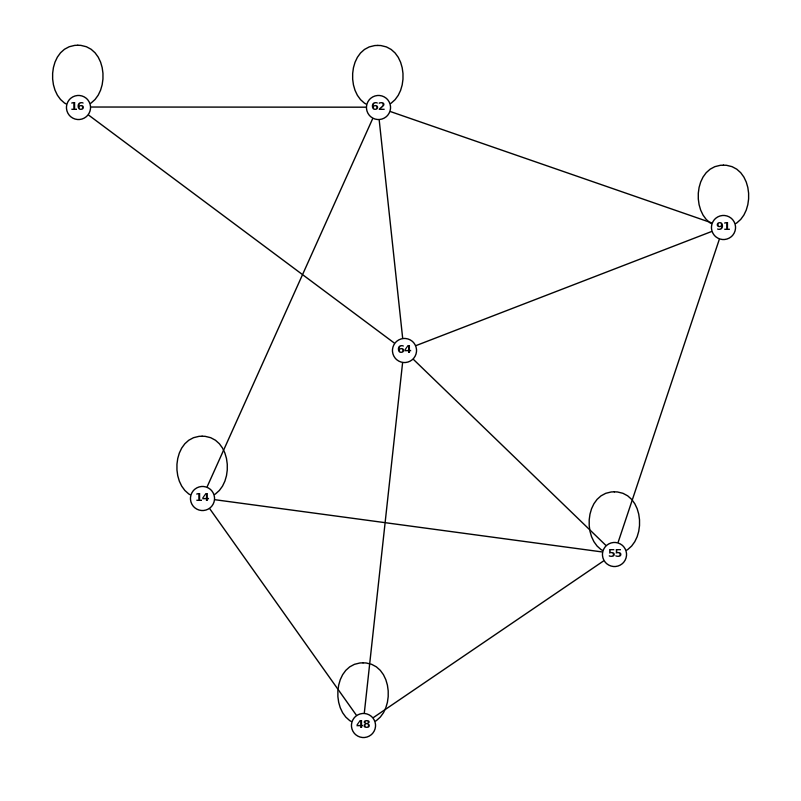

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


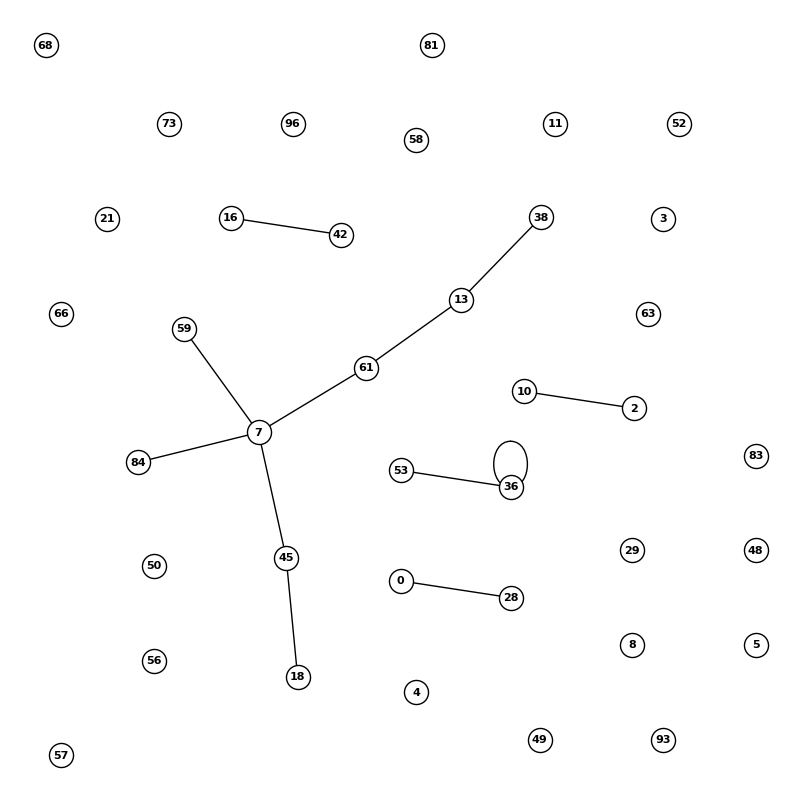

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


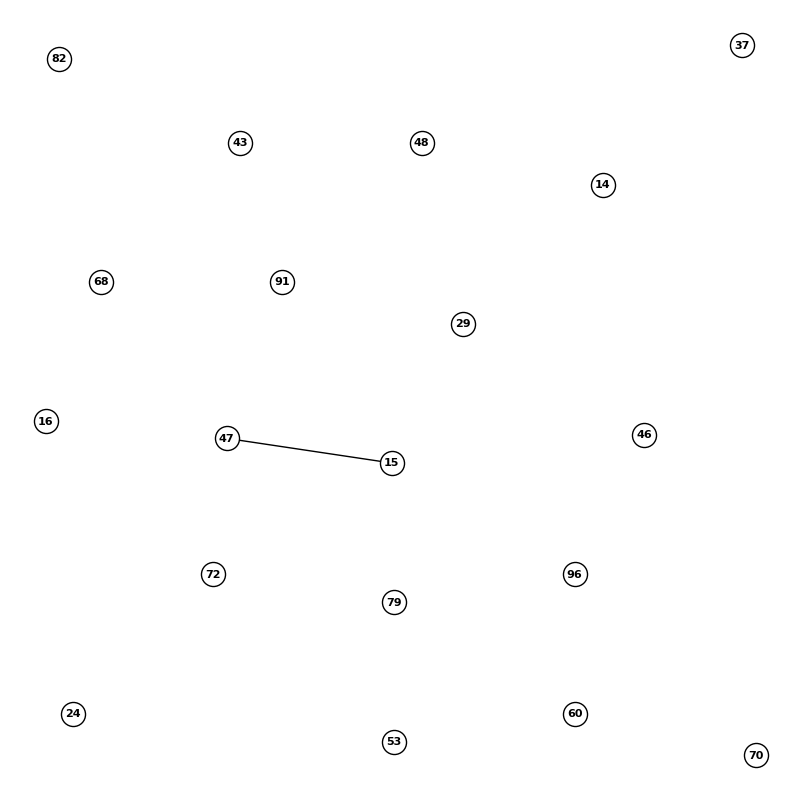

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


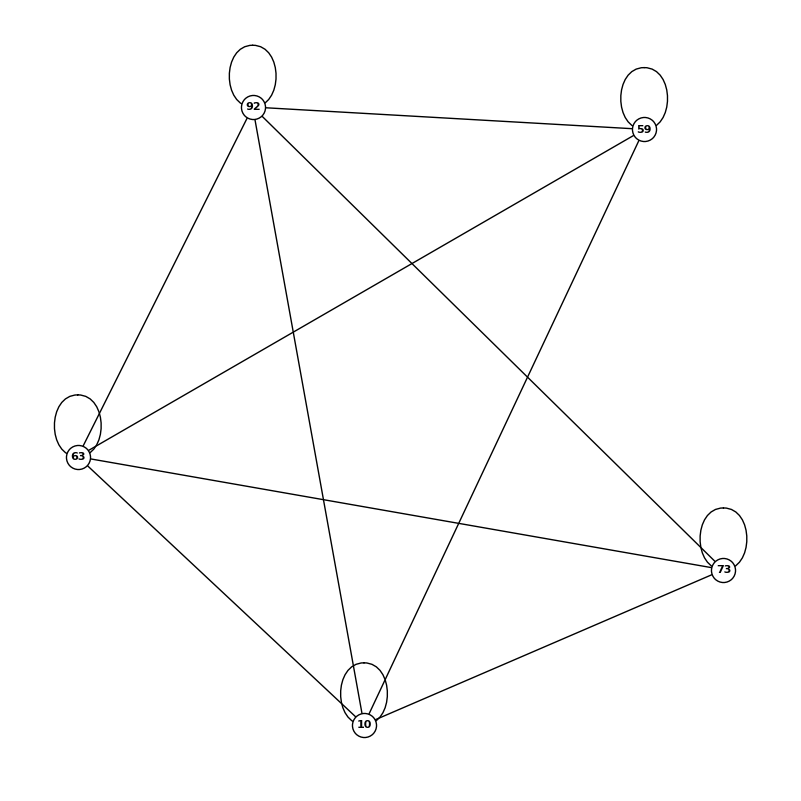

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


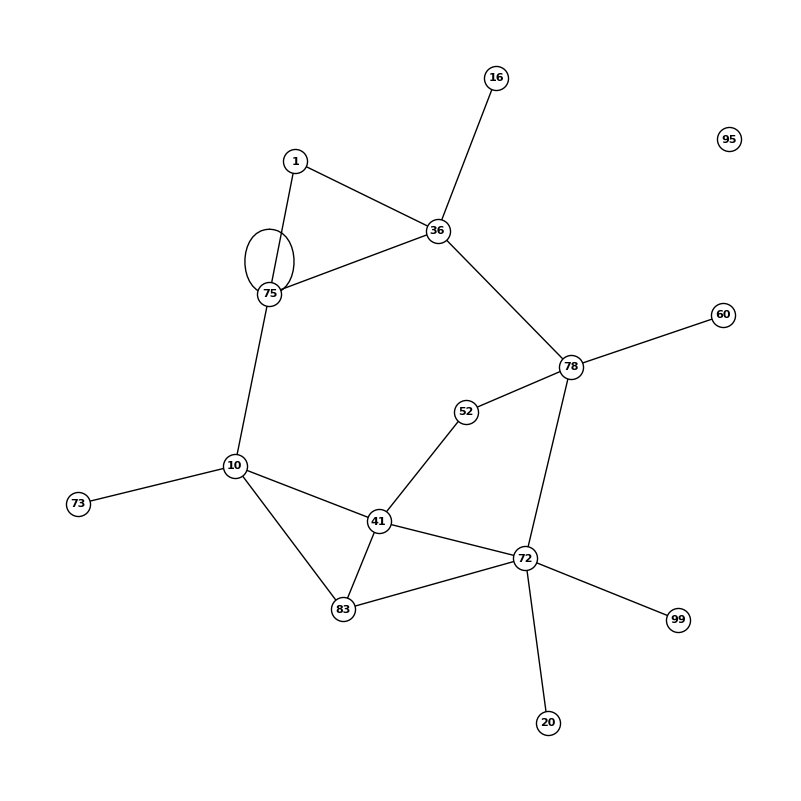

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


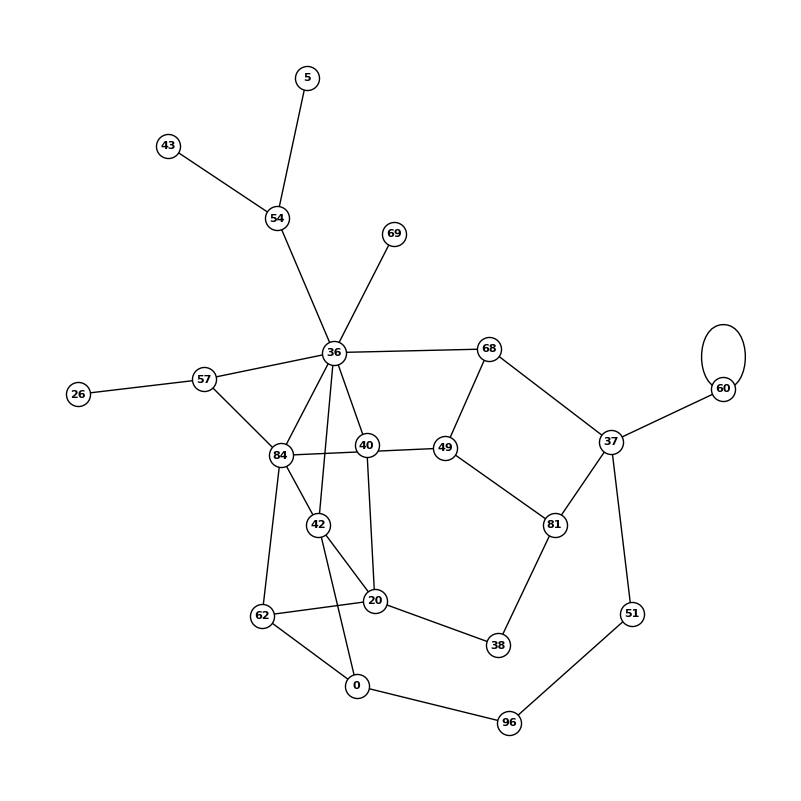

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


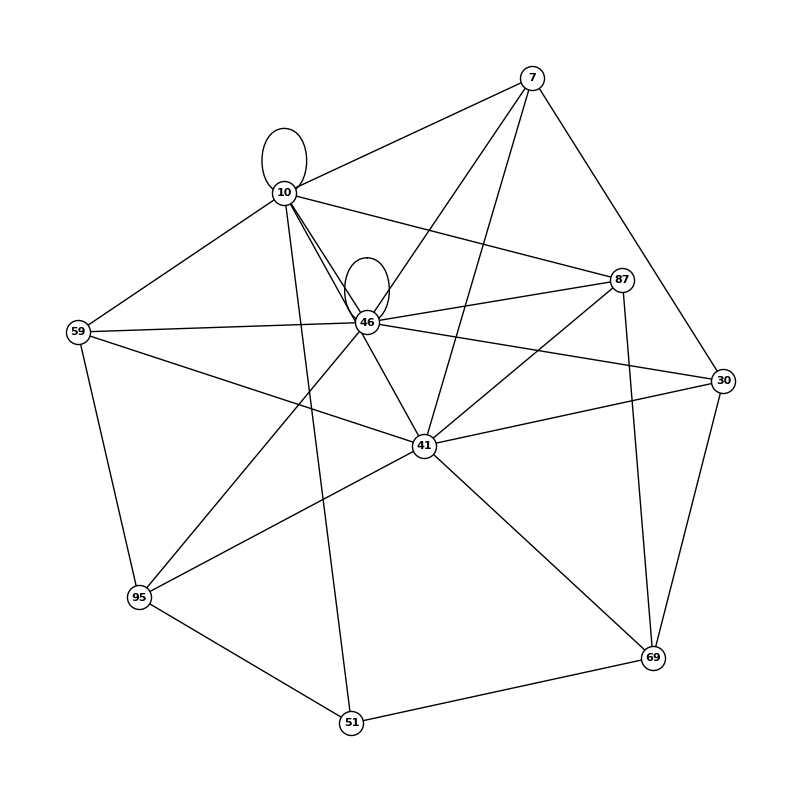

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


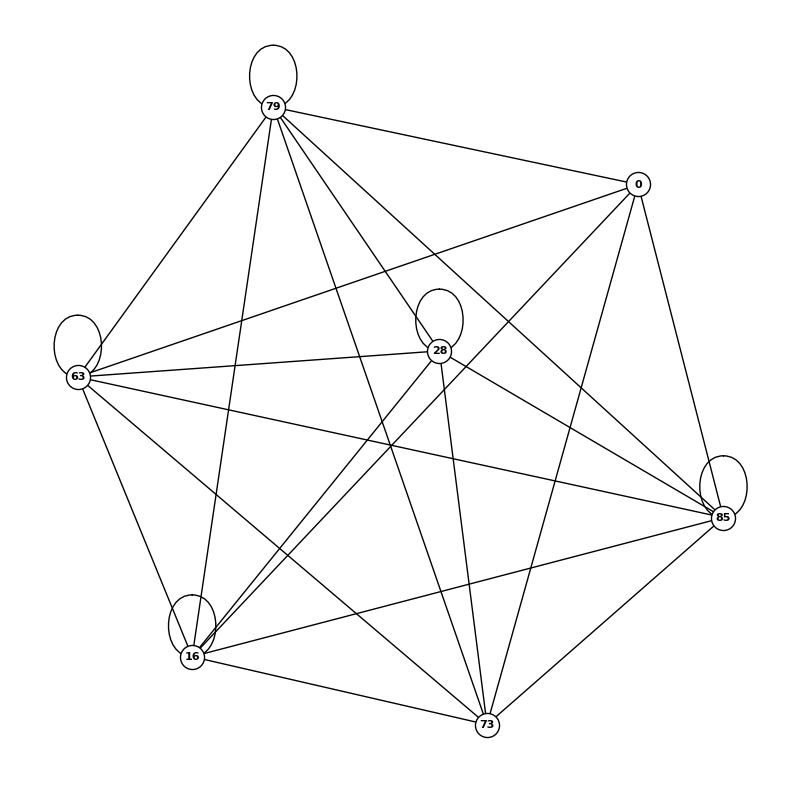

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


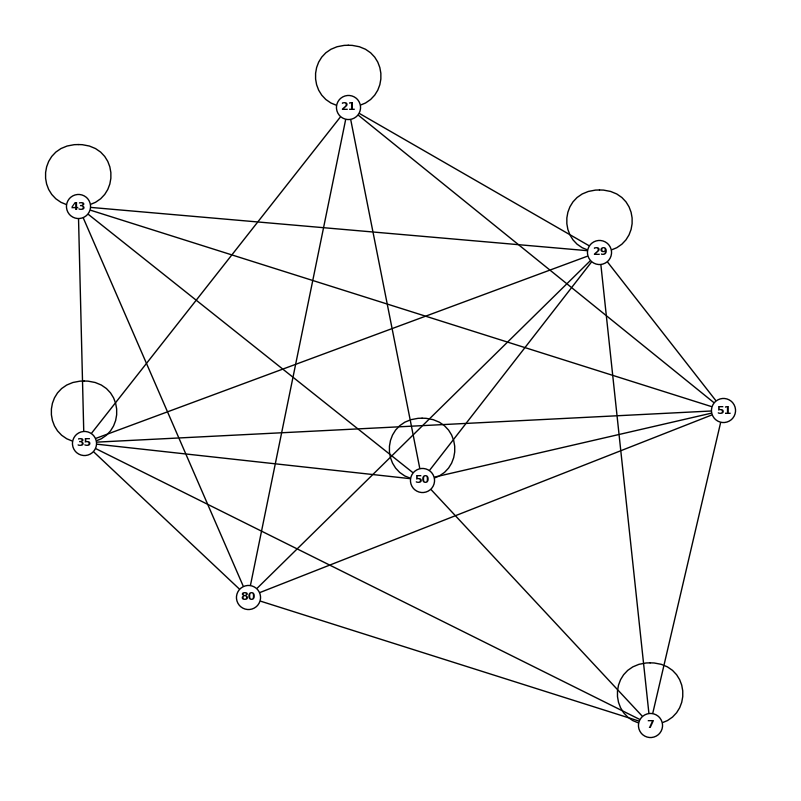

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


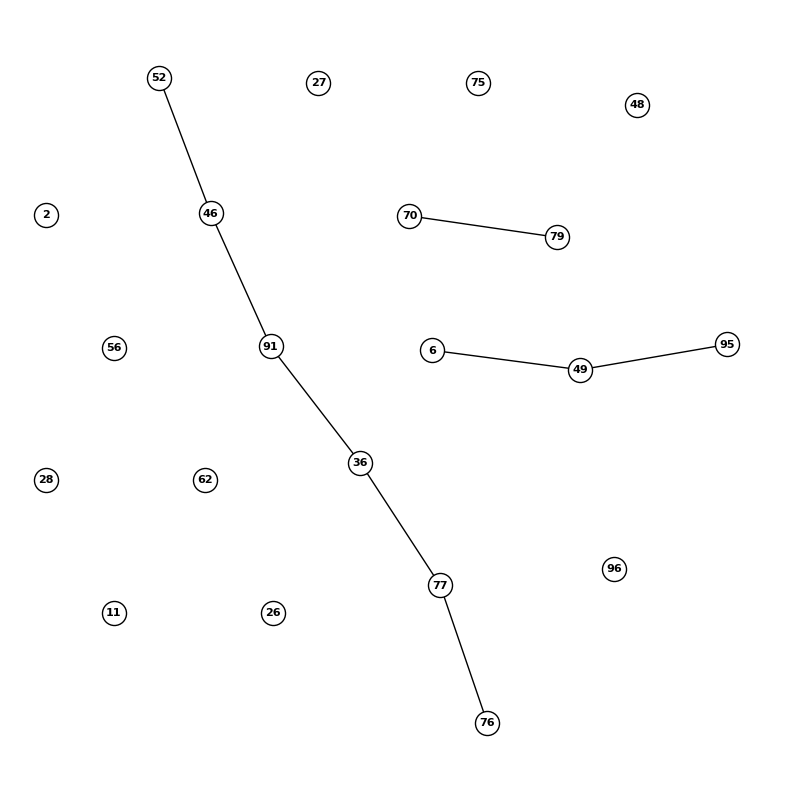

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


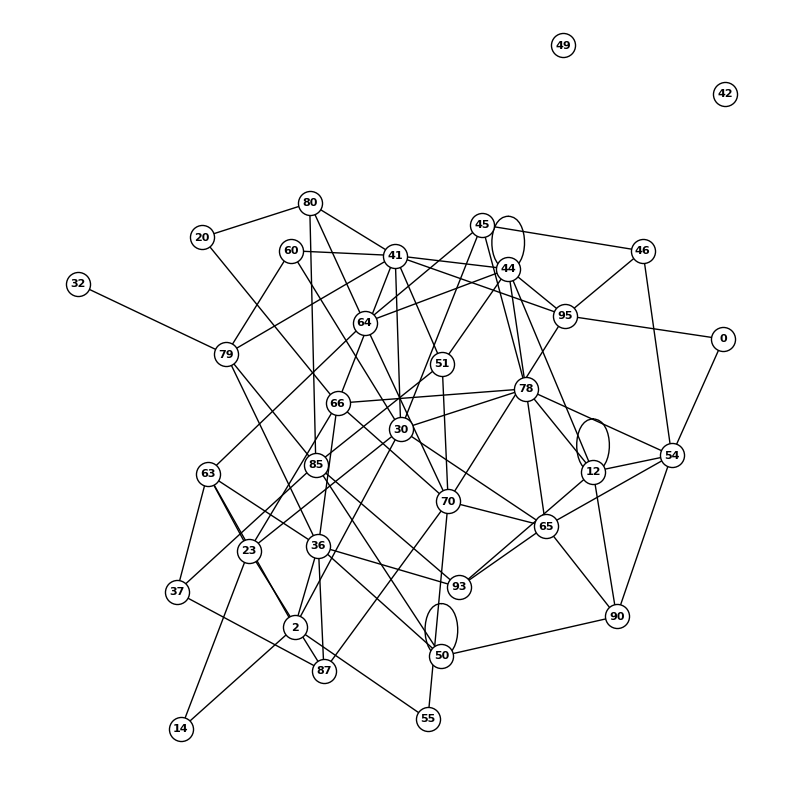

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


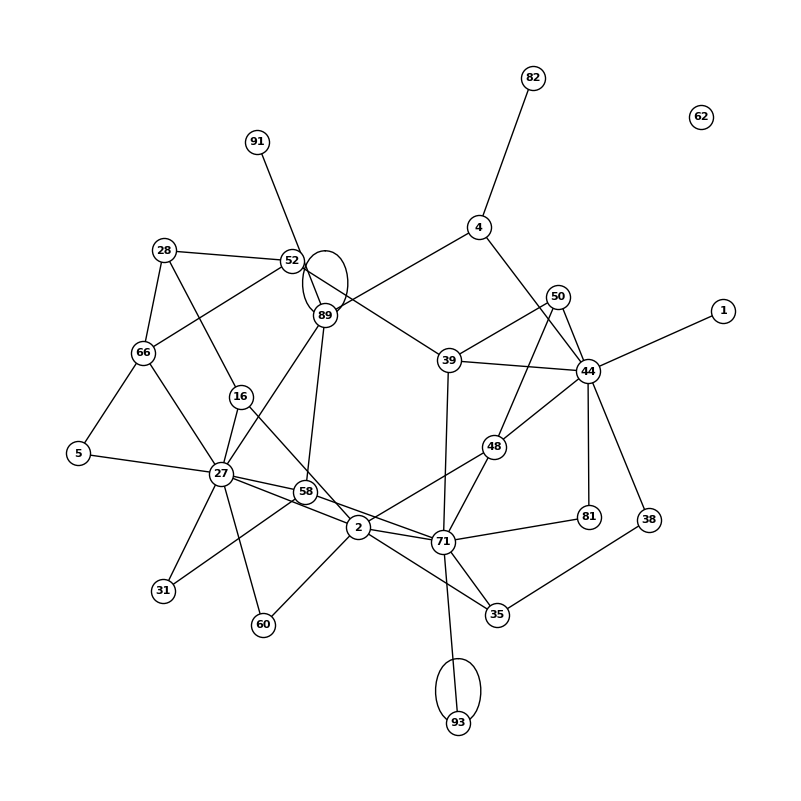

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


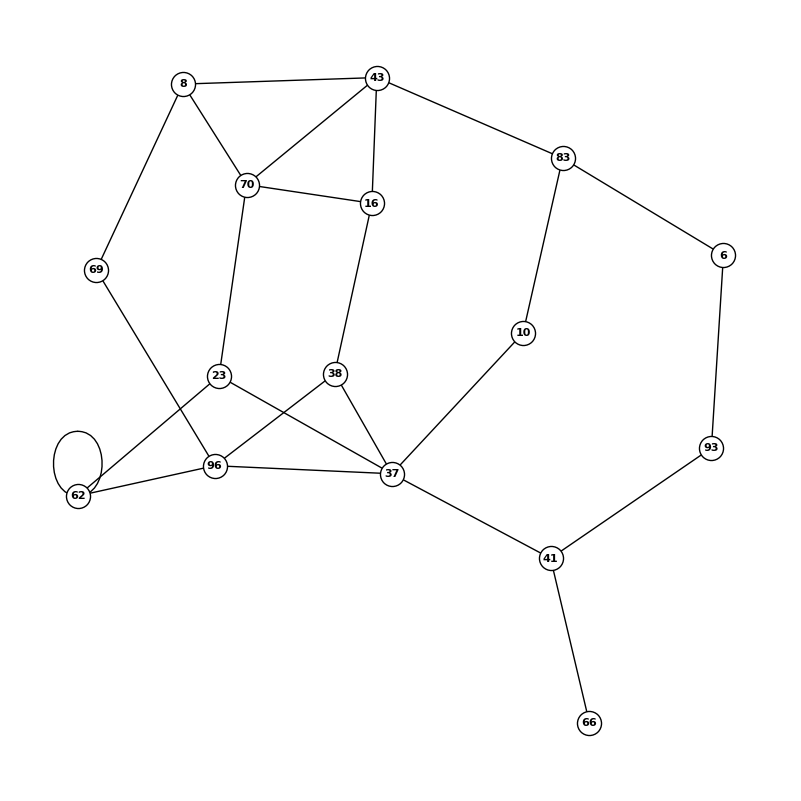

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


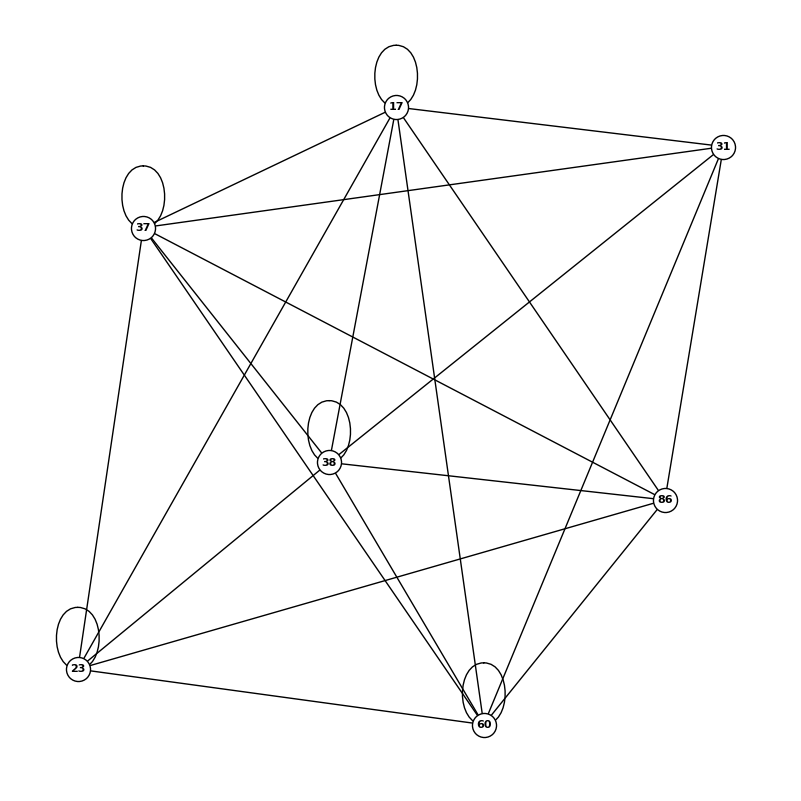

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


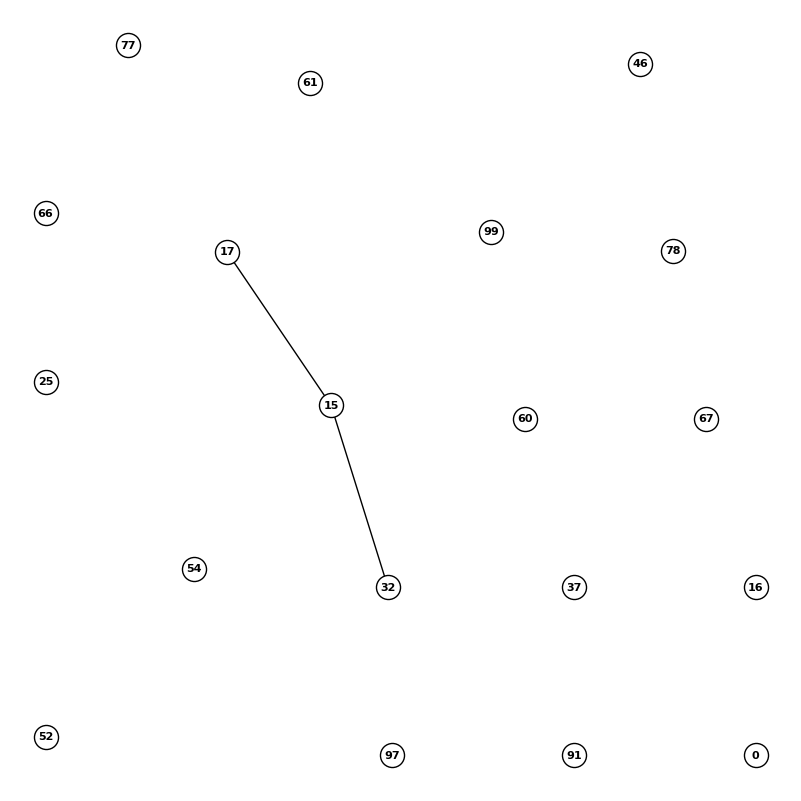

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


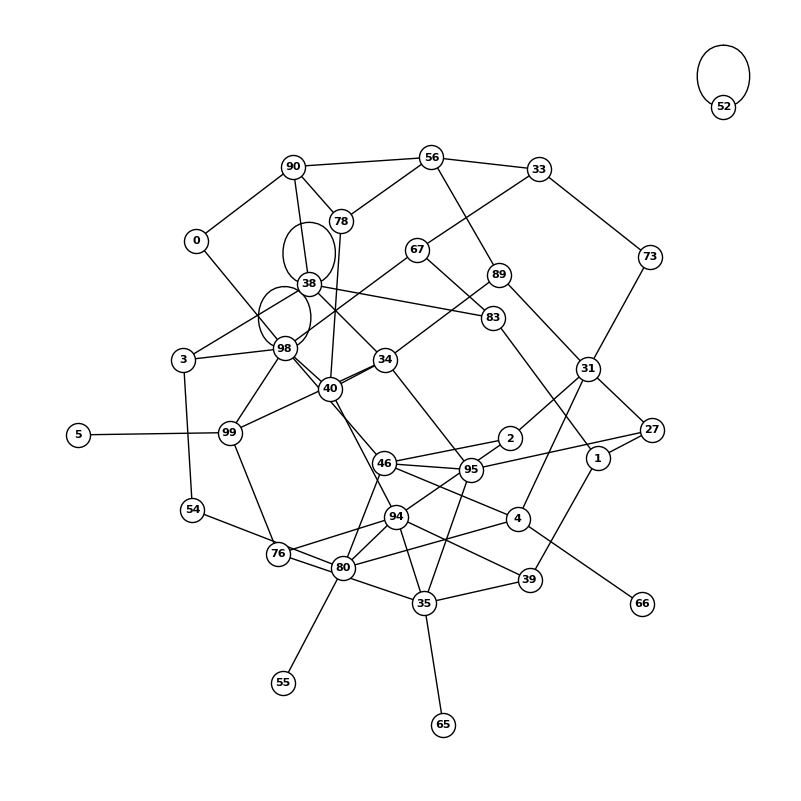

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


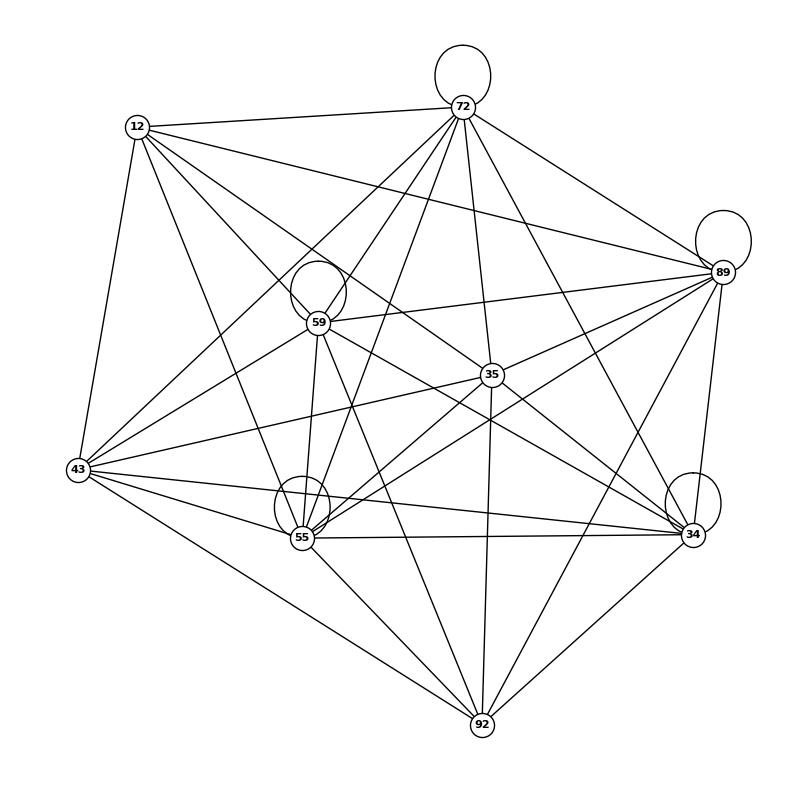

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


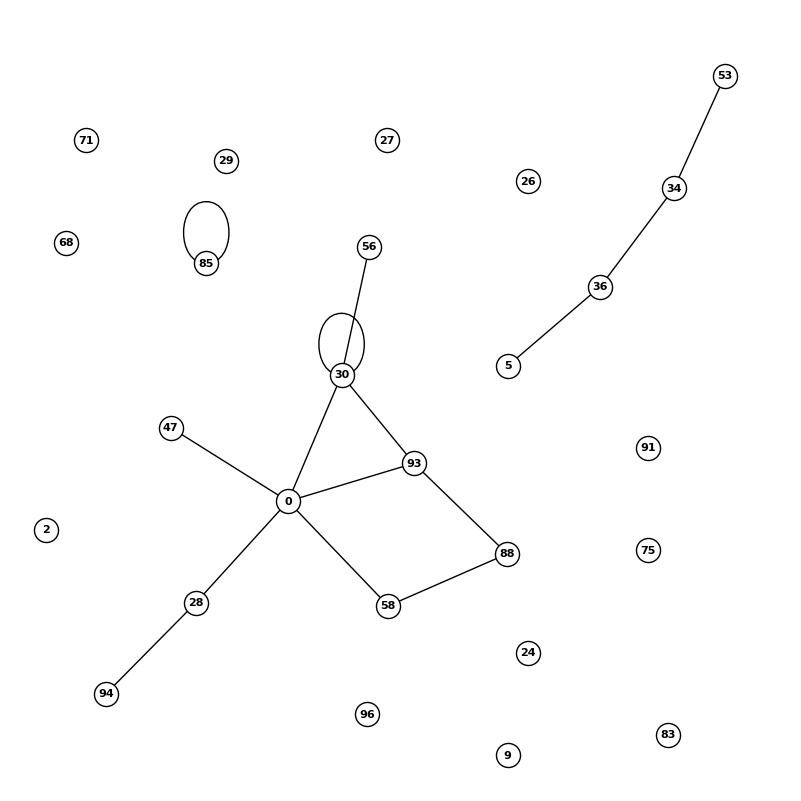

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


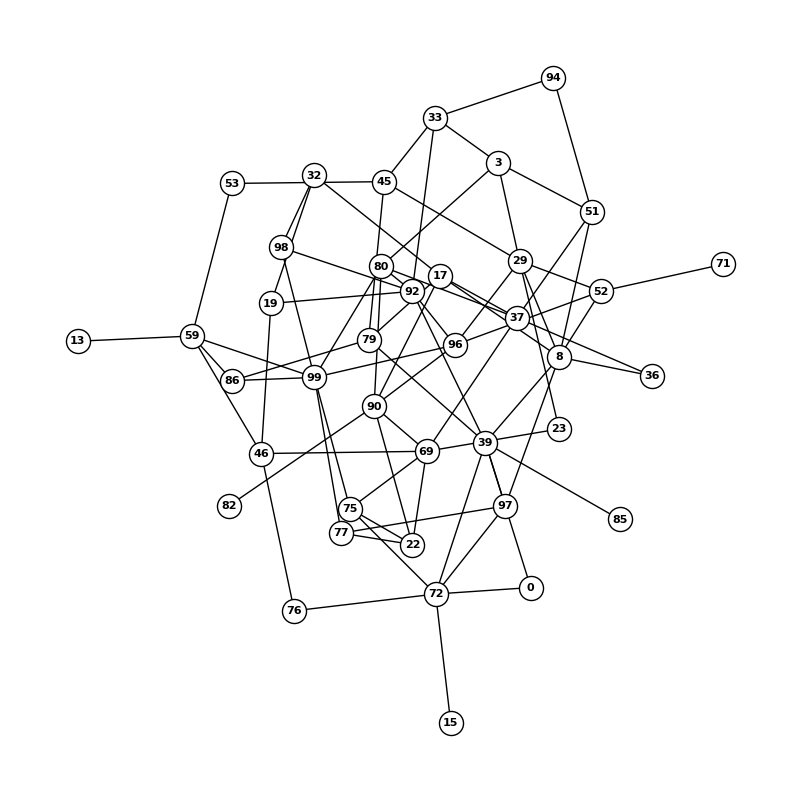

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


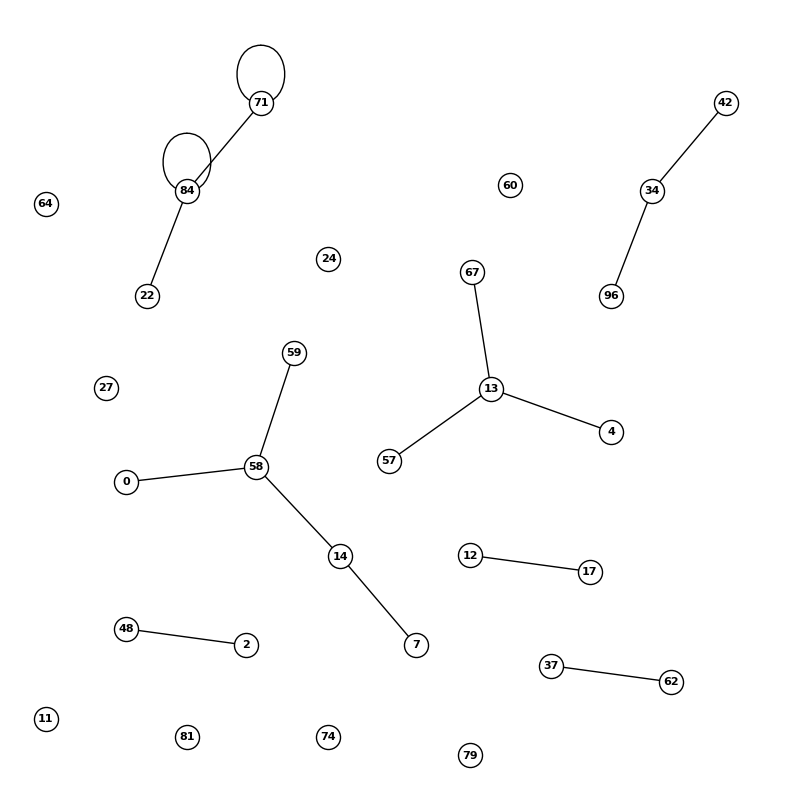

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


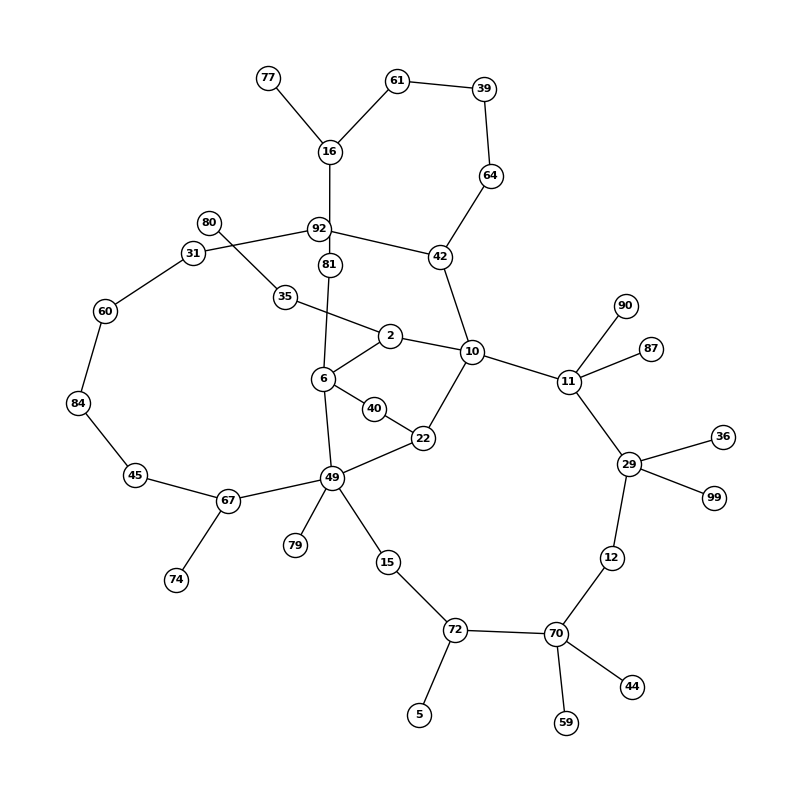

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


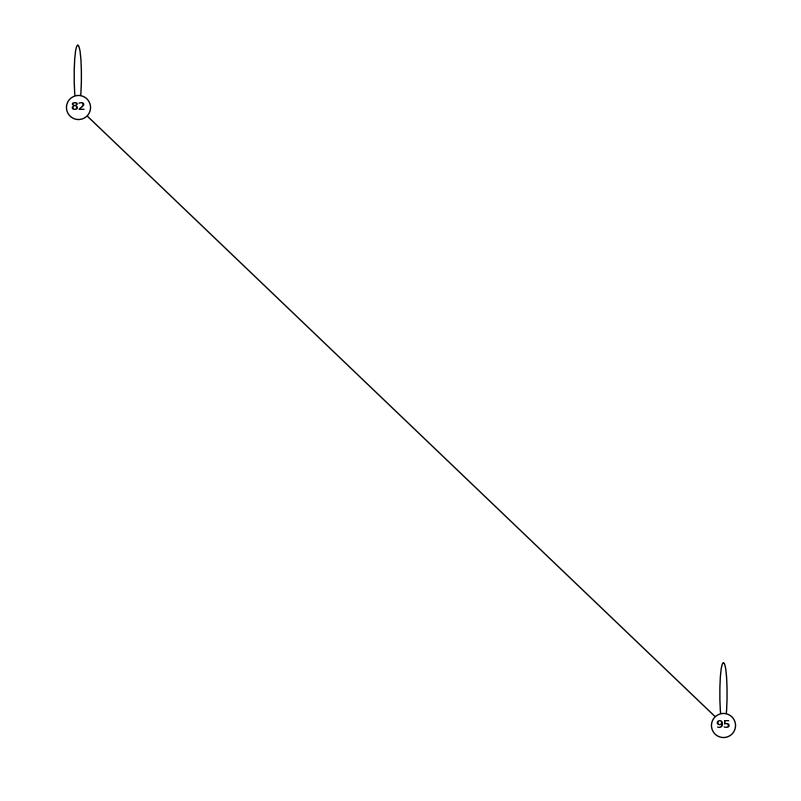

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


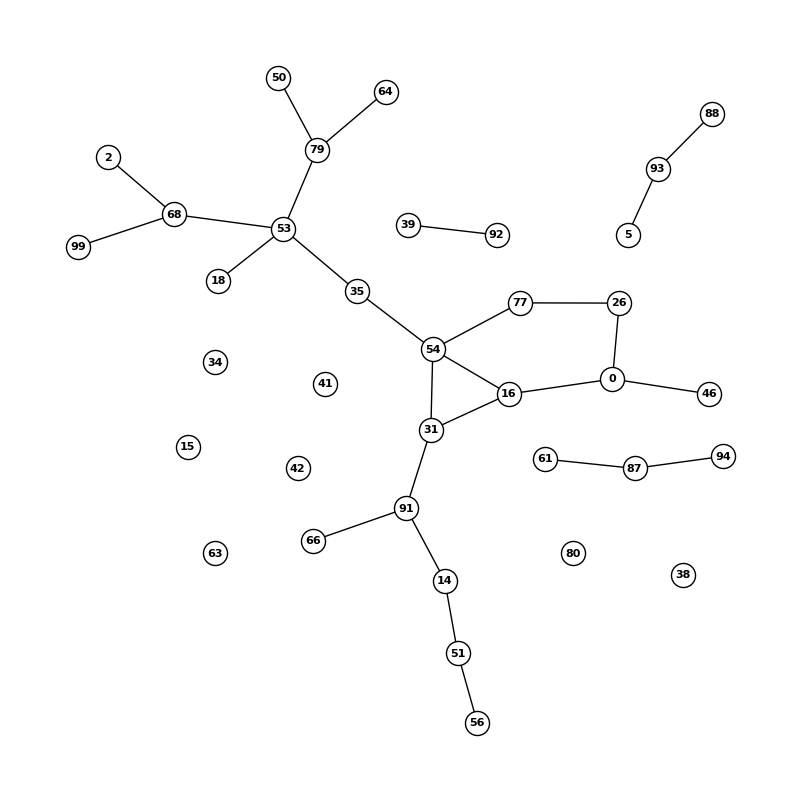

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


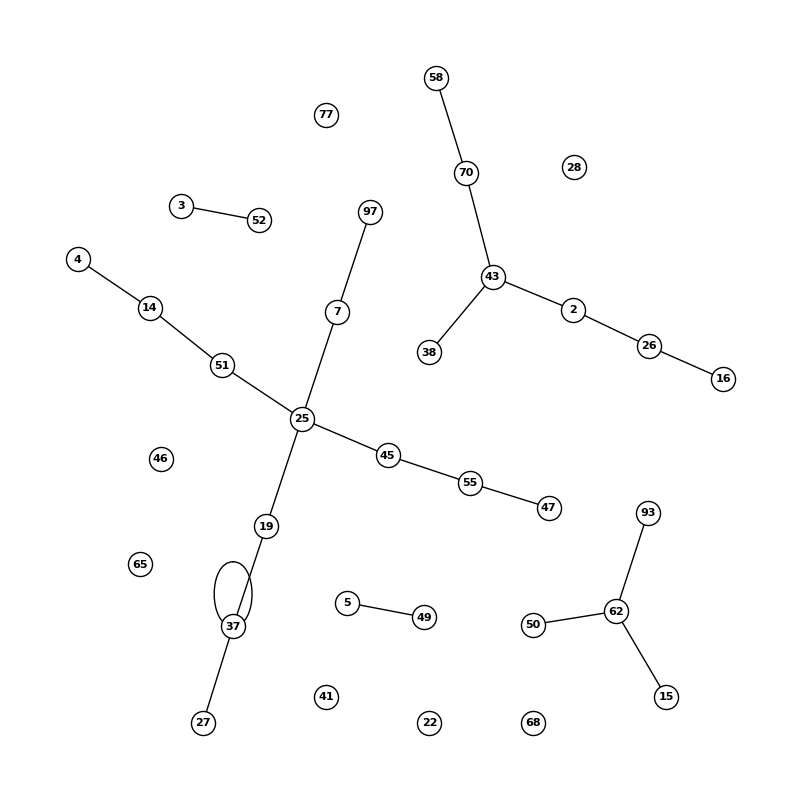

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


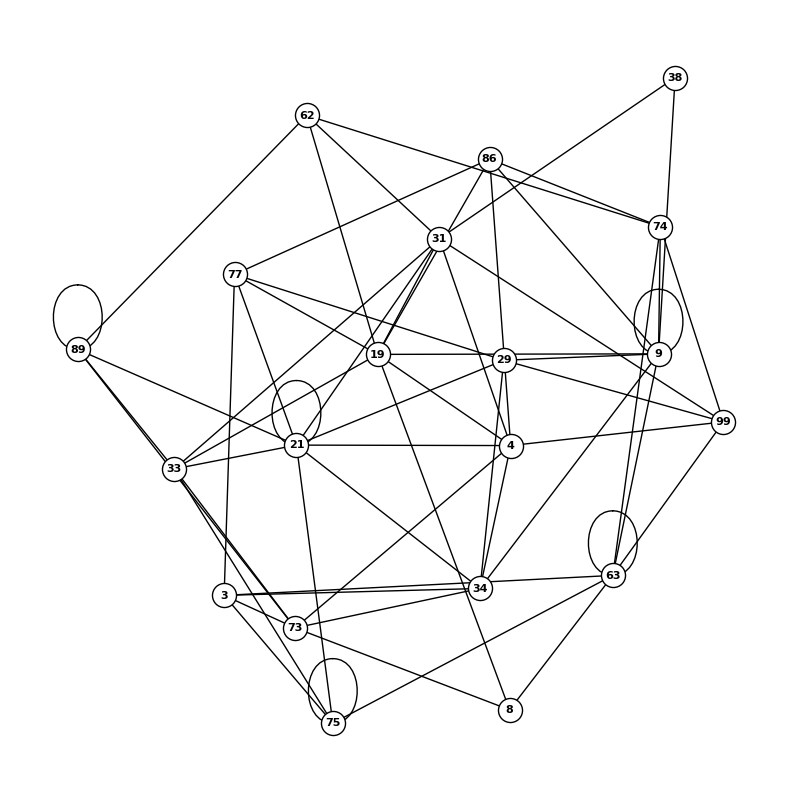

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


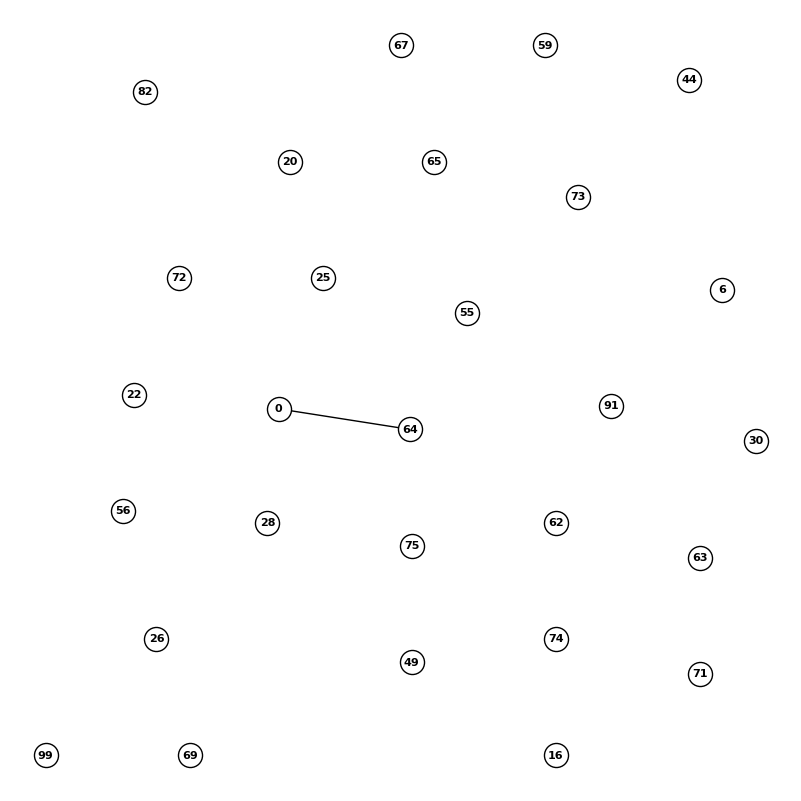

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


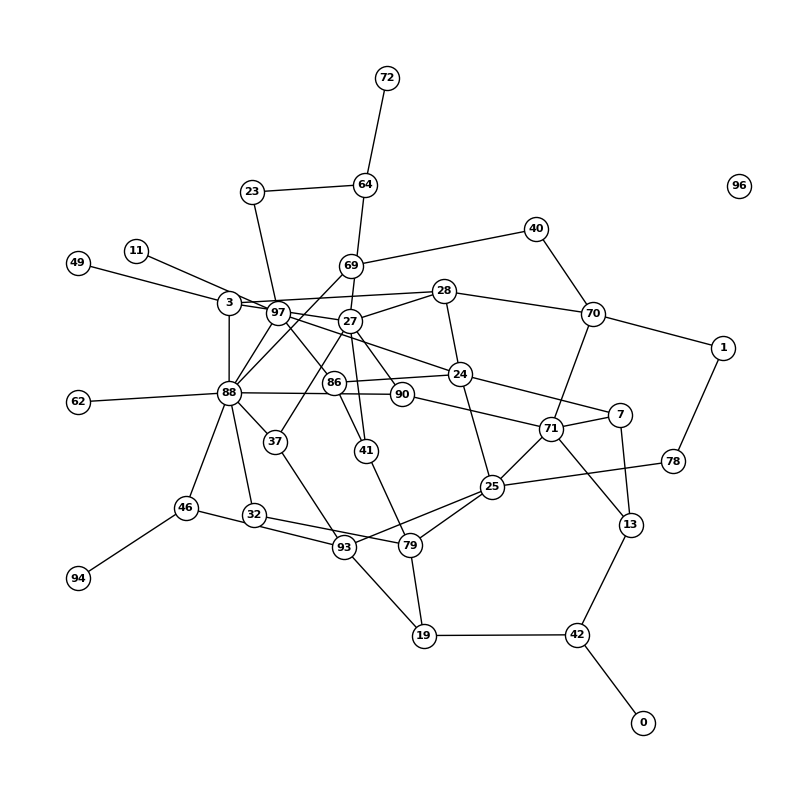

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


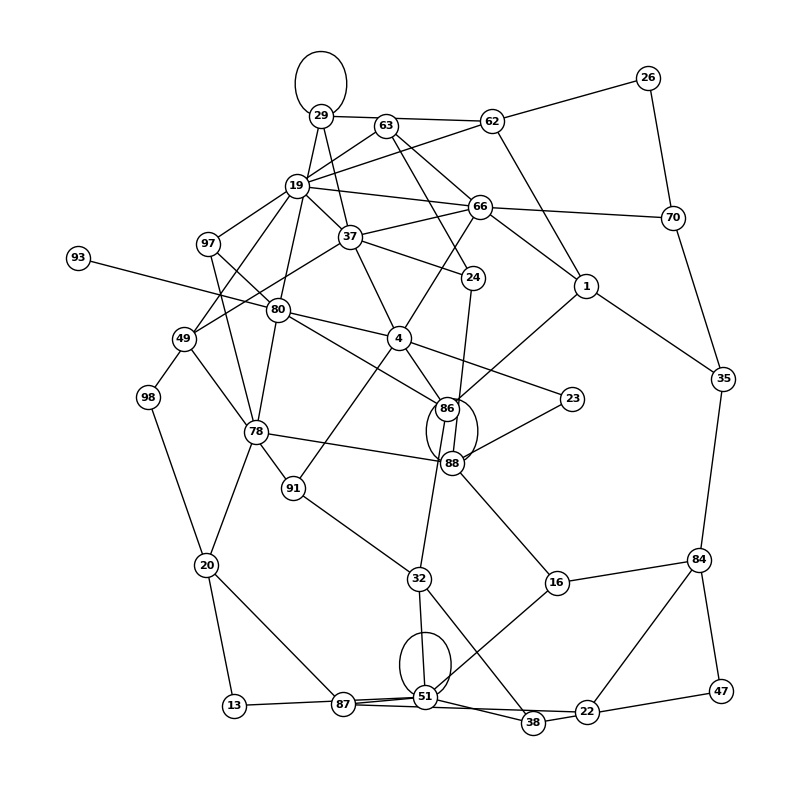

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


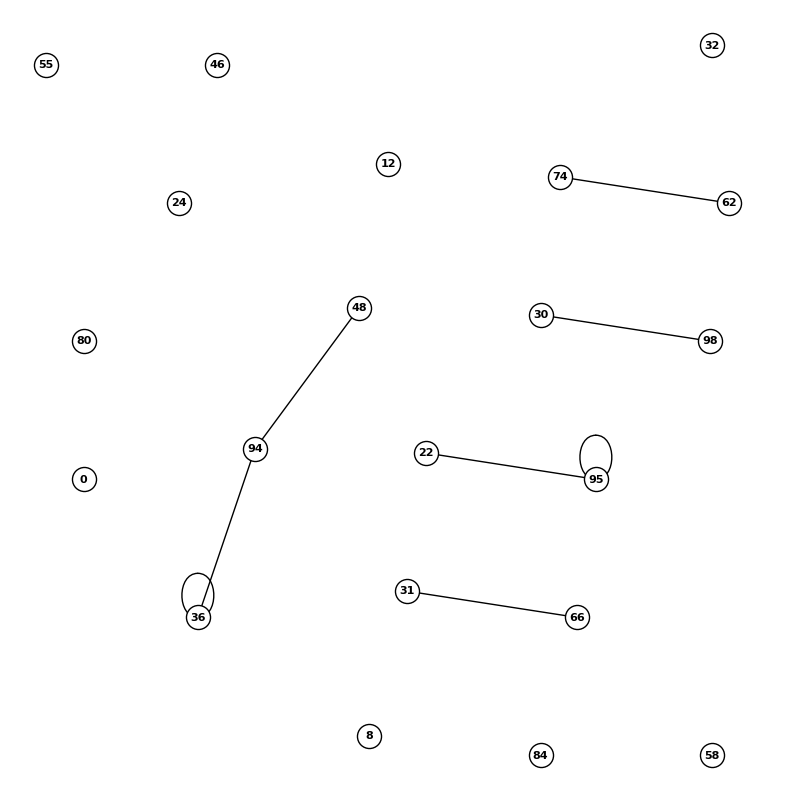

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


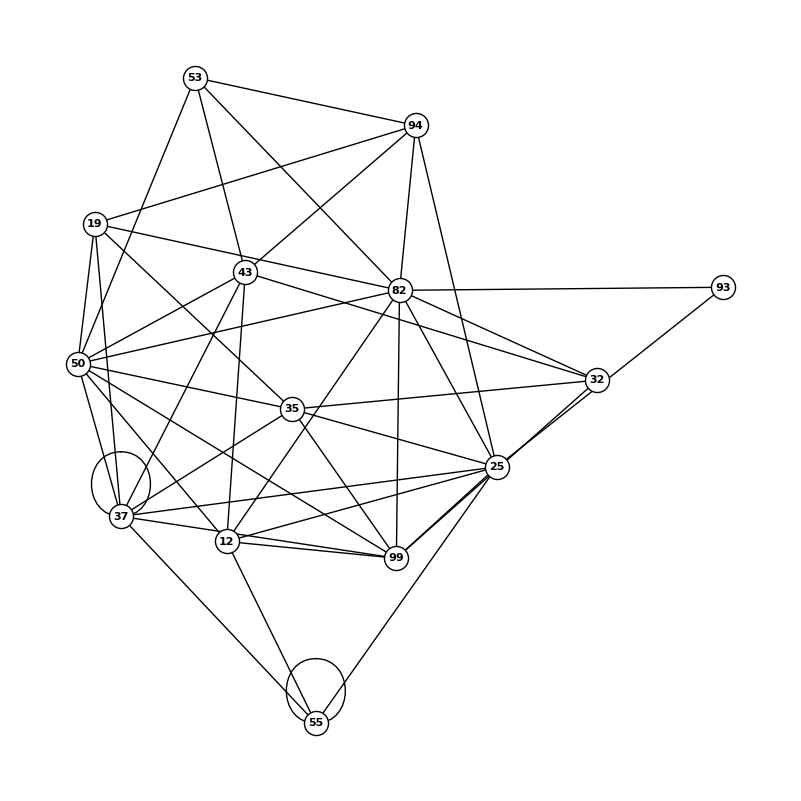

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


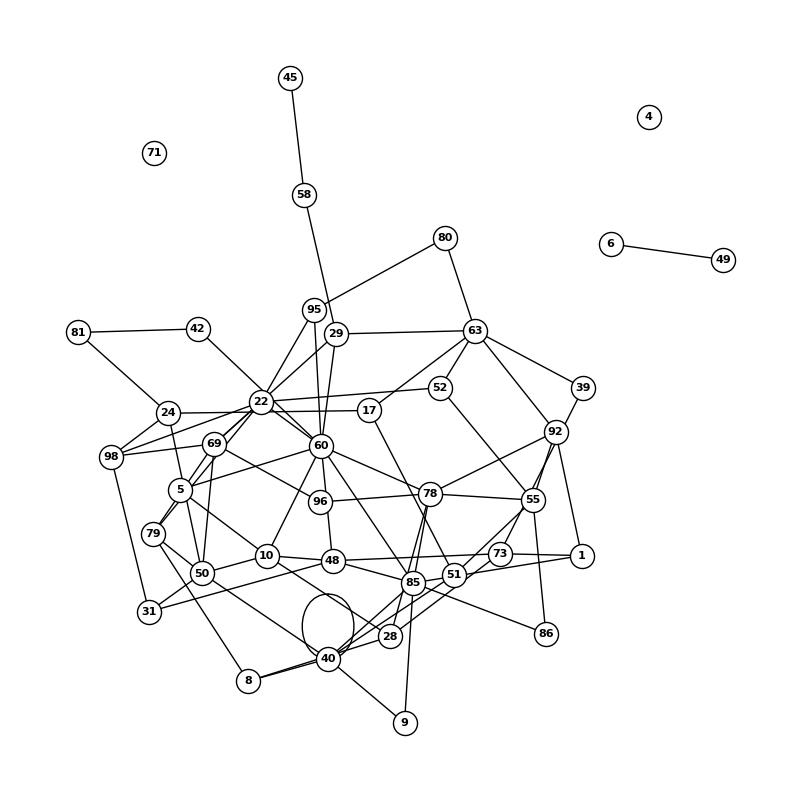

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


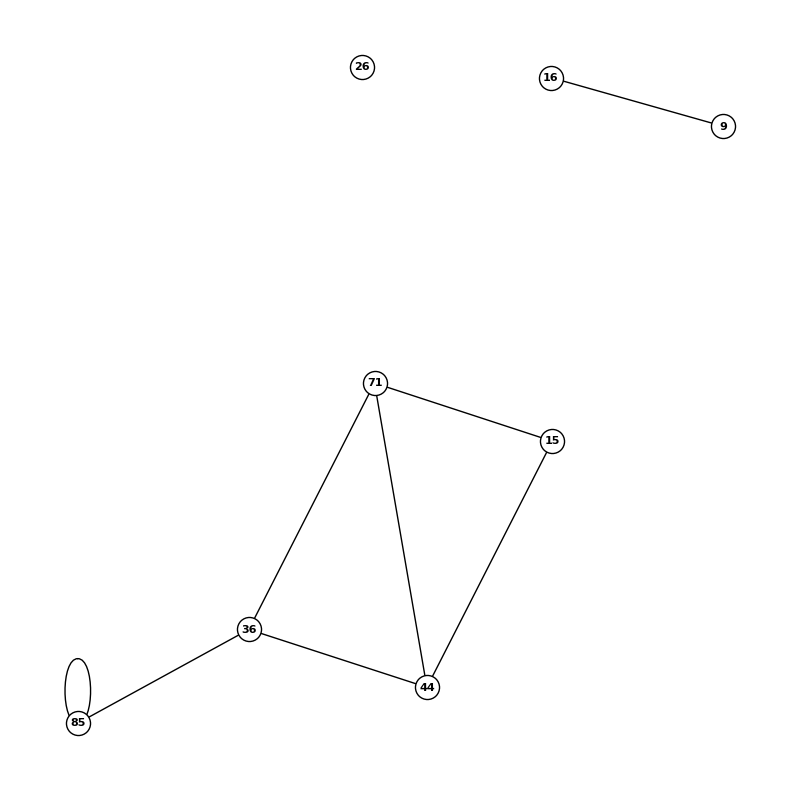

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


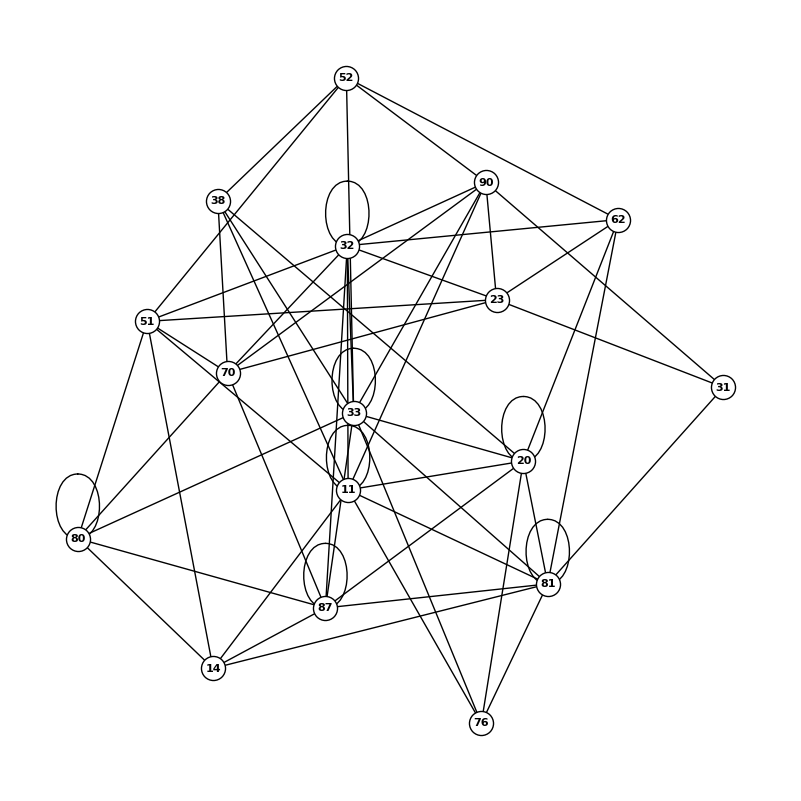

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


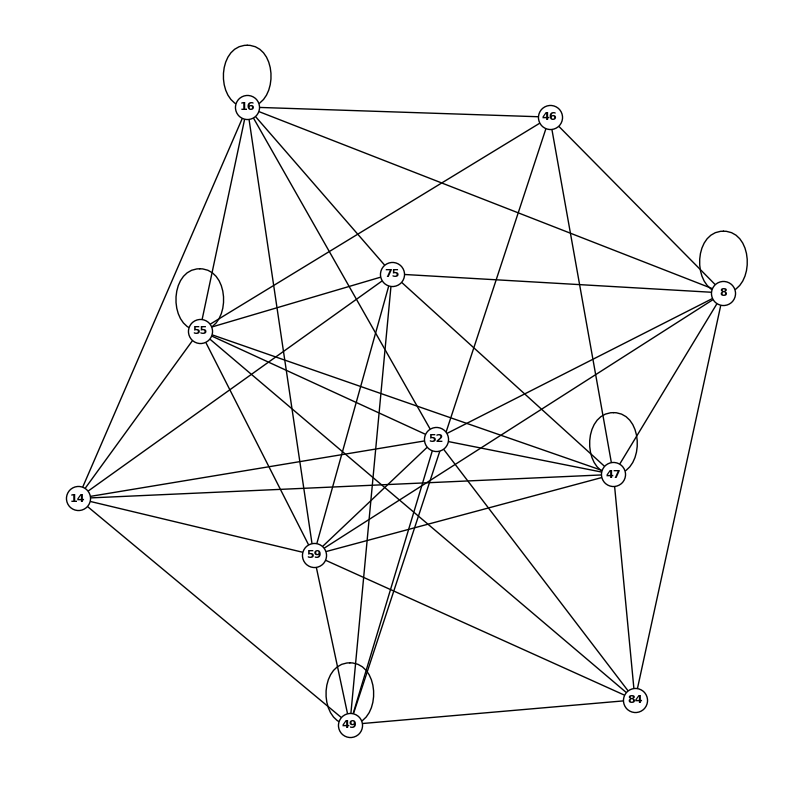

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


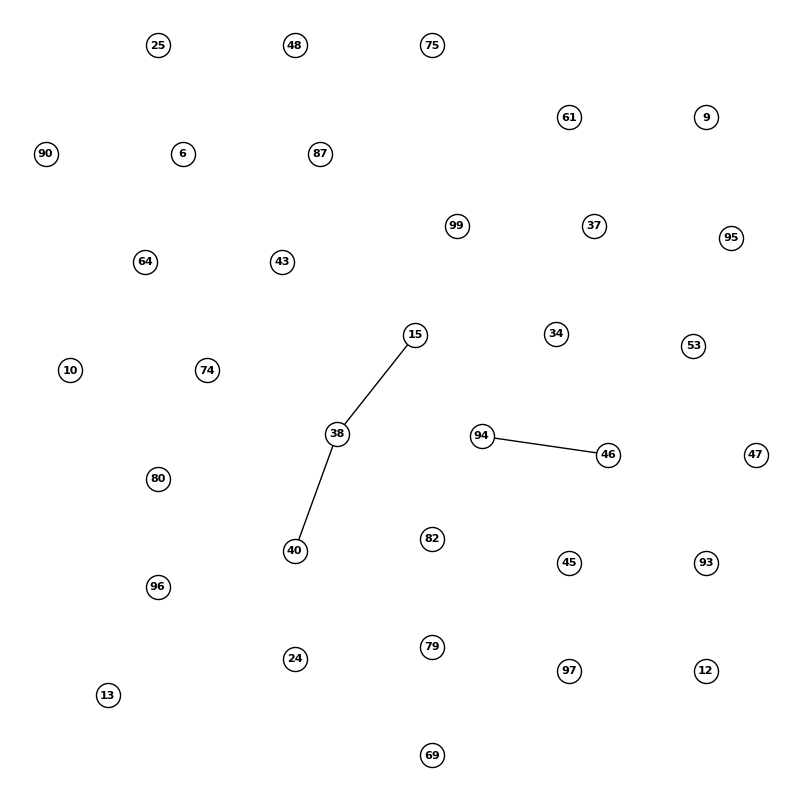

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


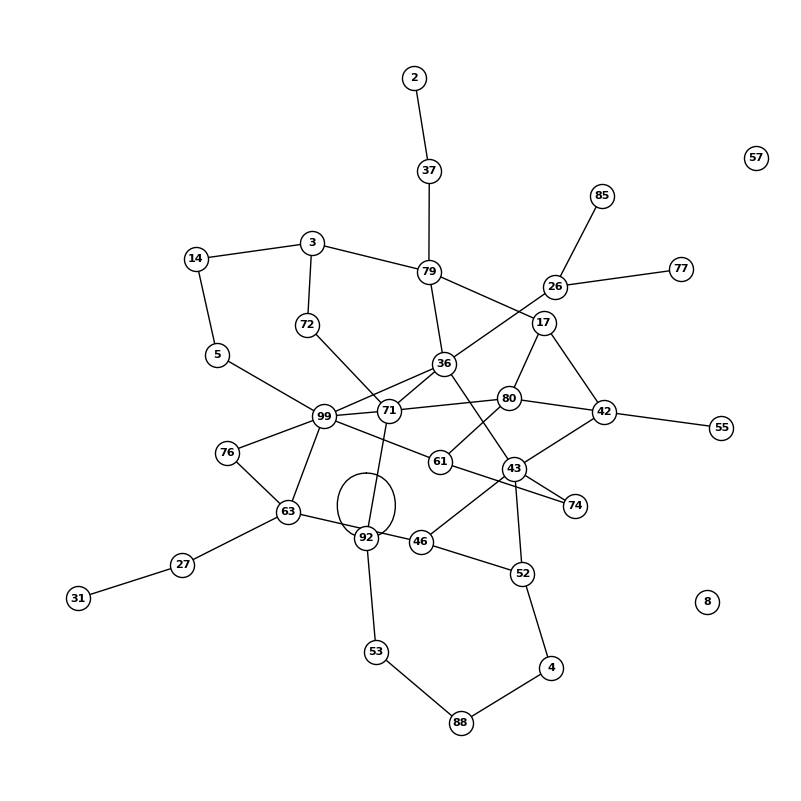

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


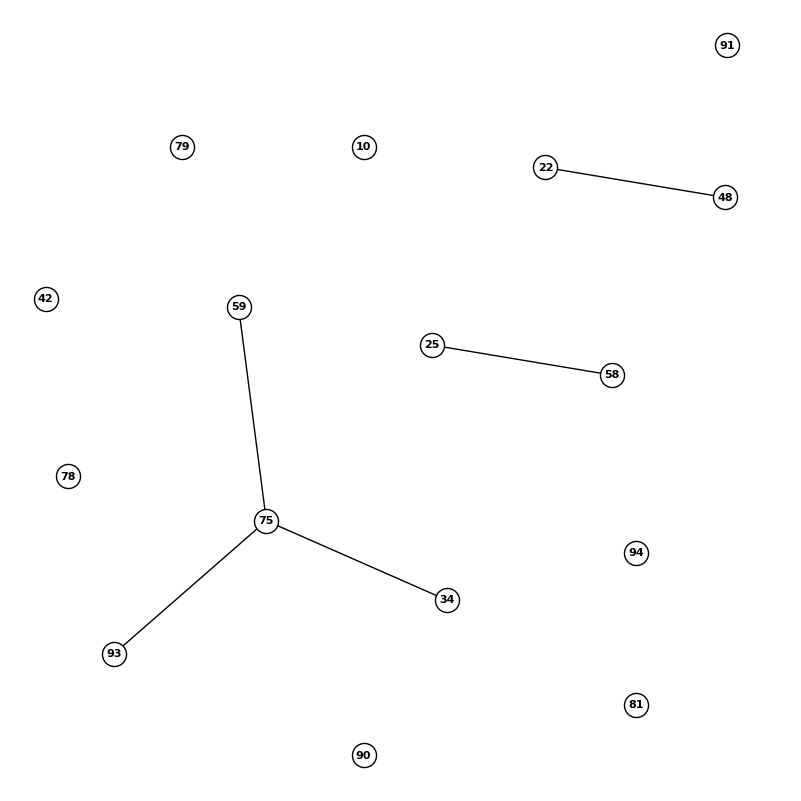

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


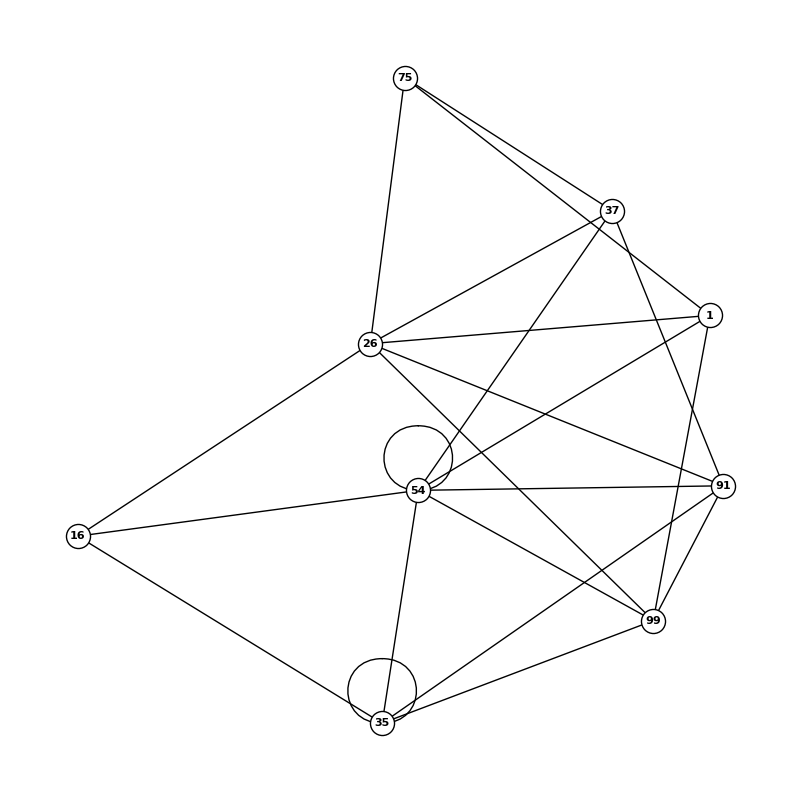

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


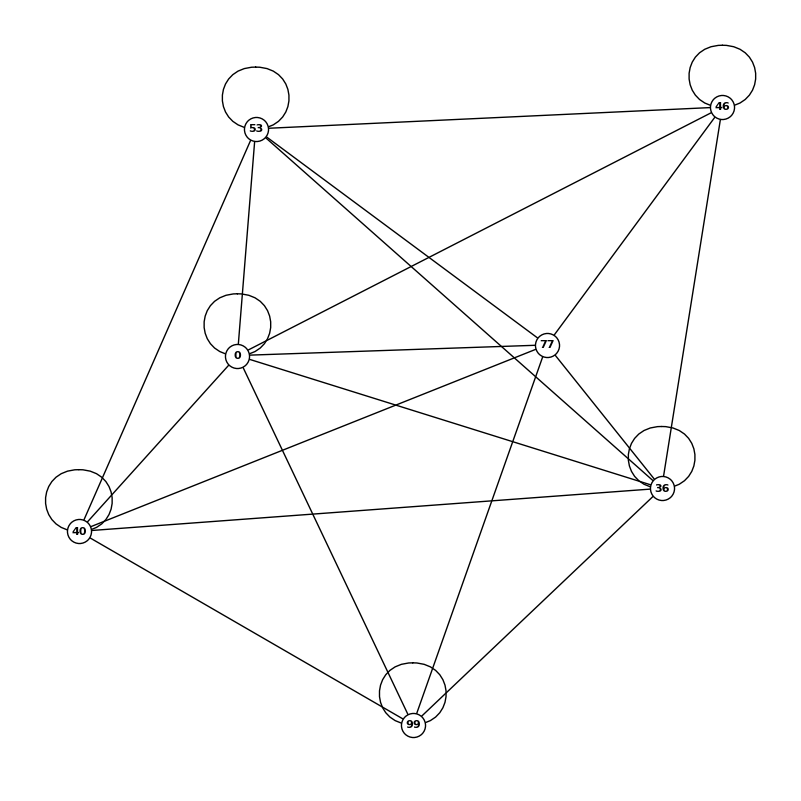

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


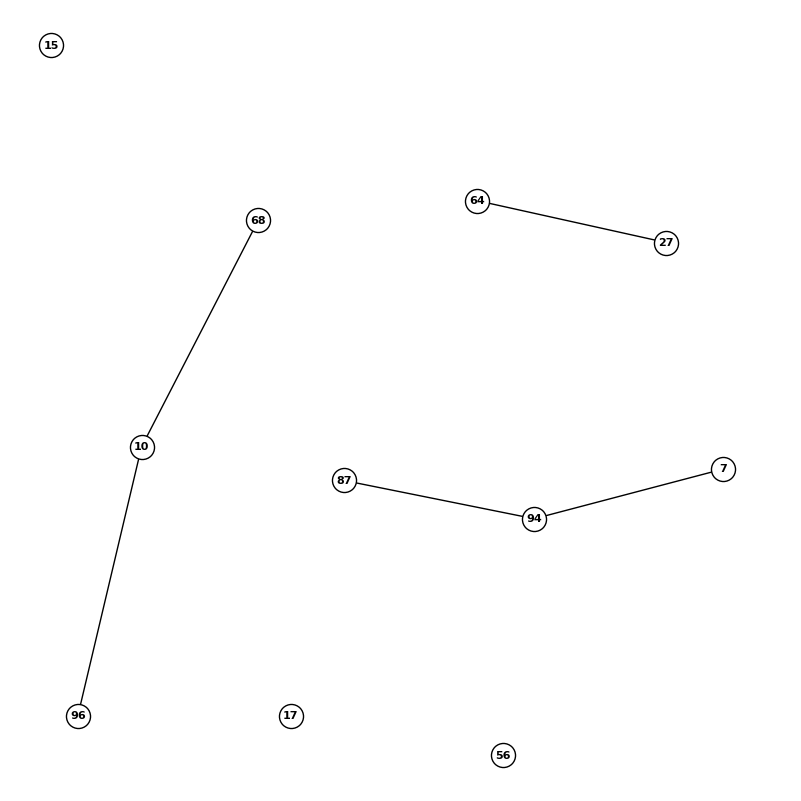

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


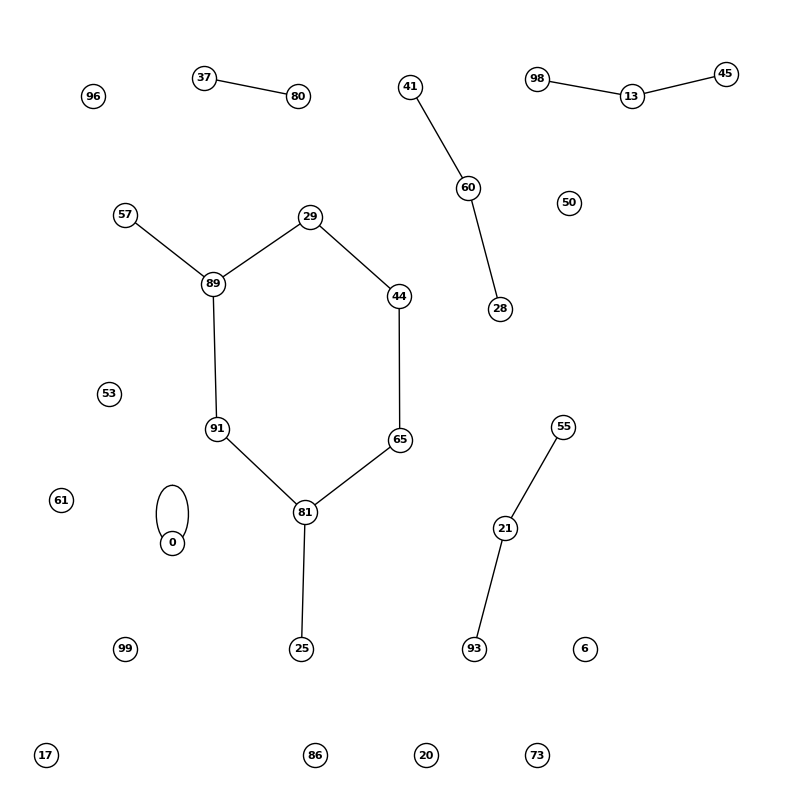

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


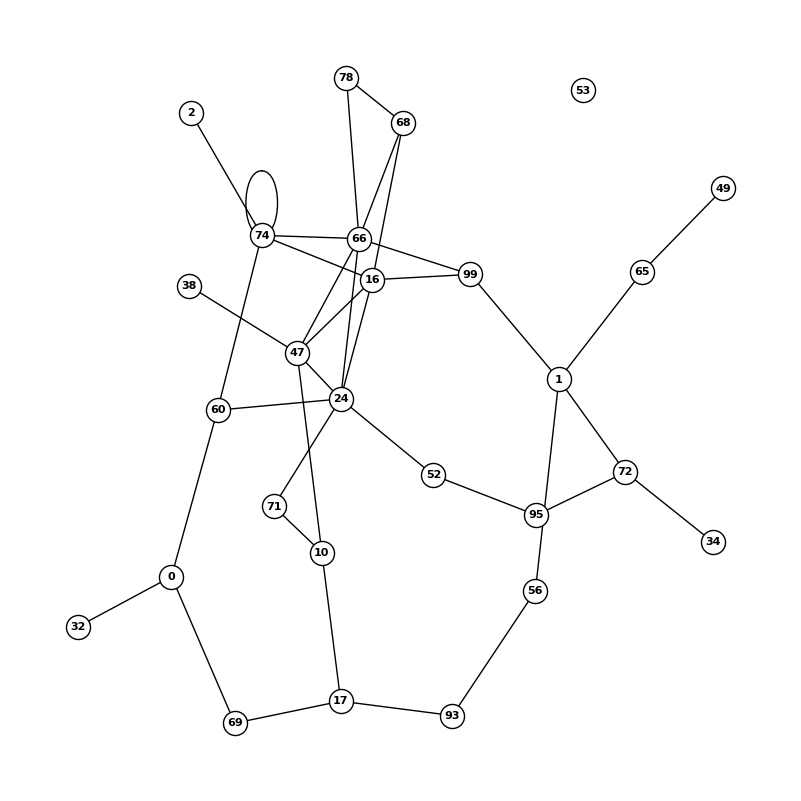

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


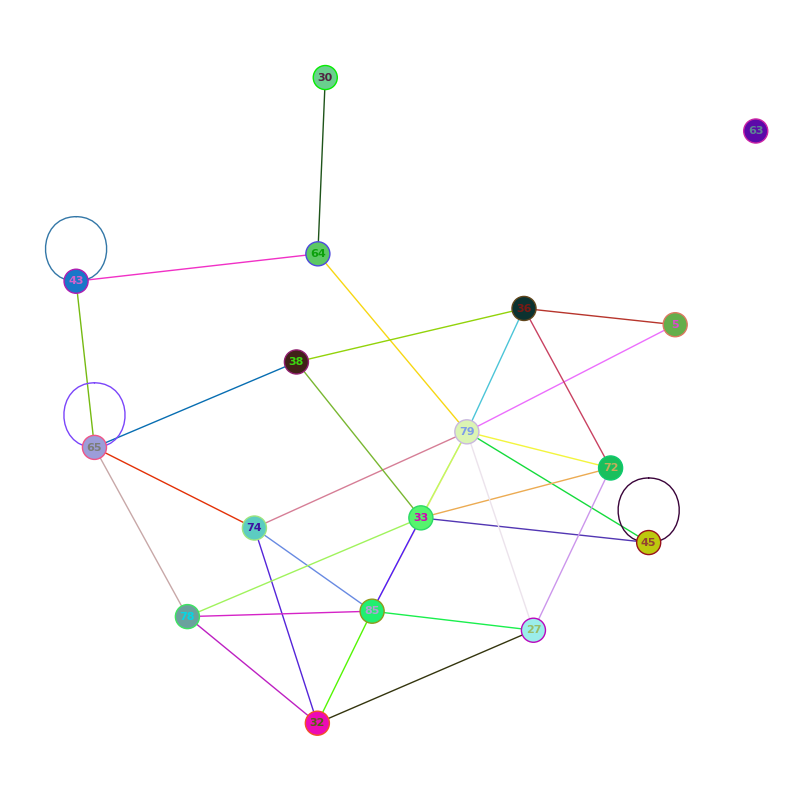

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


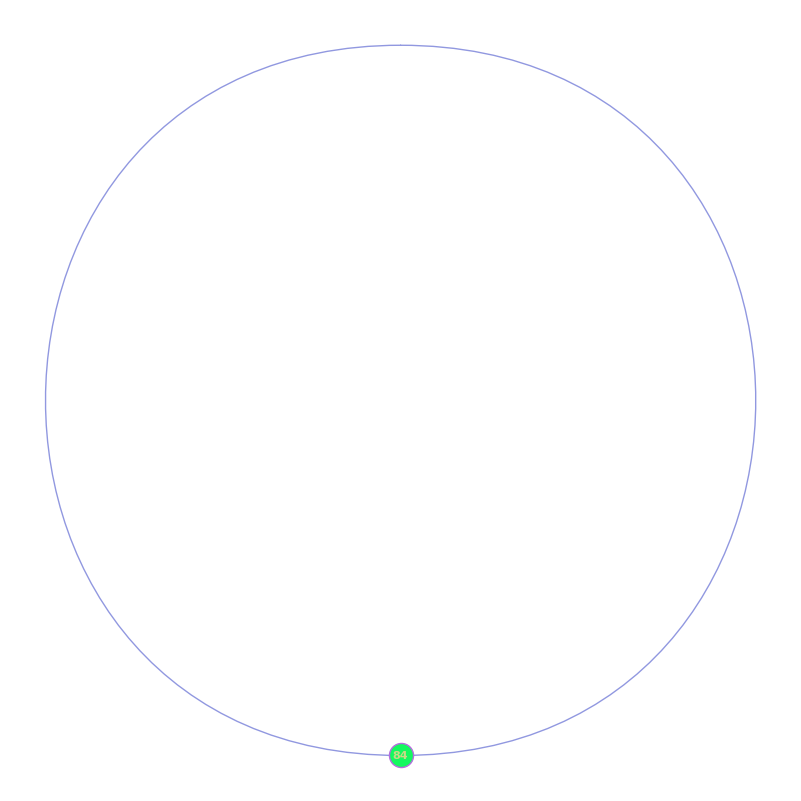

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


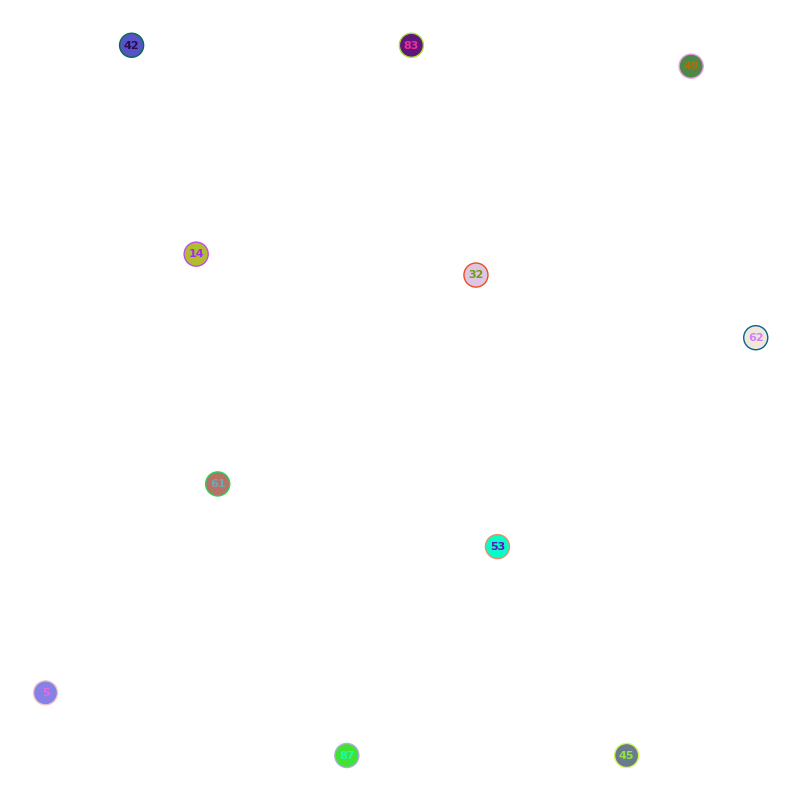

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


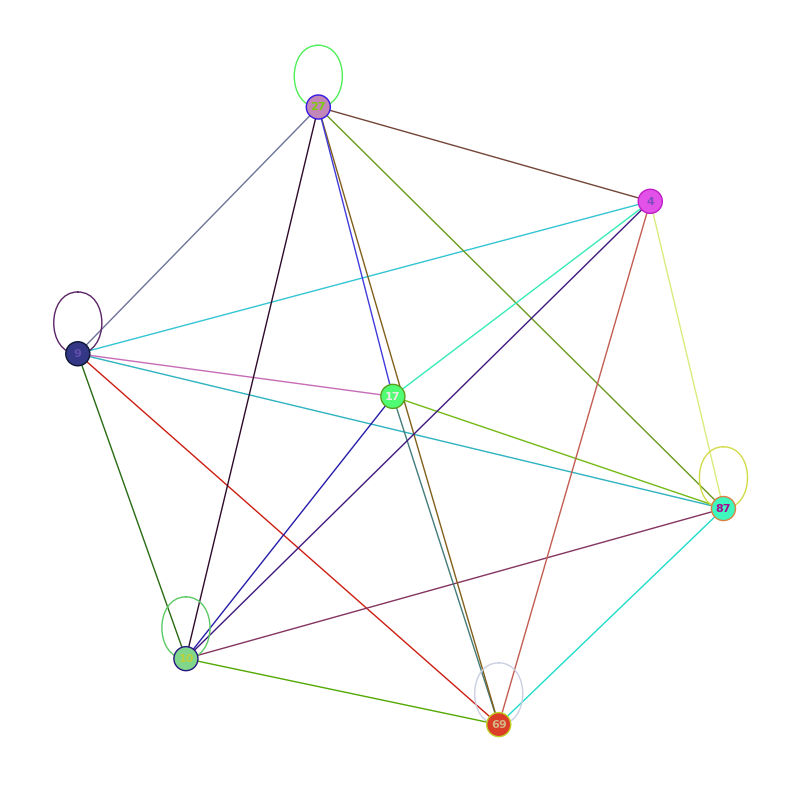

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


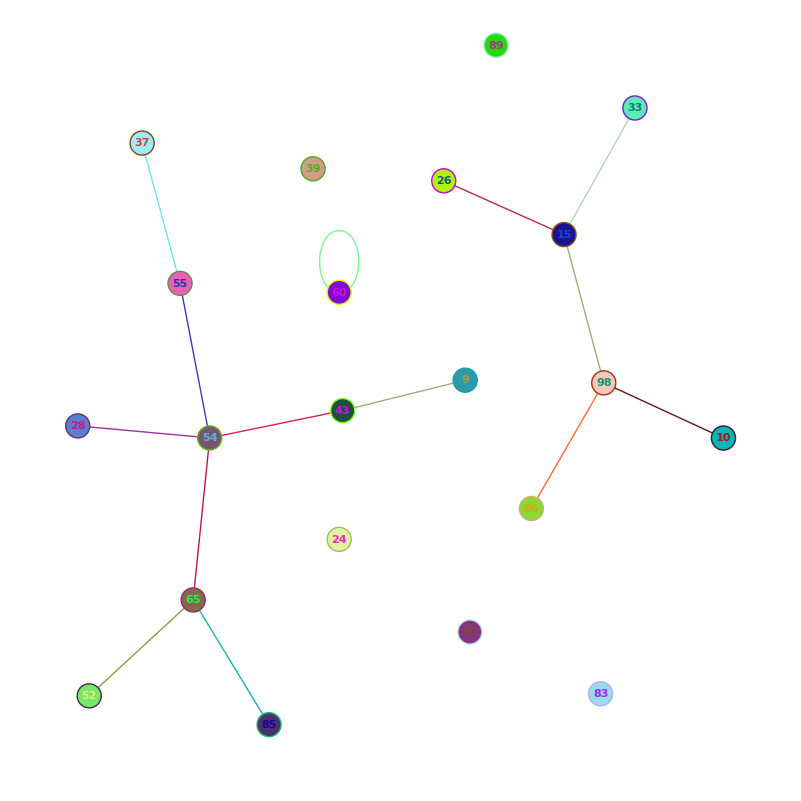

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


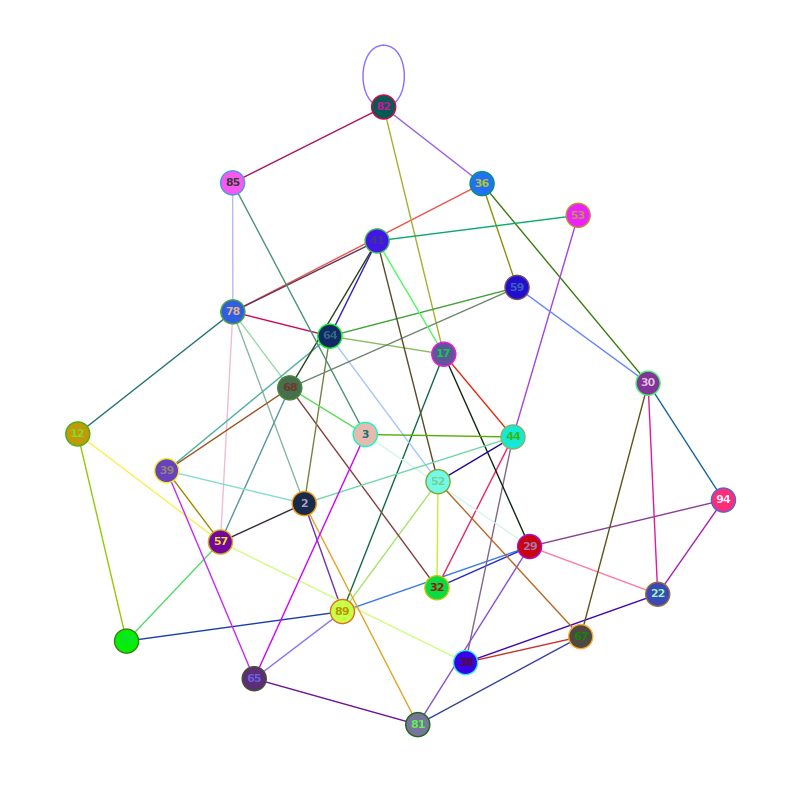

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


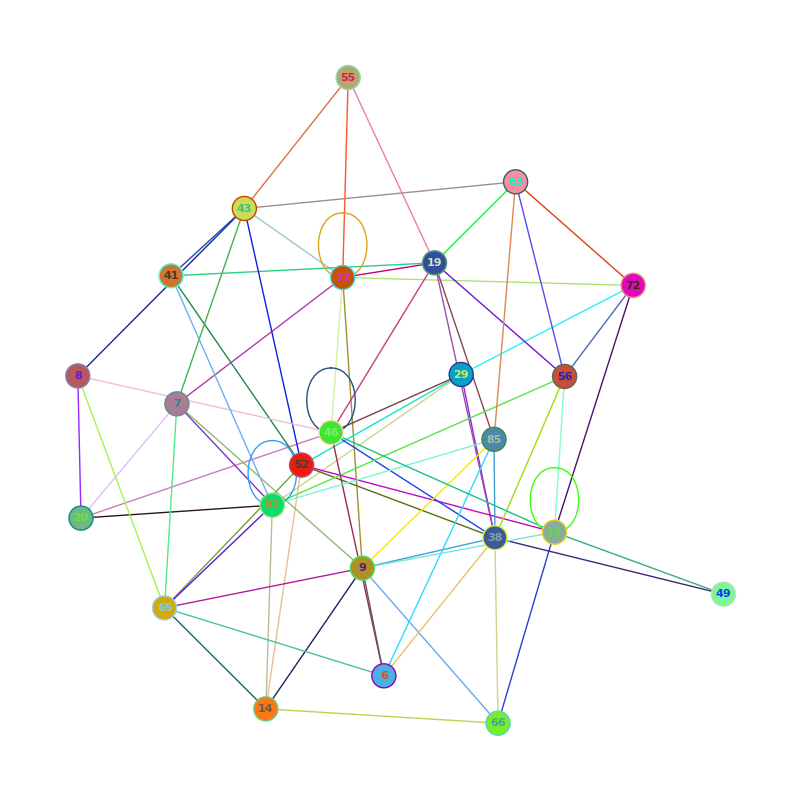

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


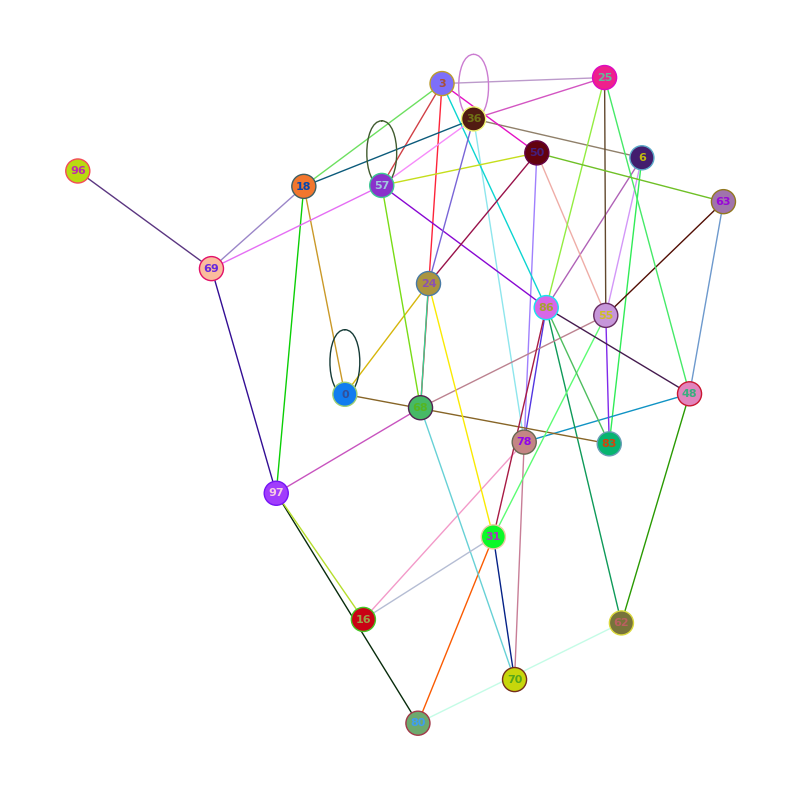

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


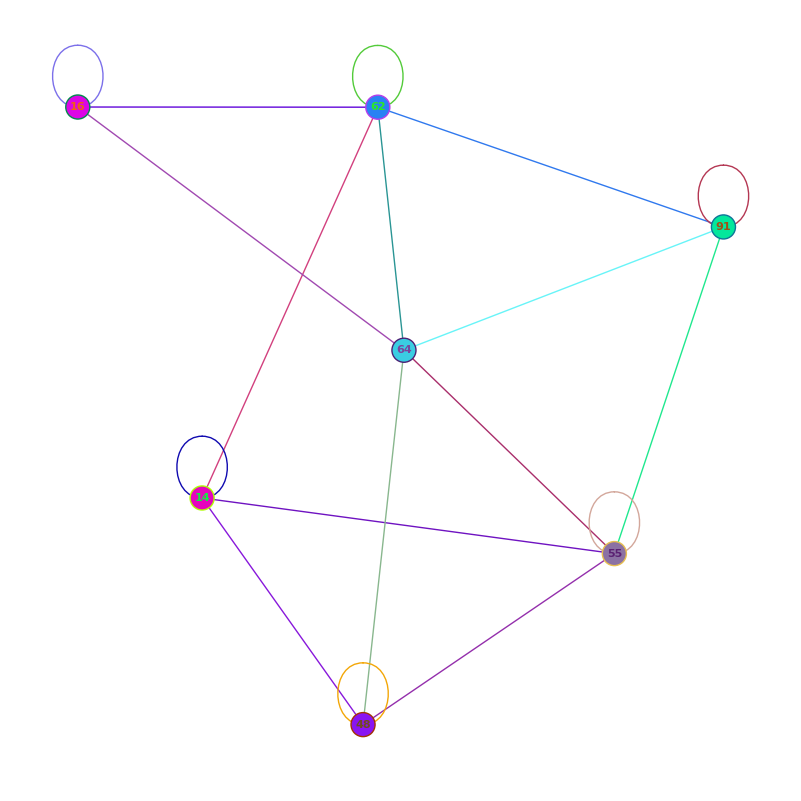

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


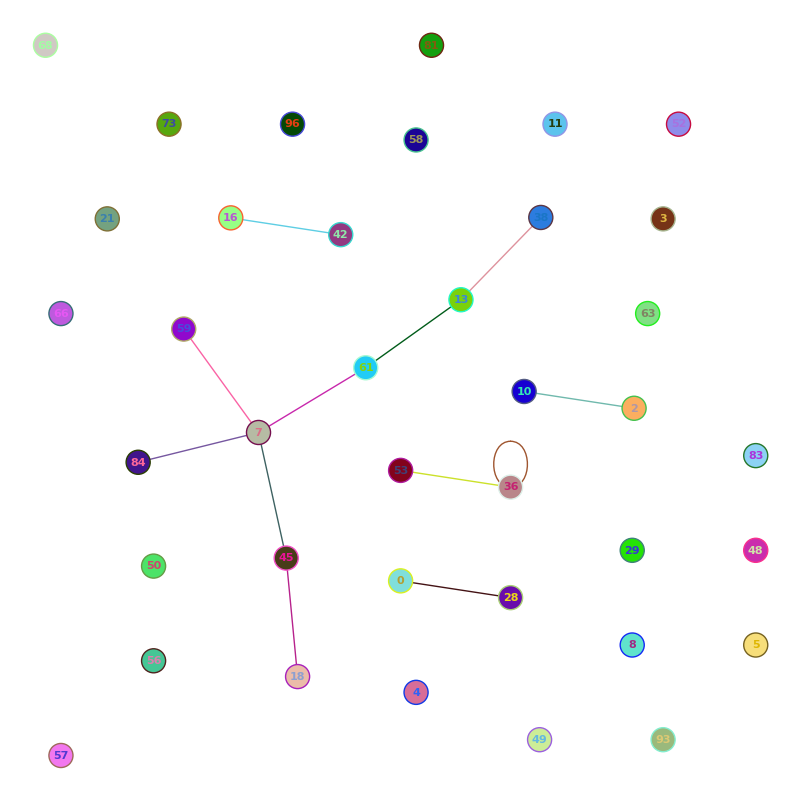

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


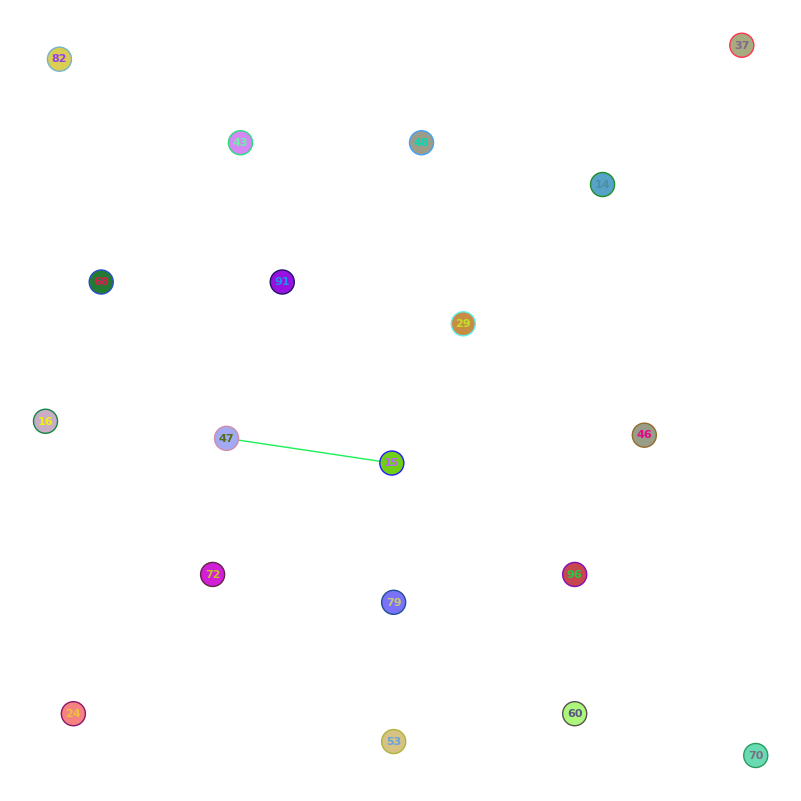

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


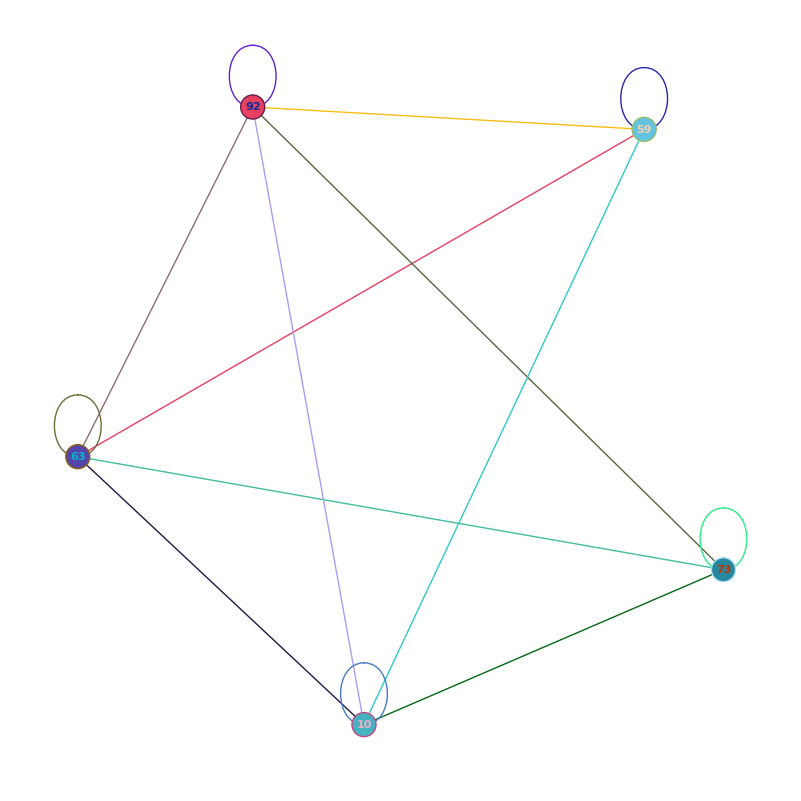

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


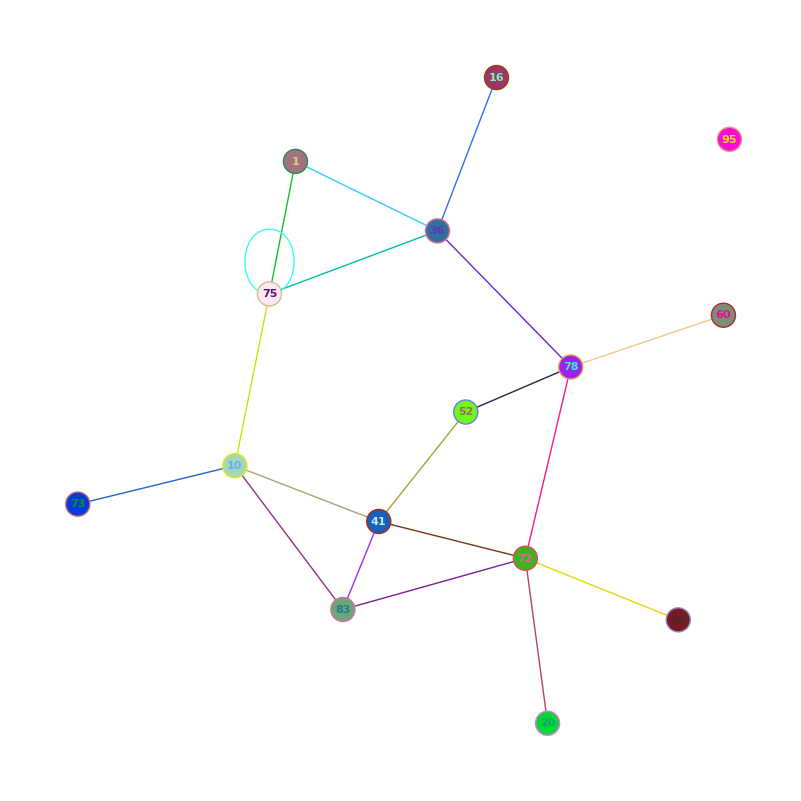

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


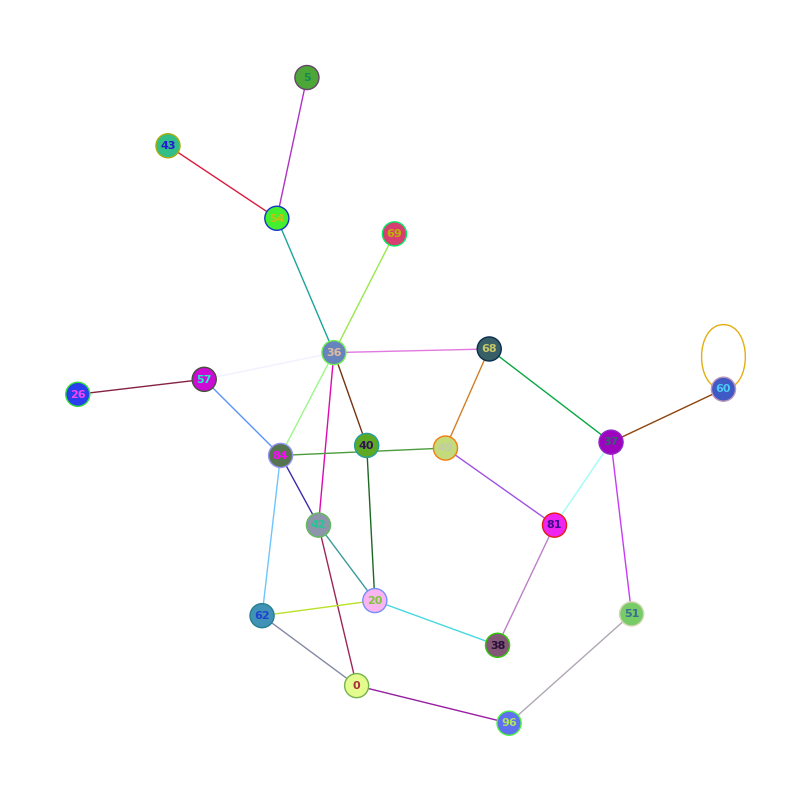

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


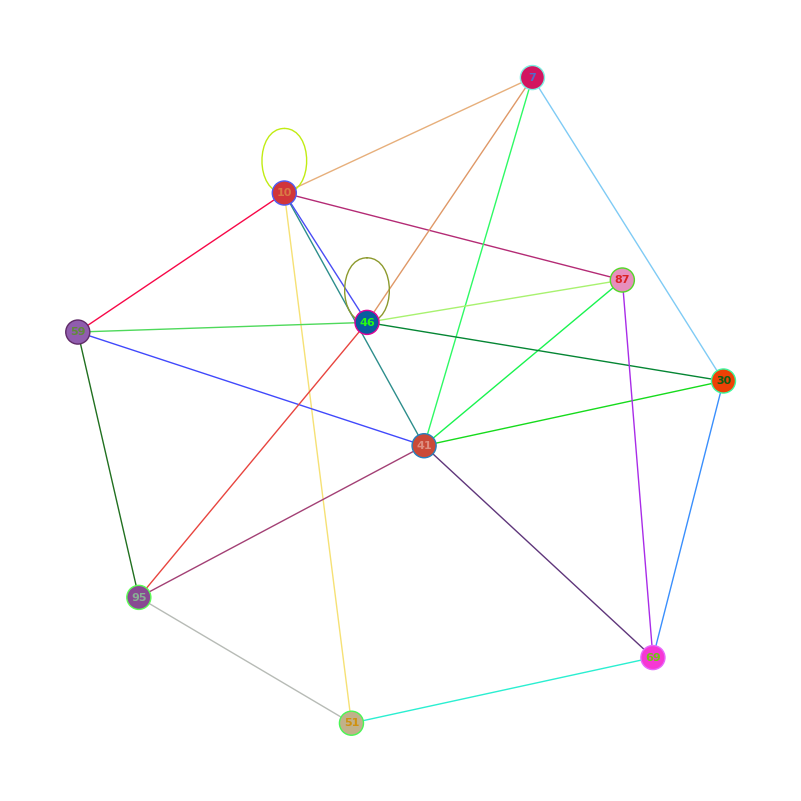

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


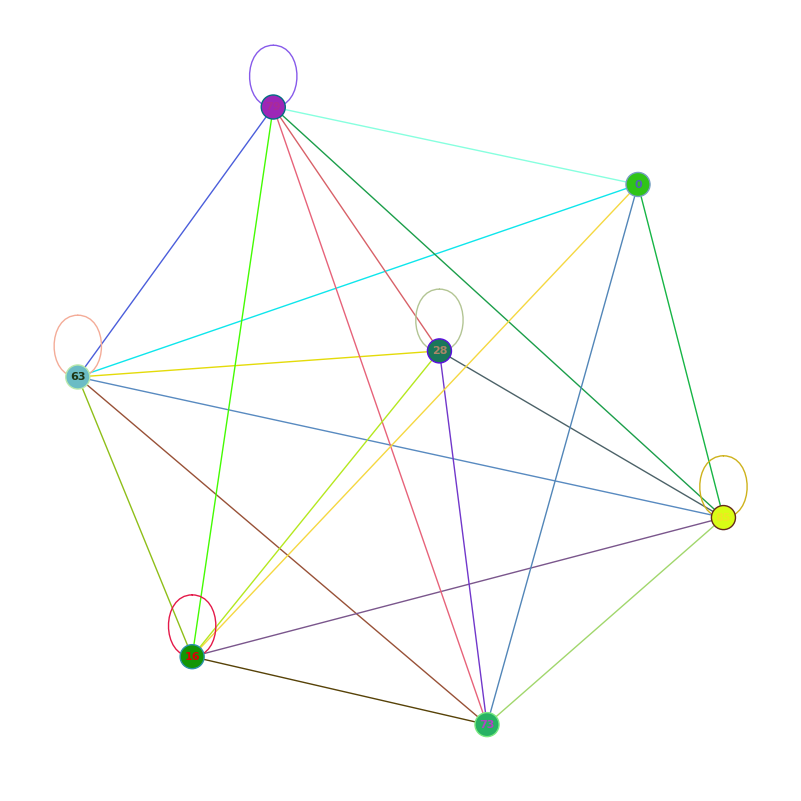

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


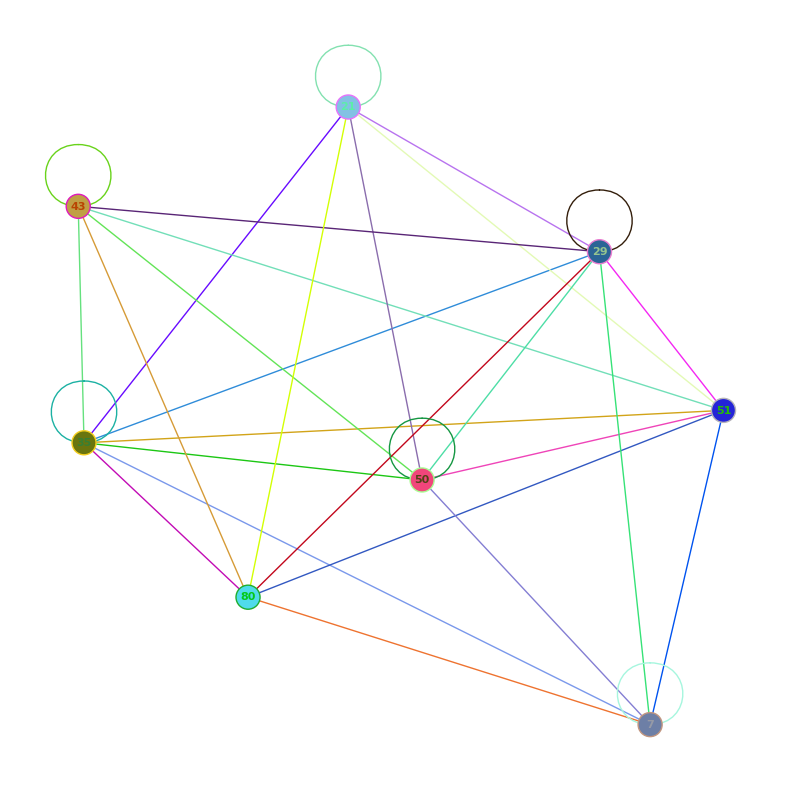

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


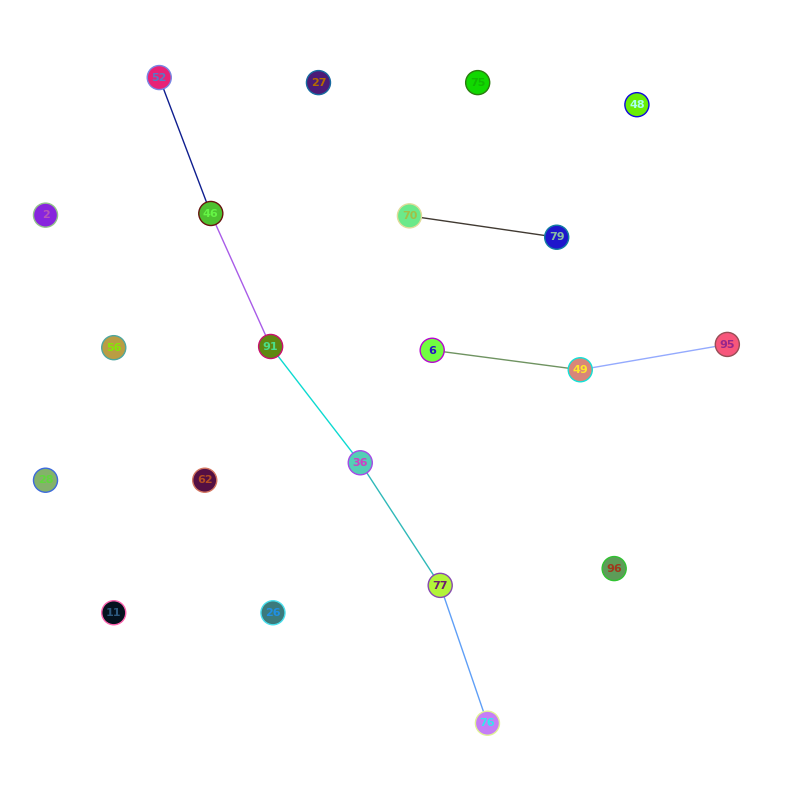

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


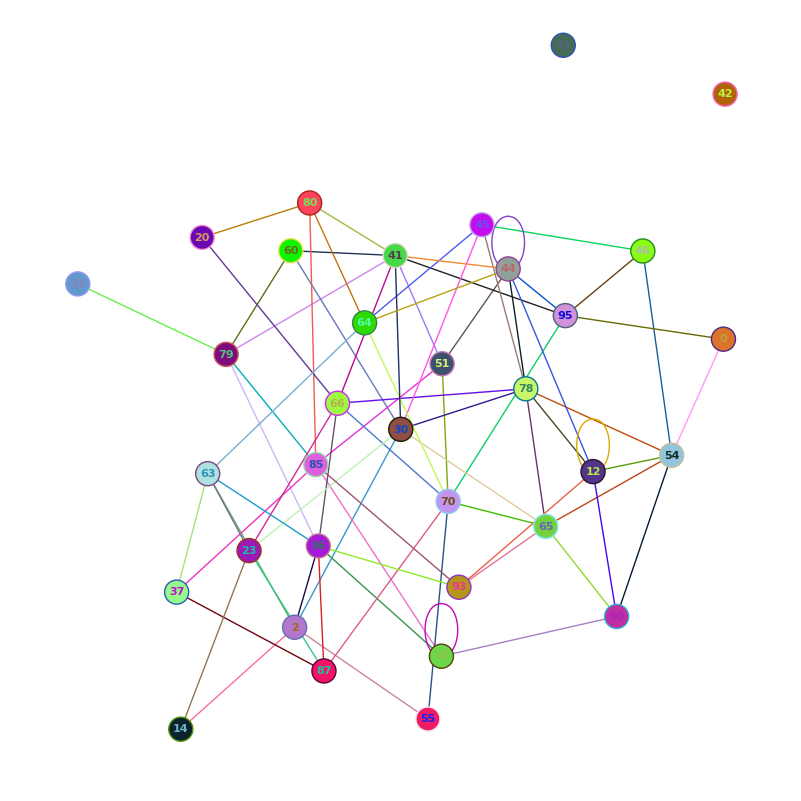

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


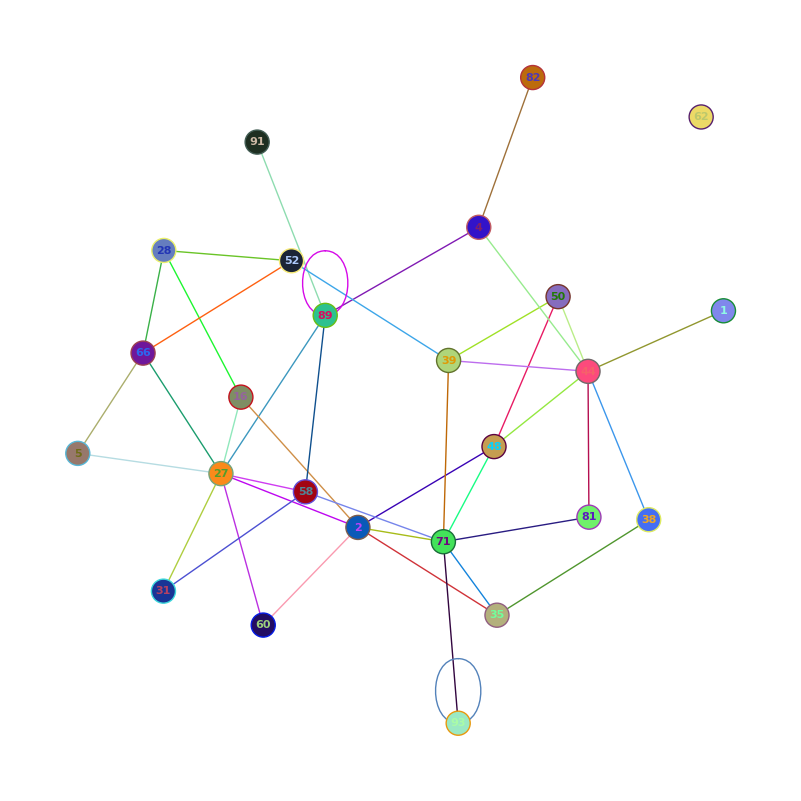

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


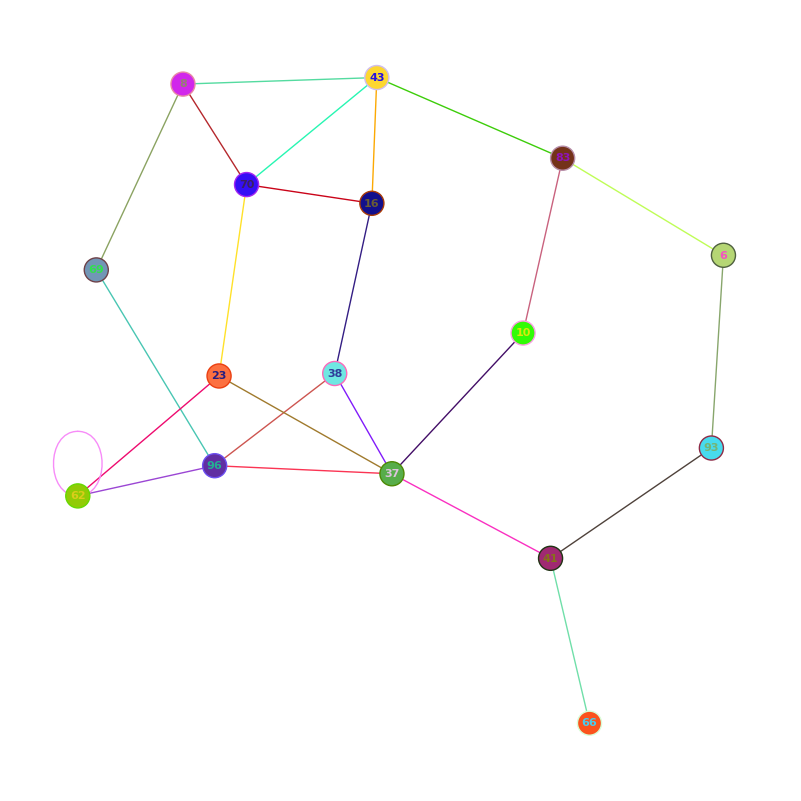

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


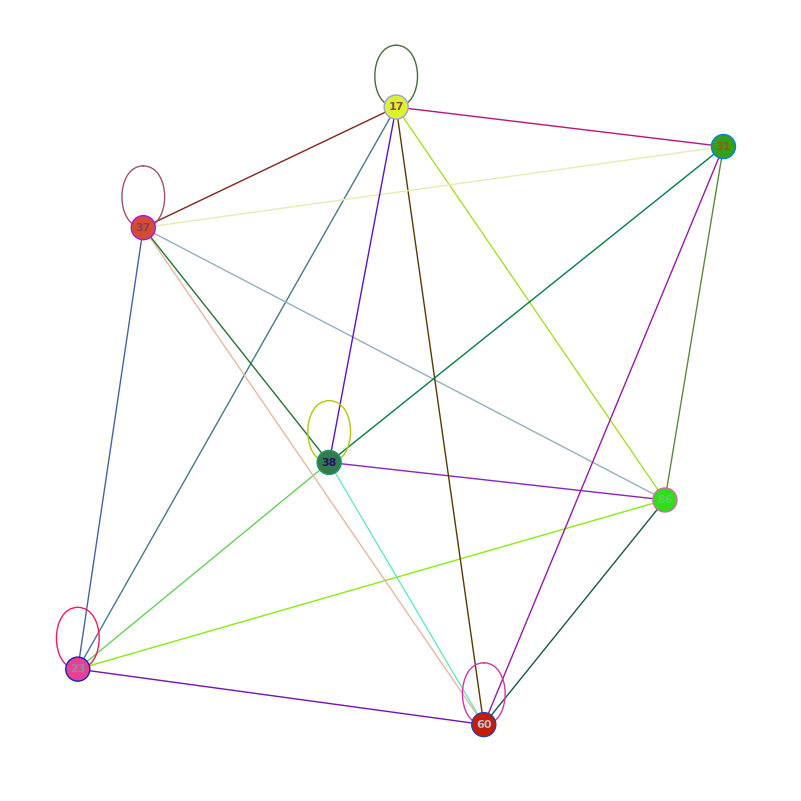

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


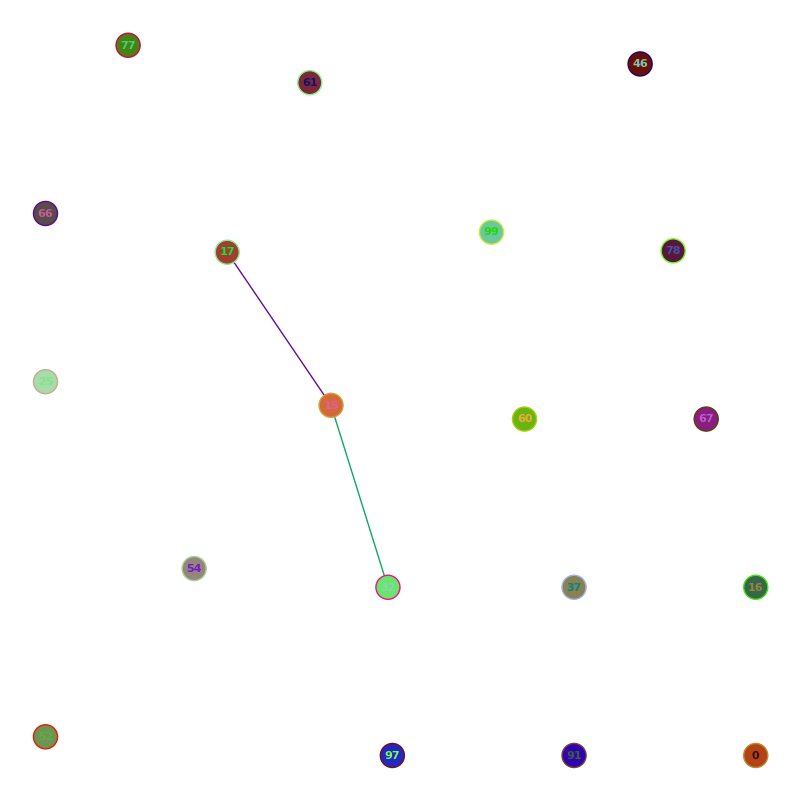

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


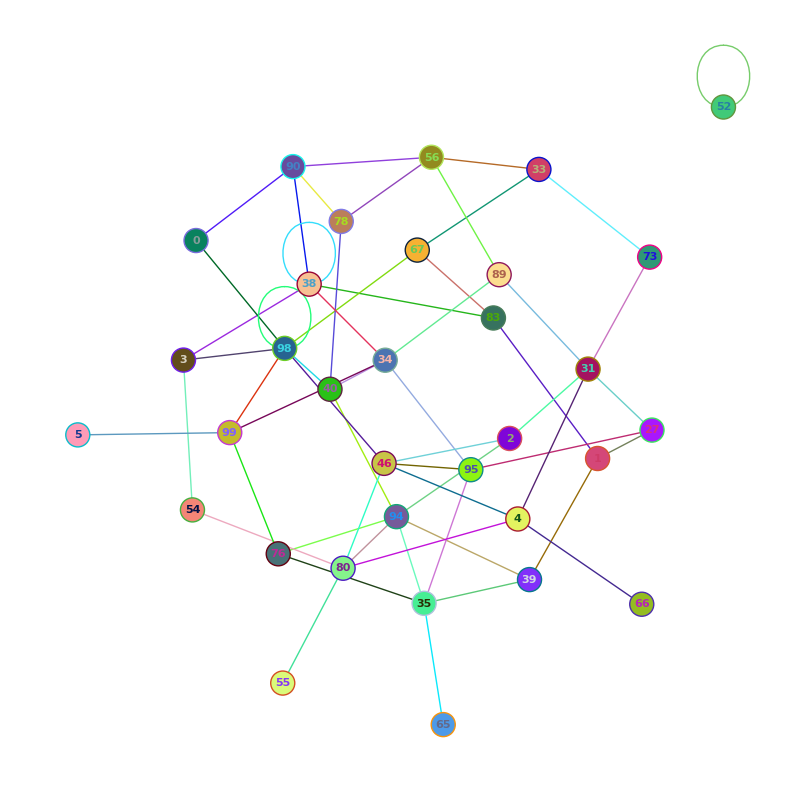

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


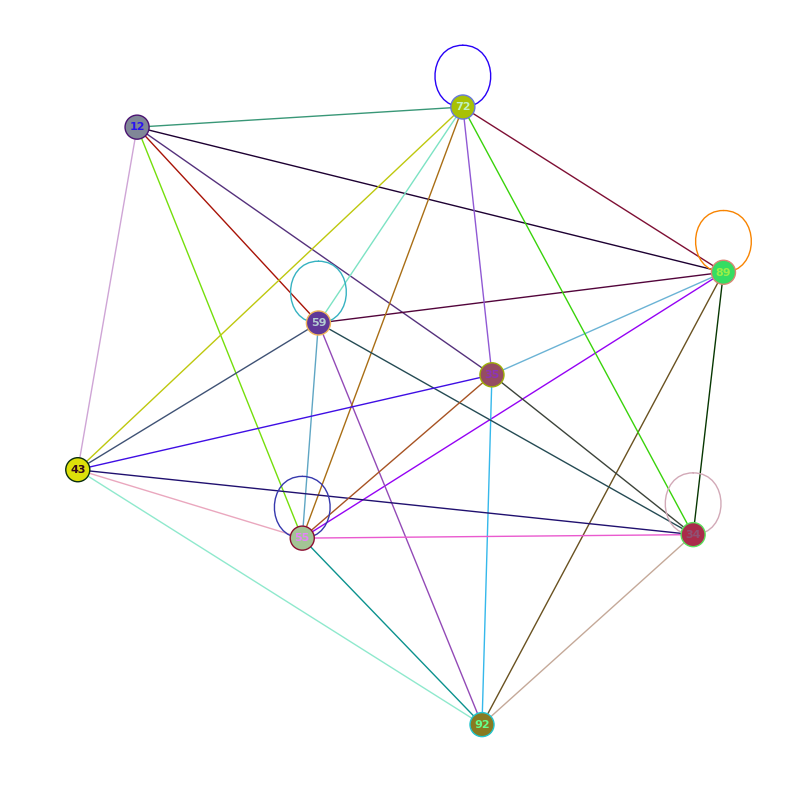

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


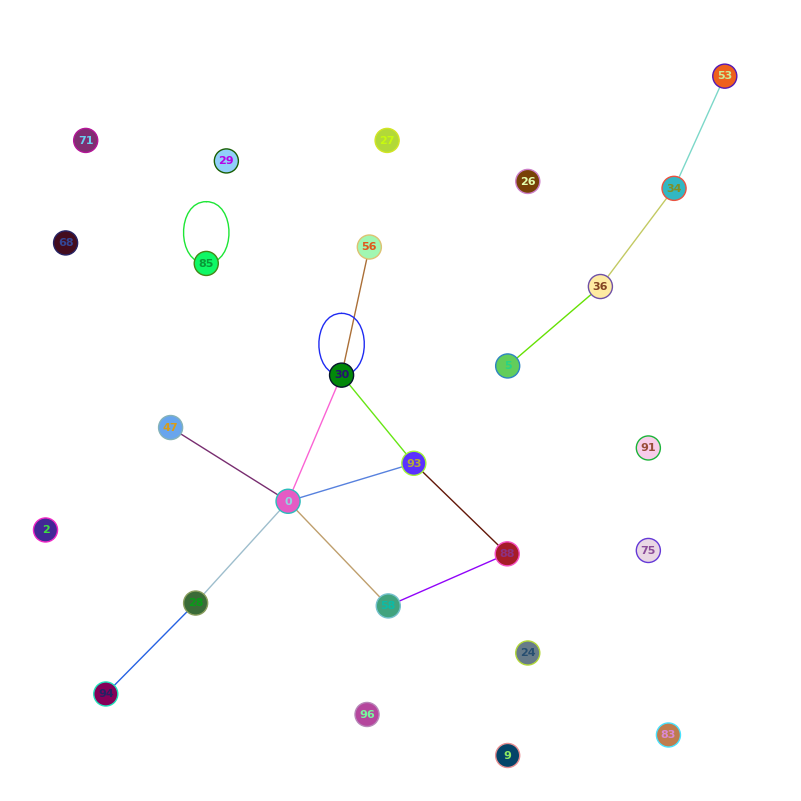

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


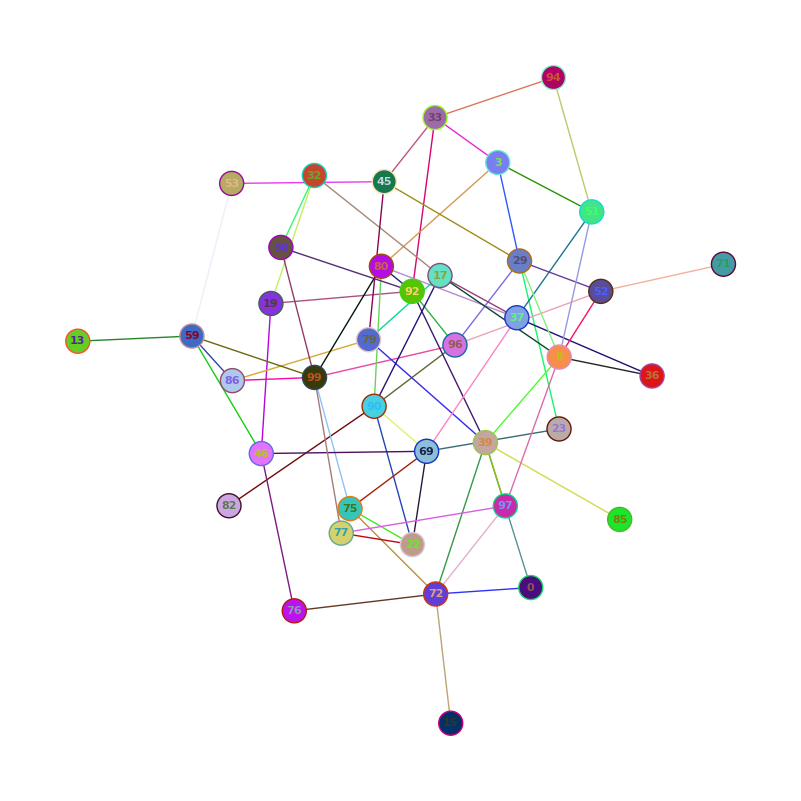

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


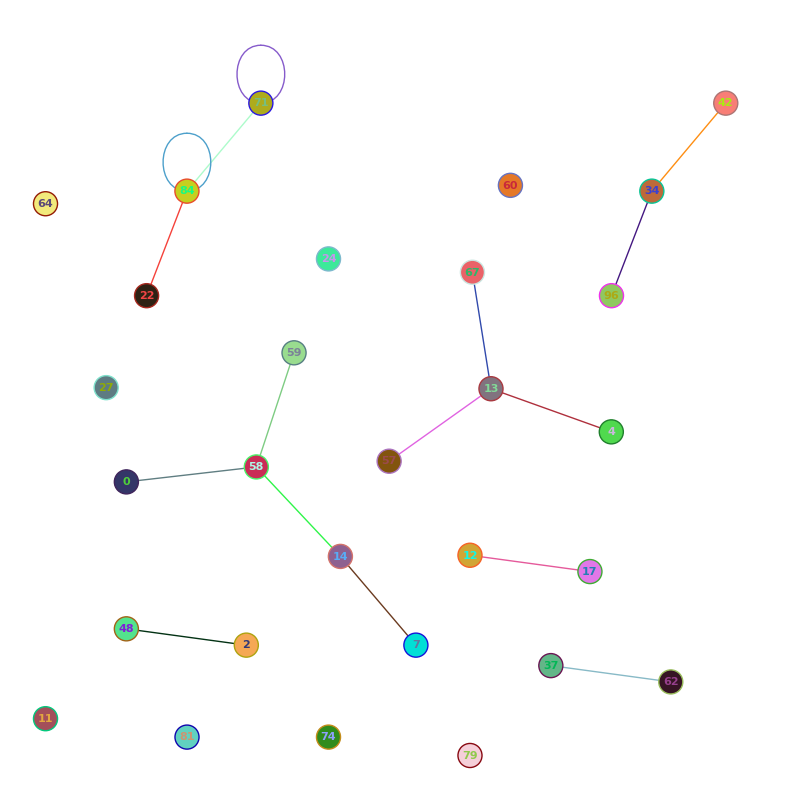

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


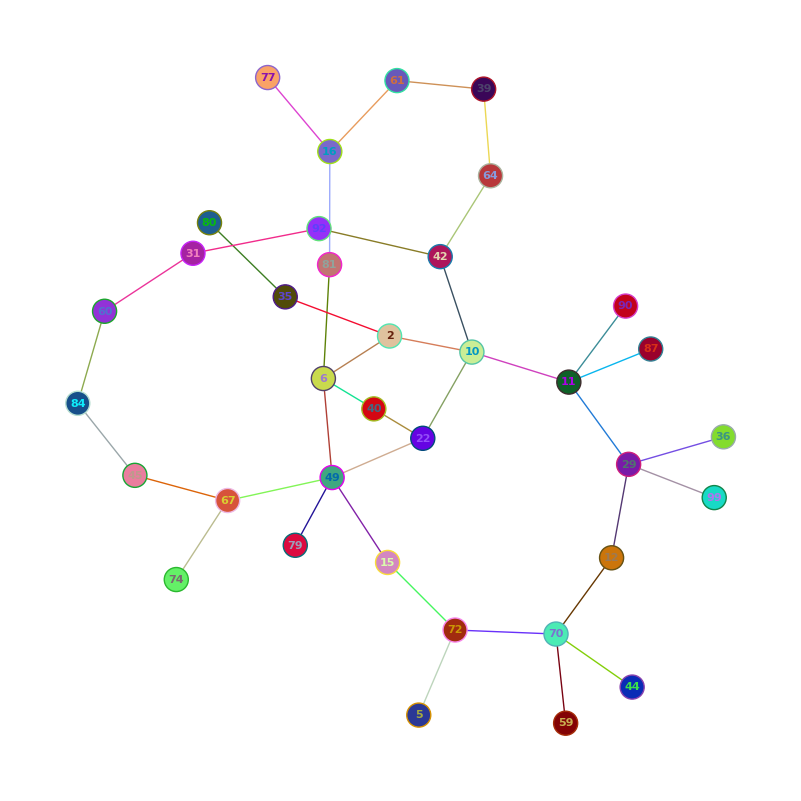

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


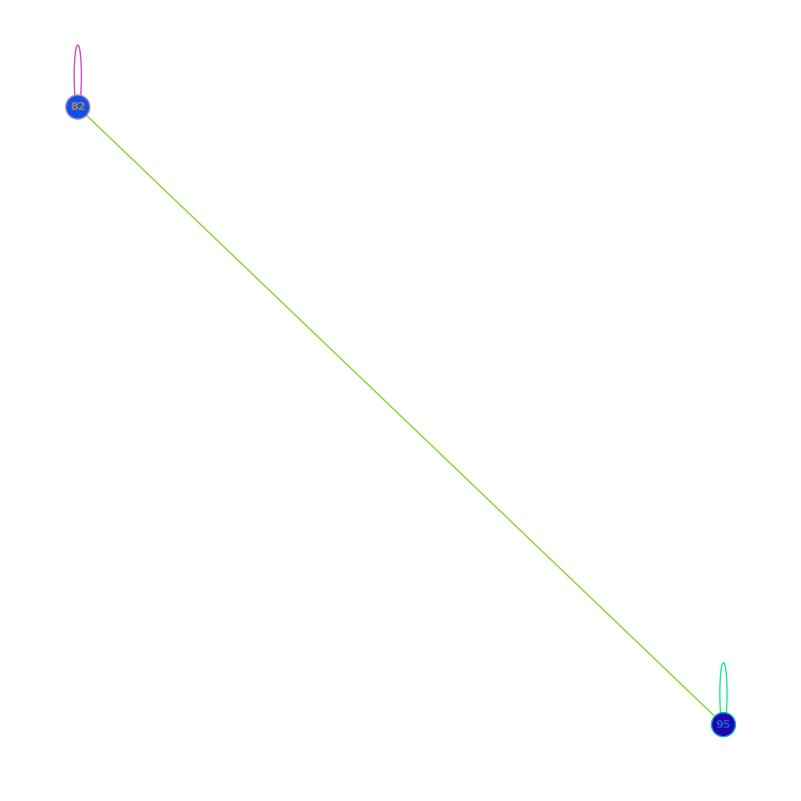

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


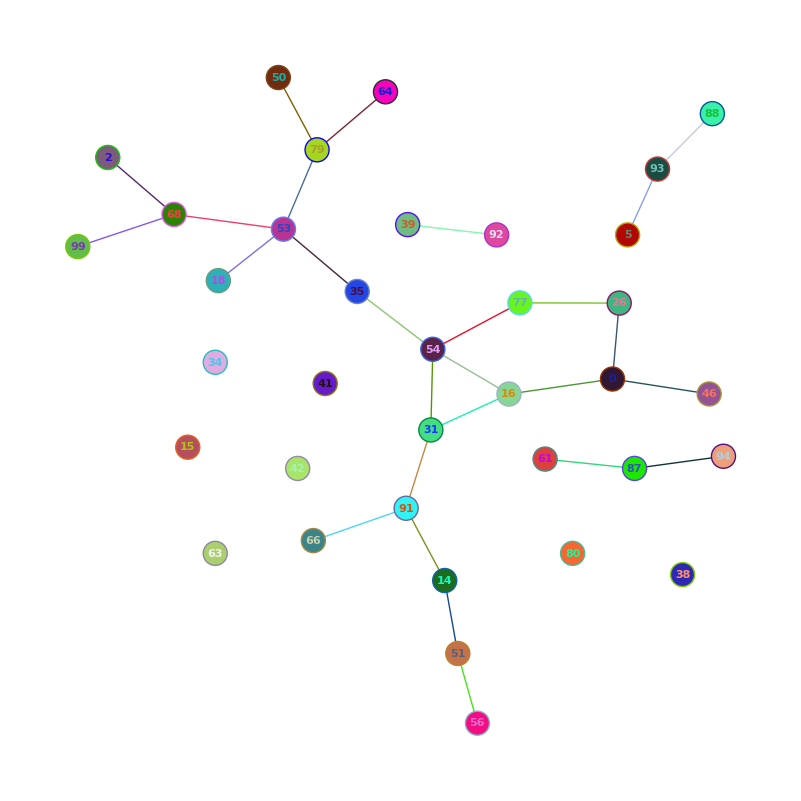

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


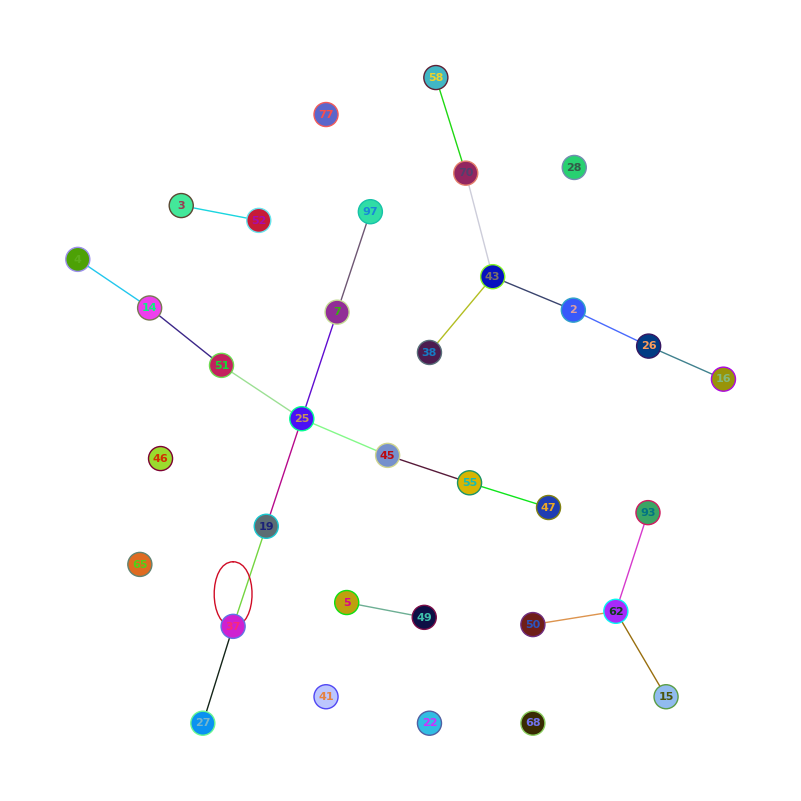

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


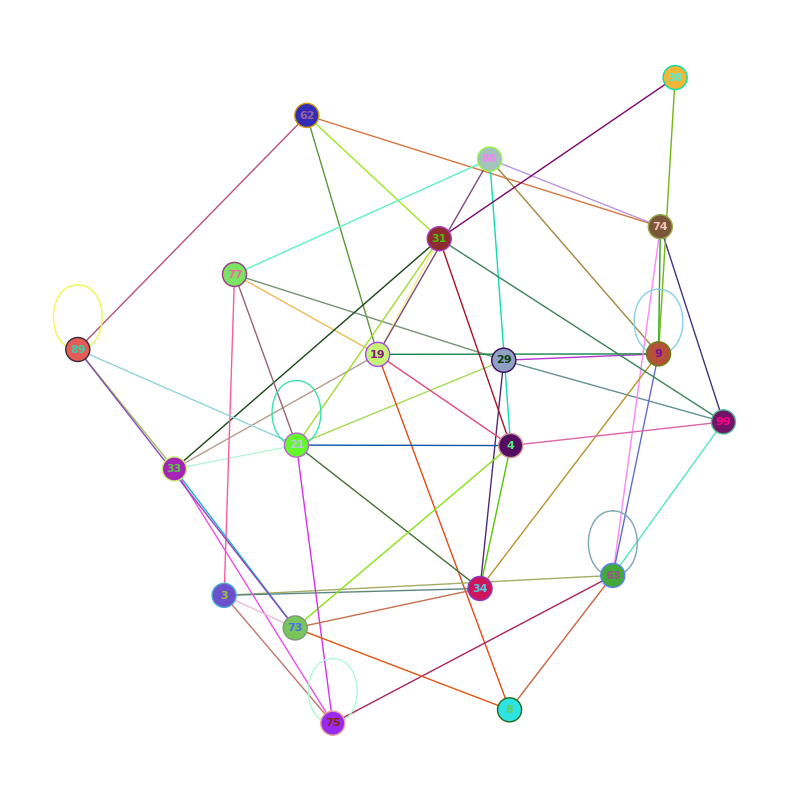

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


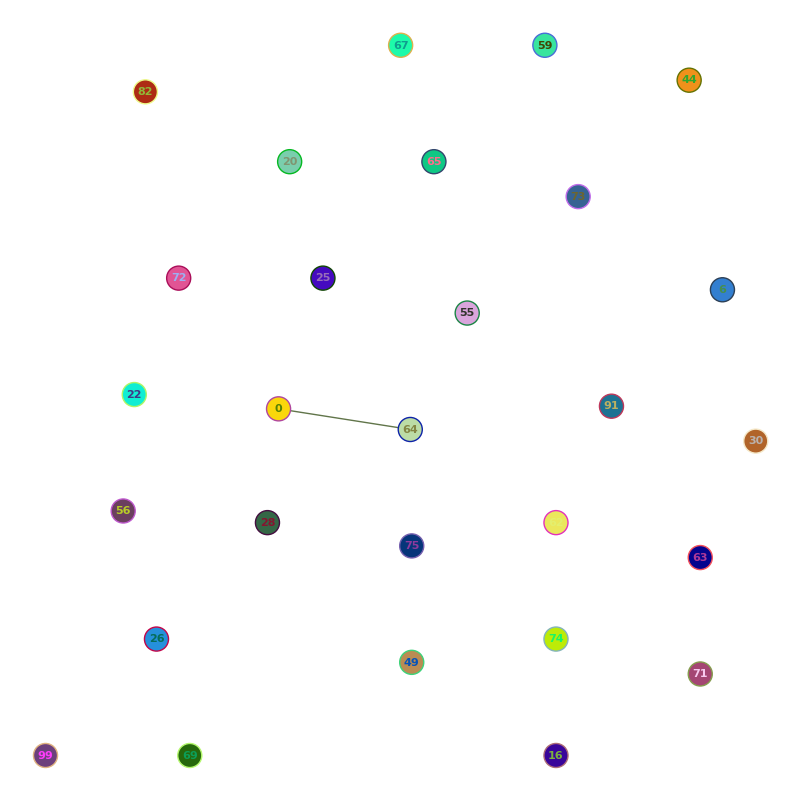

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


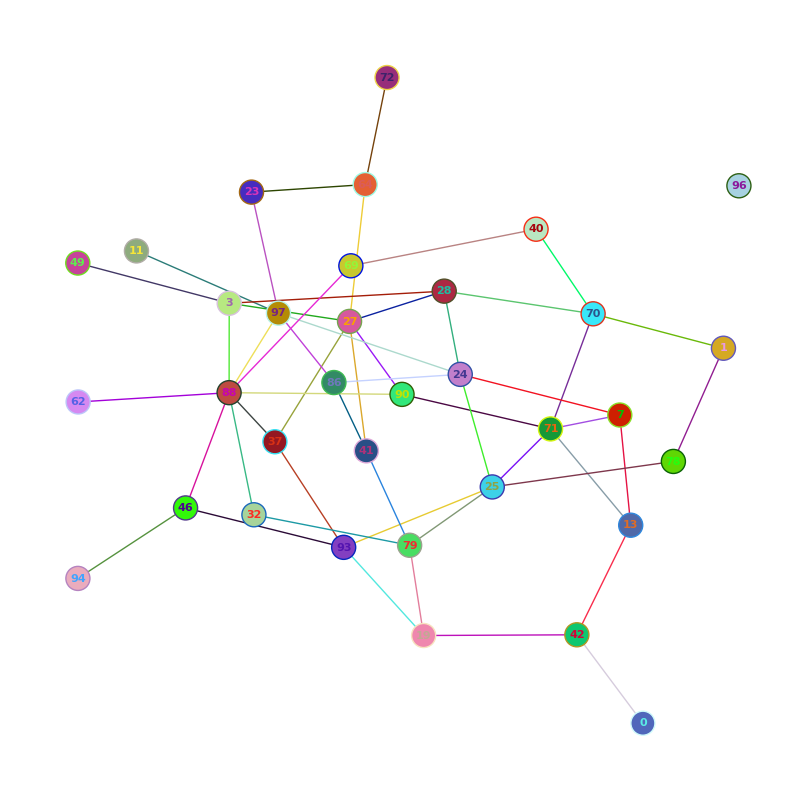

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


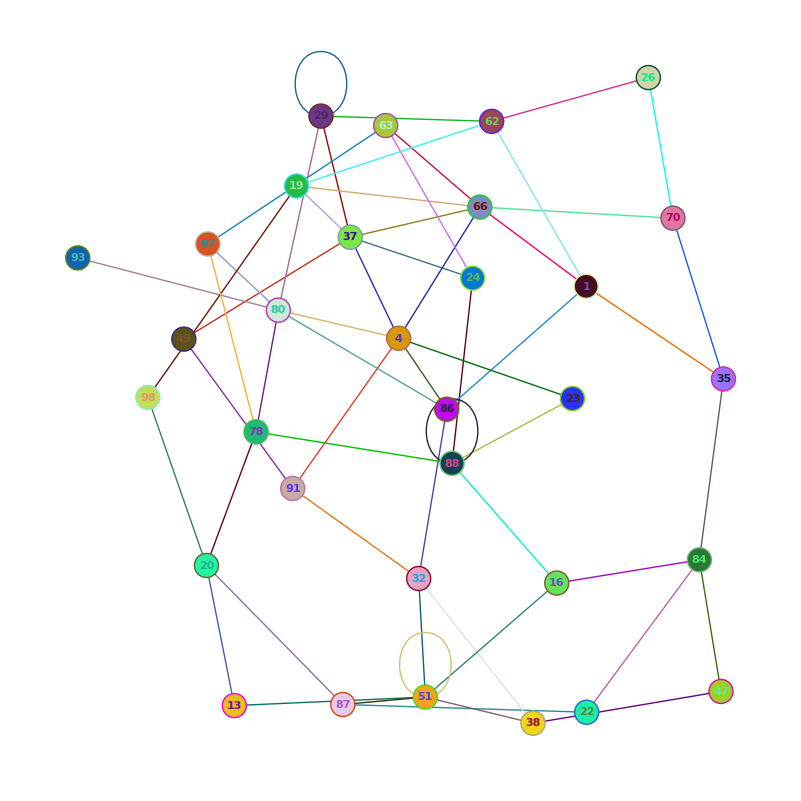

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


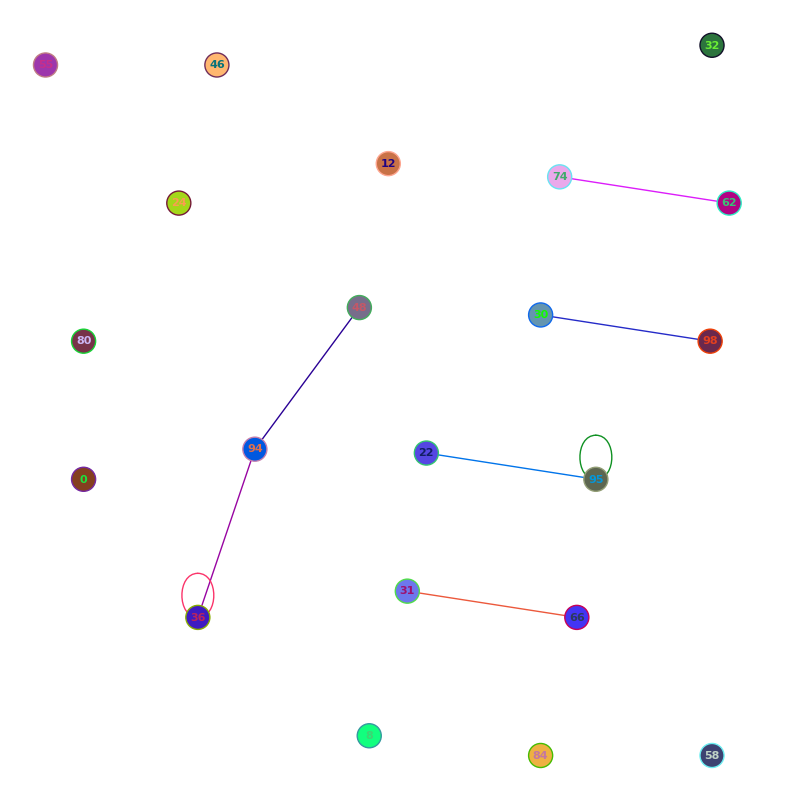

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


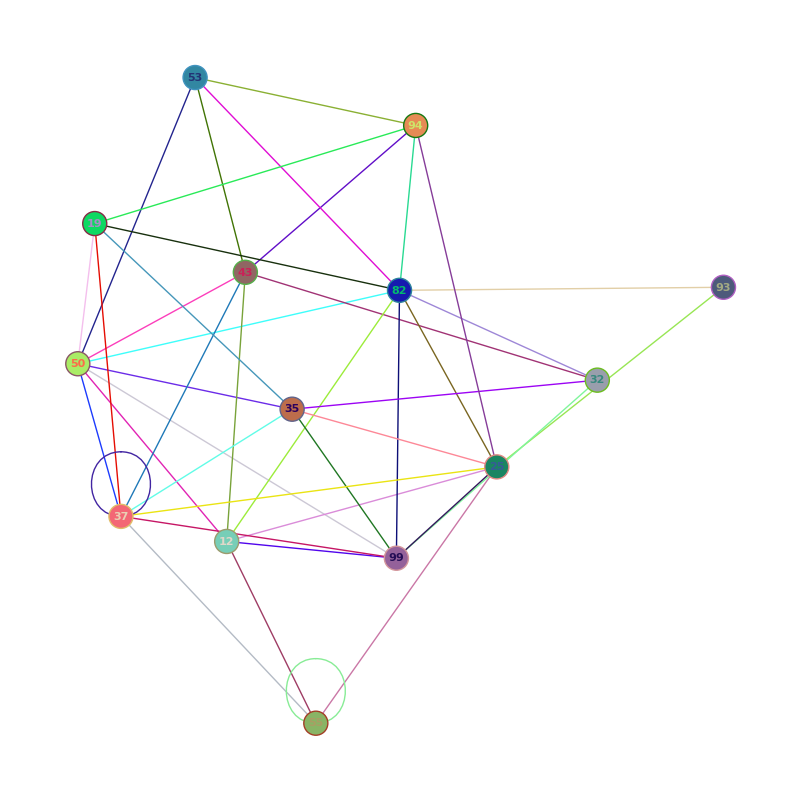

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


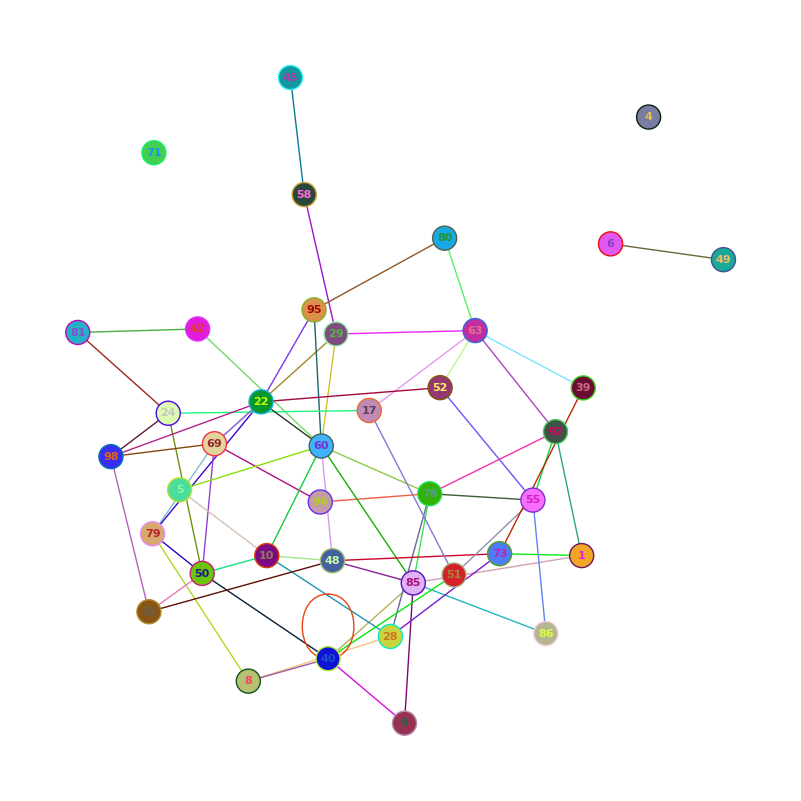

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


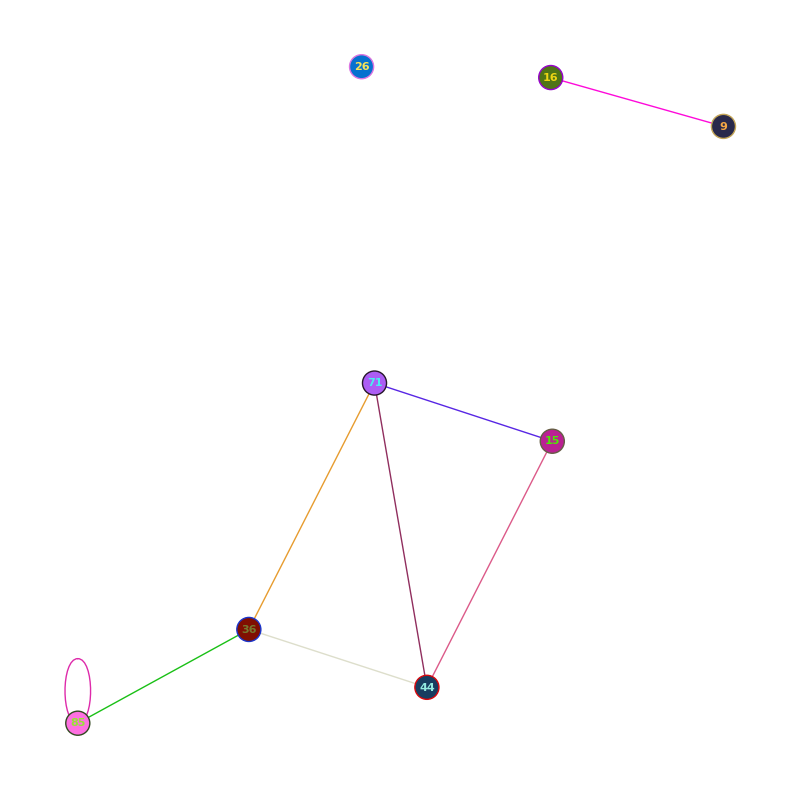

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


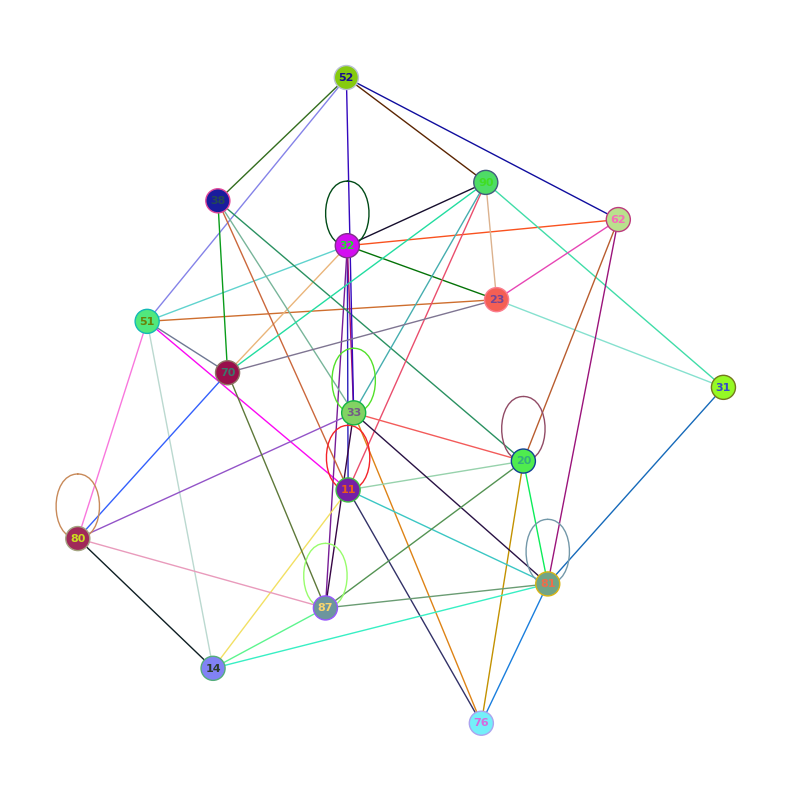

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


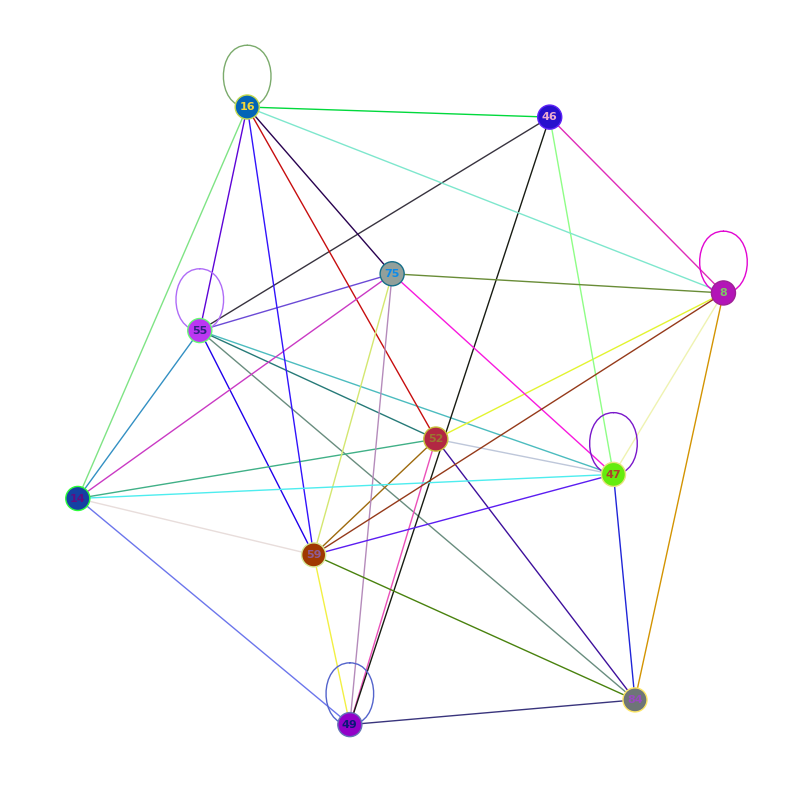

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


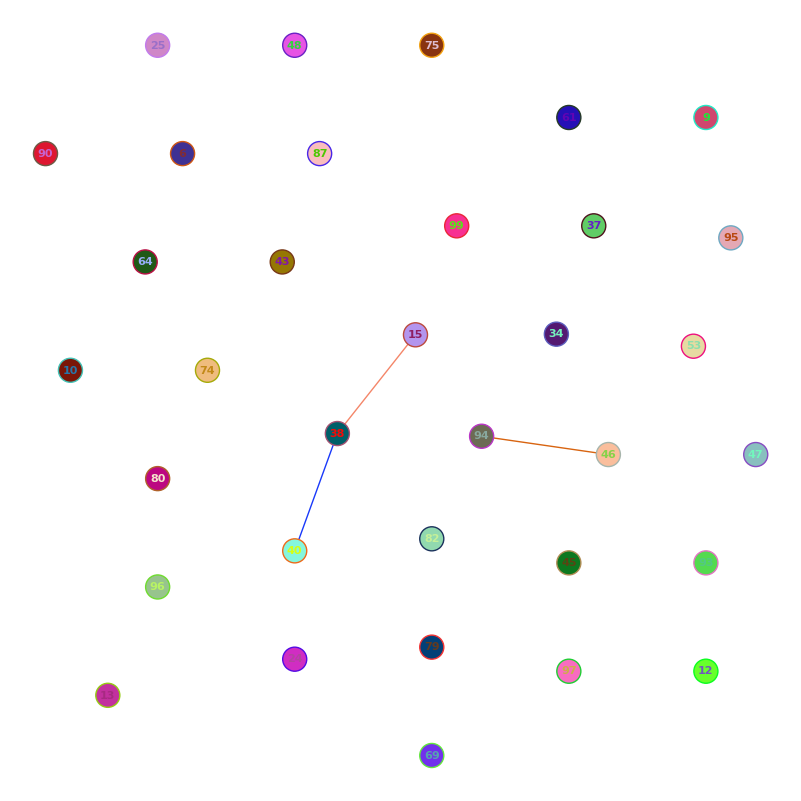

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


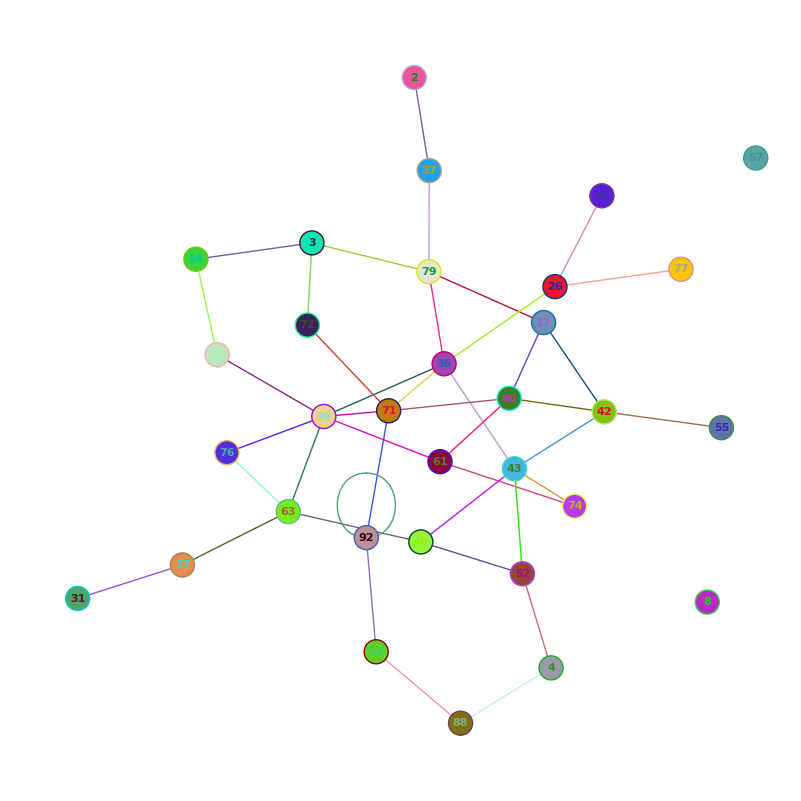

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


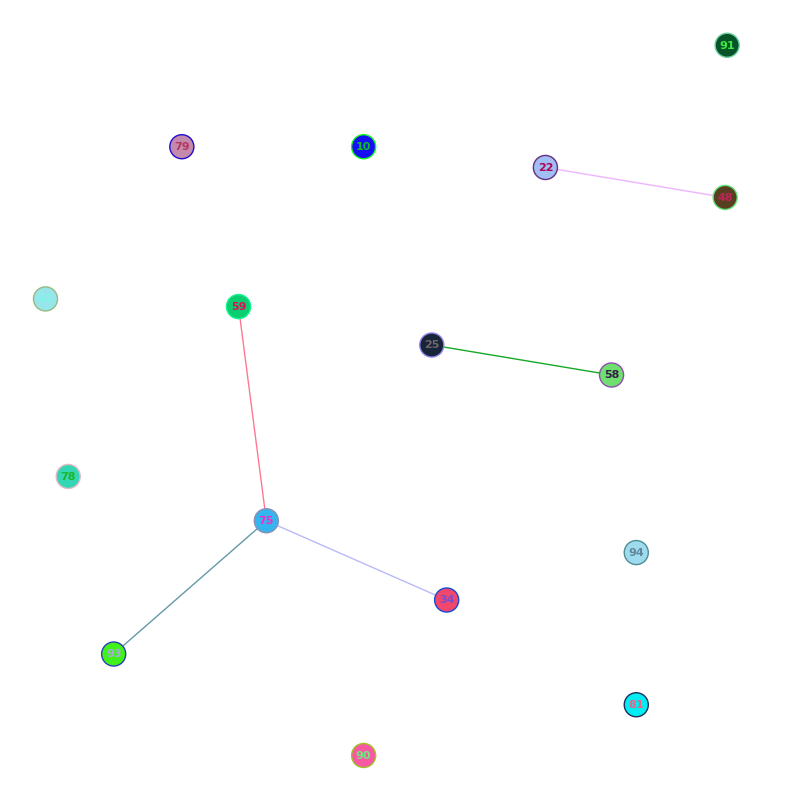

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


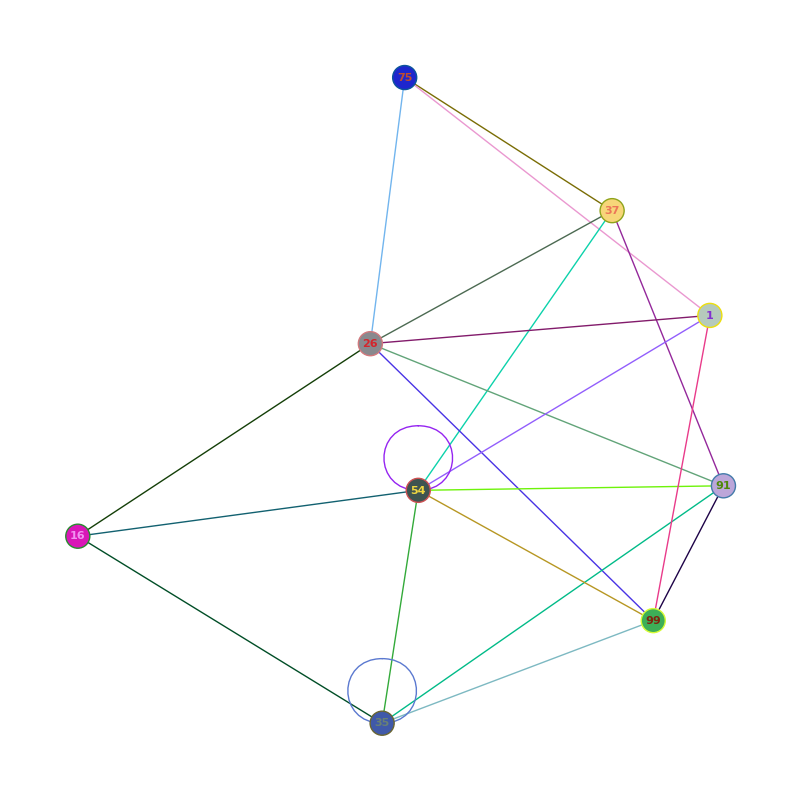

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


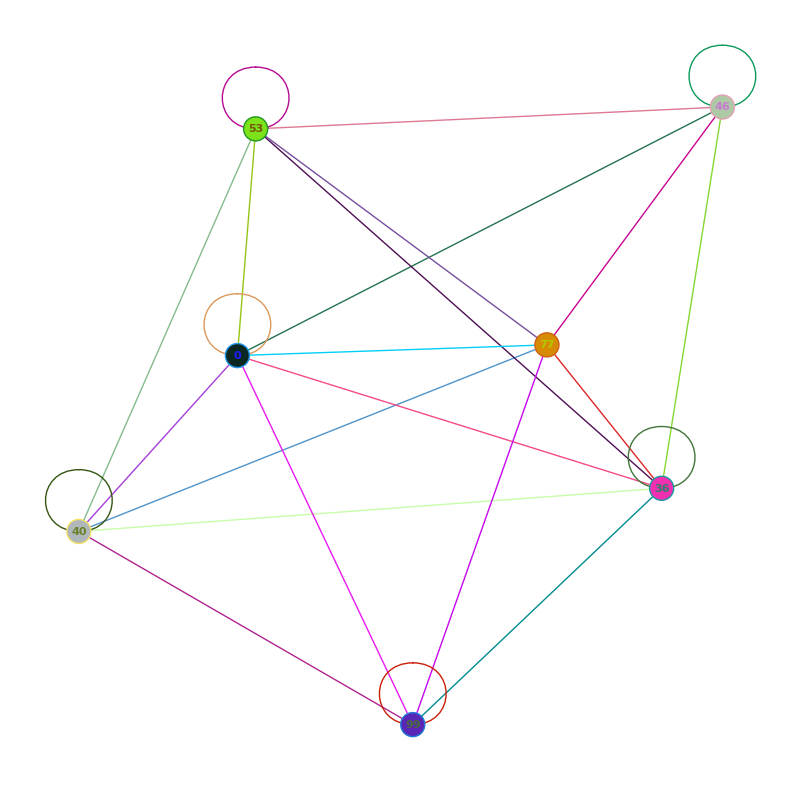

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


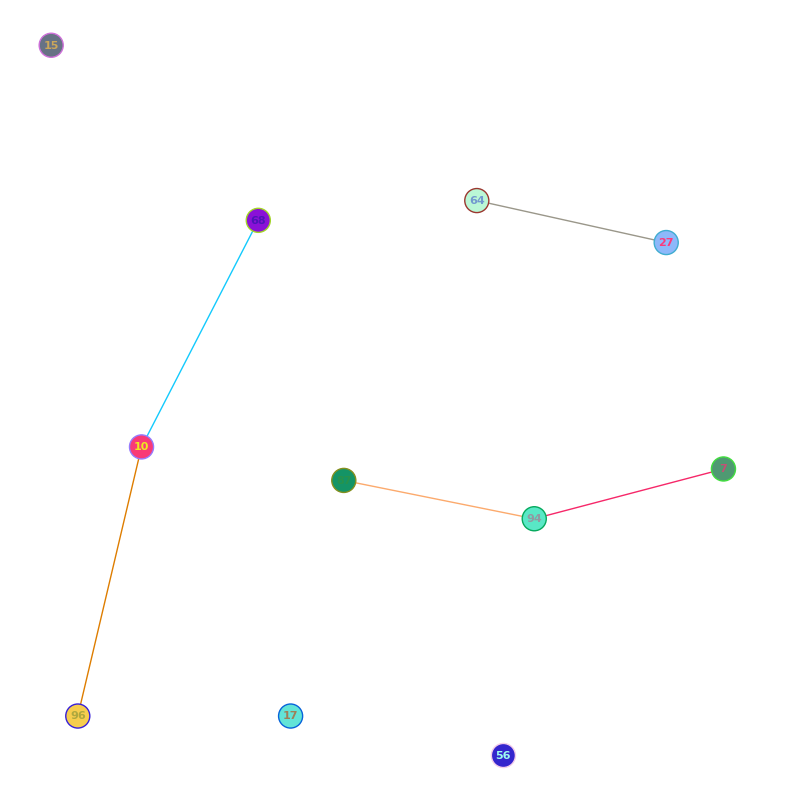

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


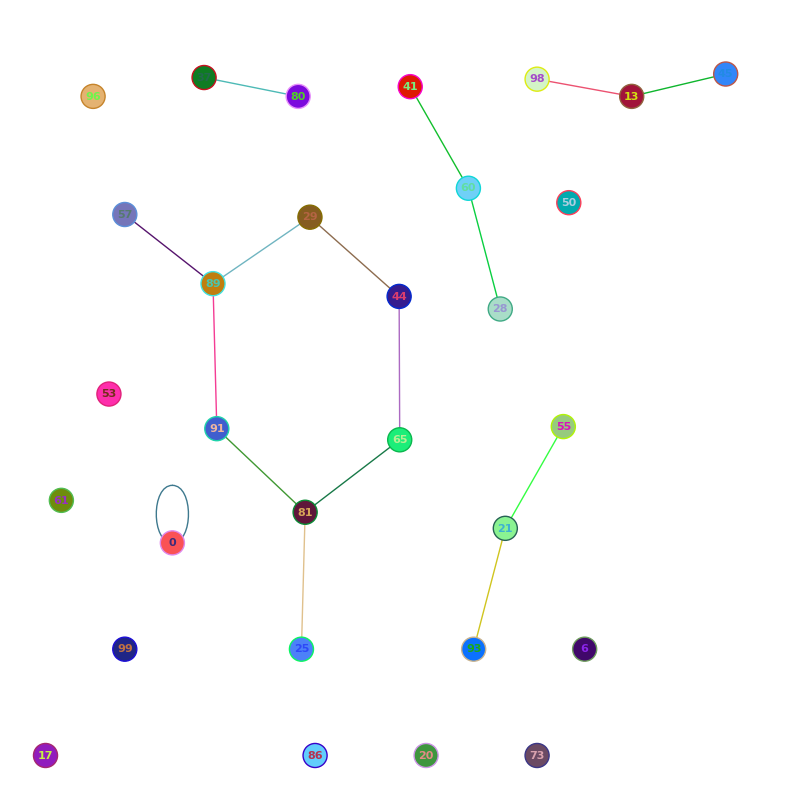

<ipython-input-116-a36774d2c25f>:41: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  pos = layout(G)


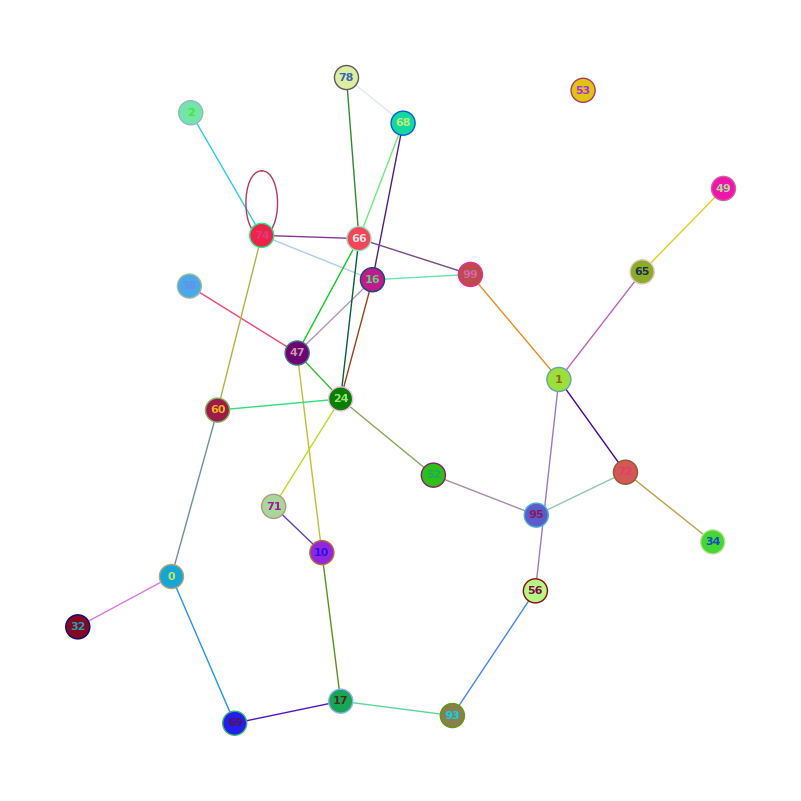

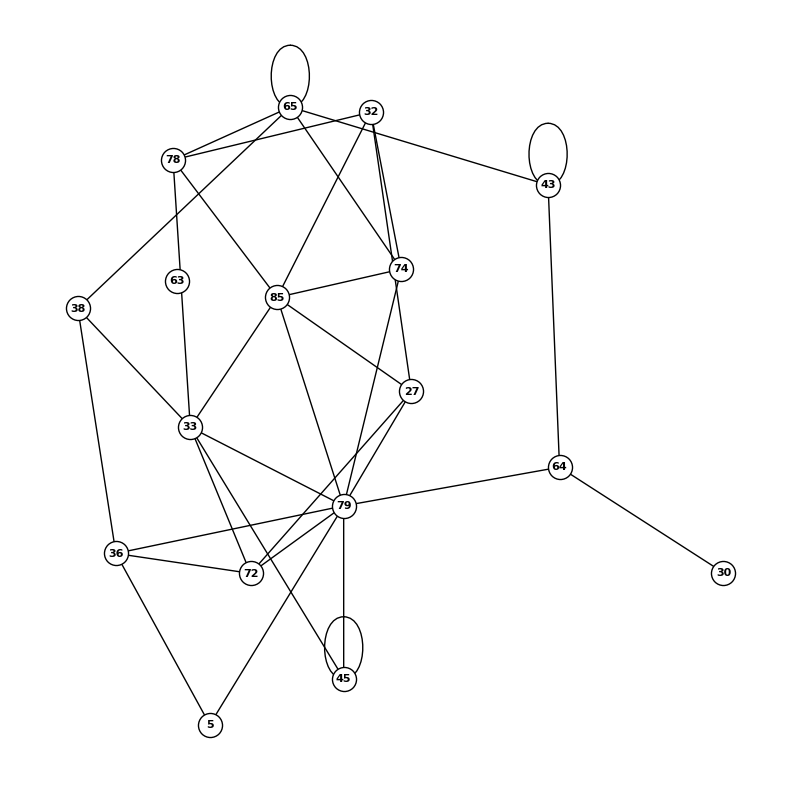

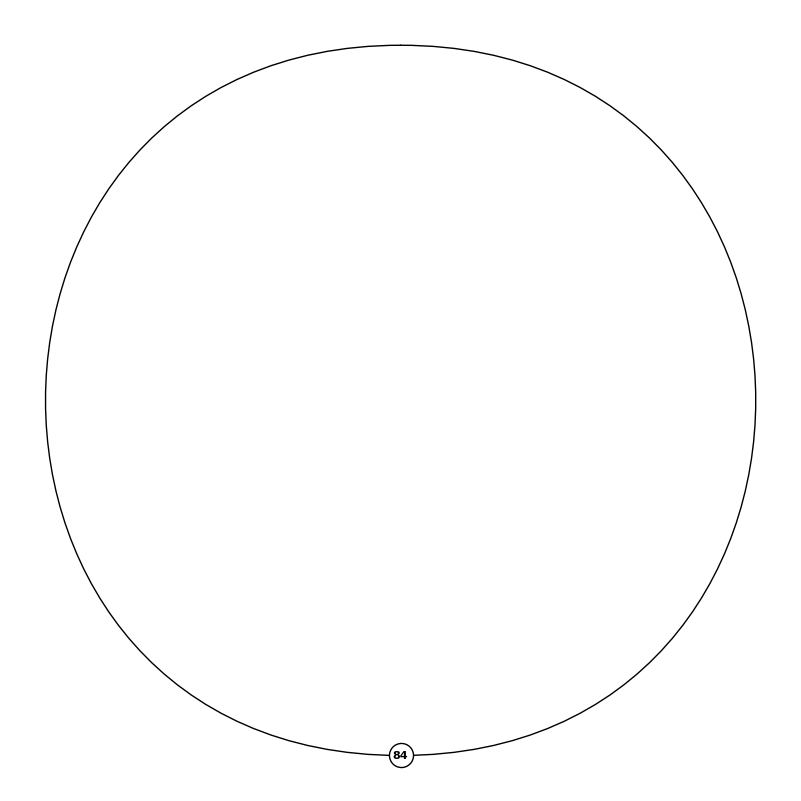

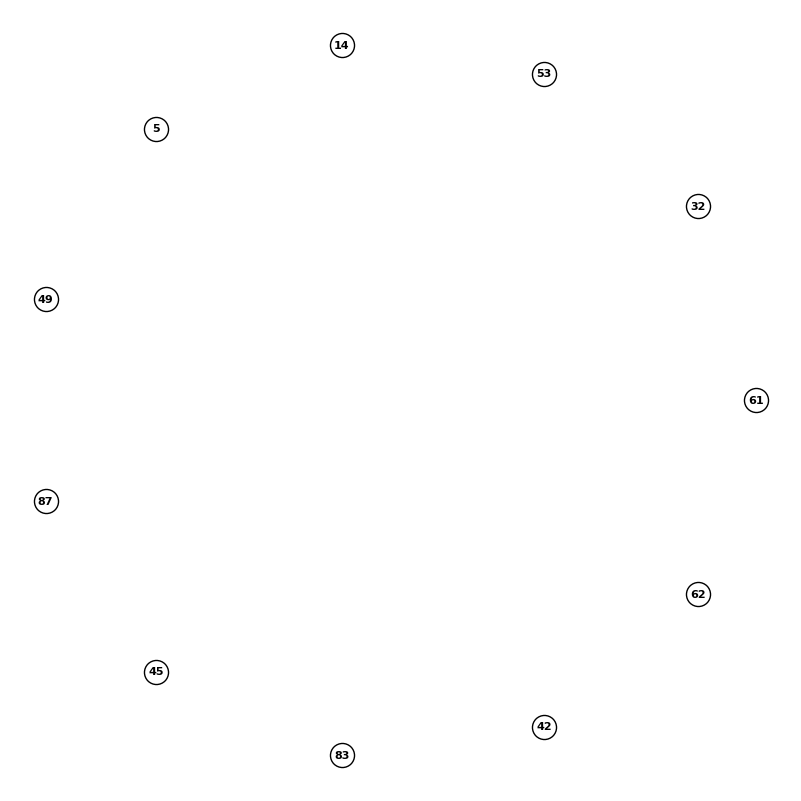

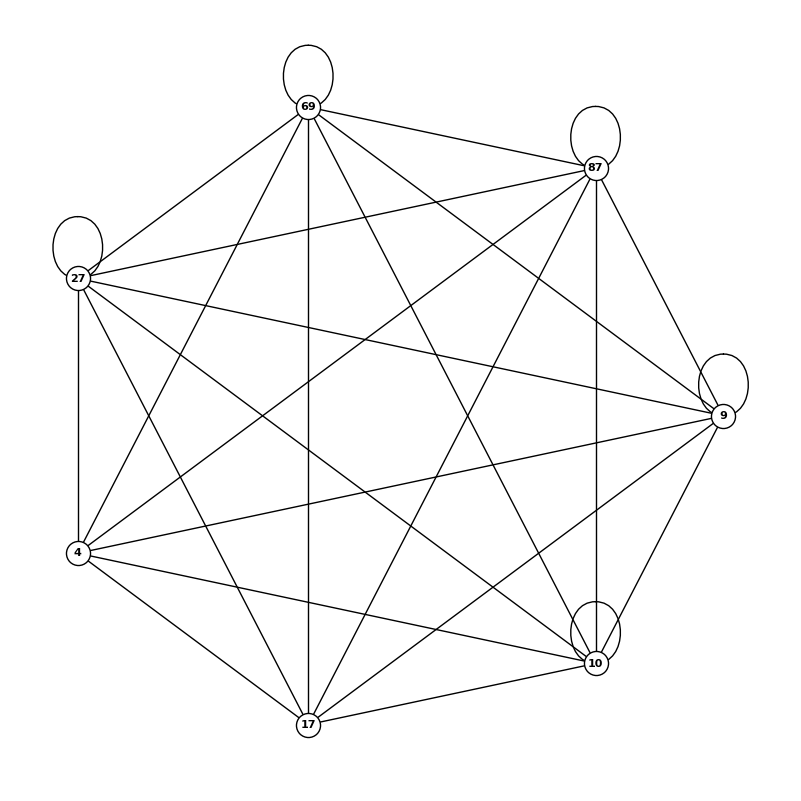

...

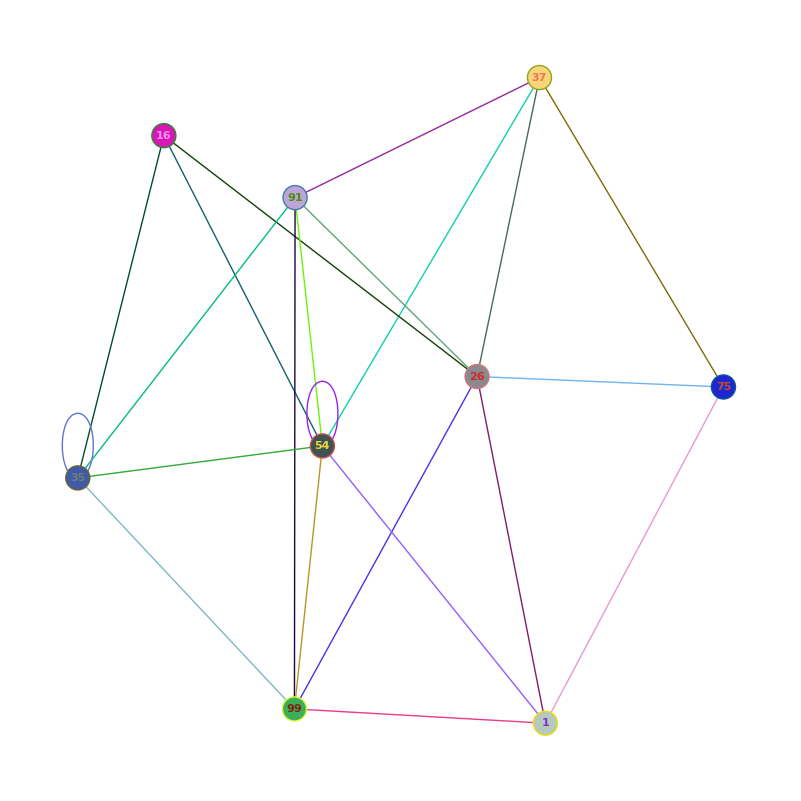

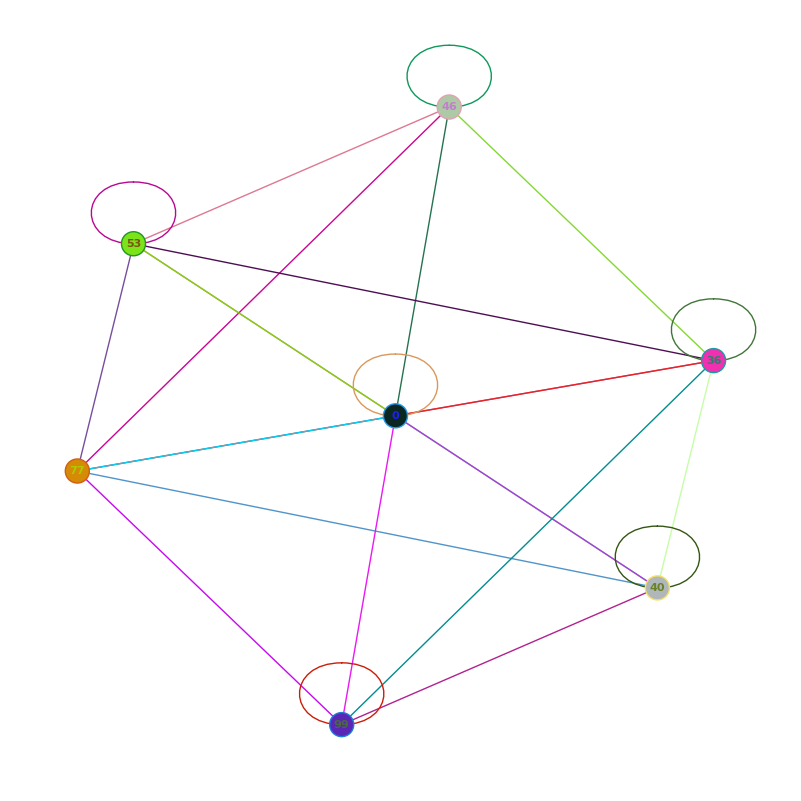

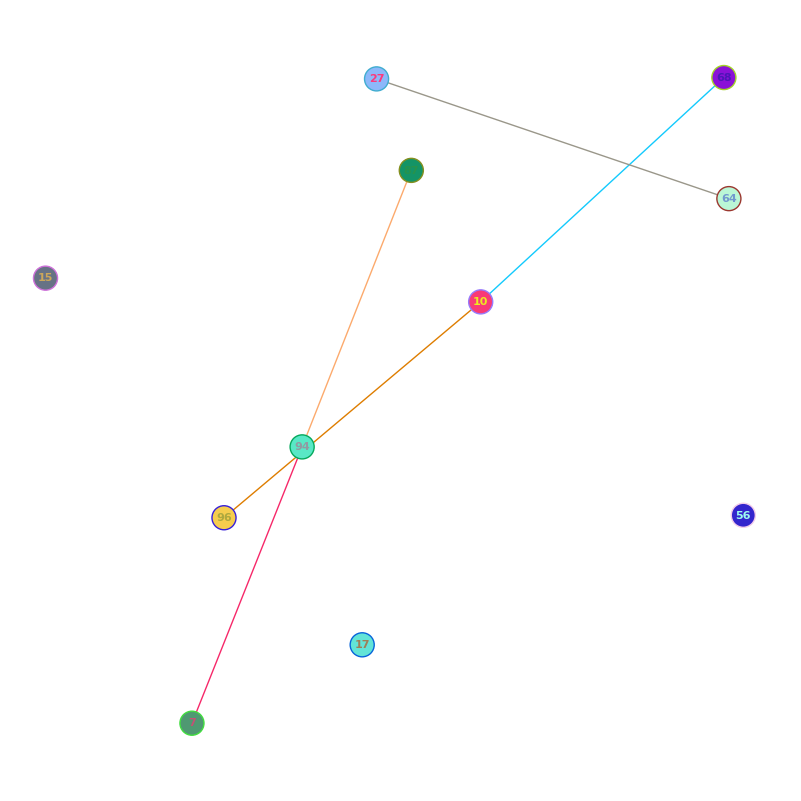

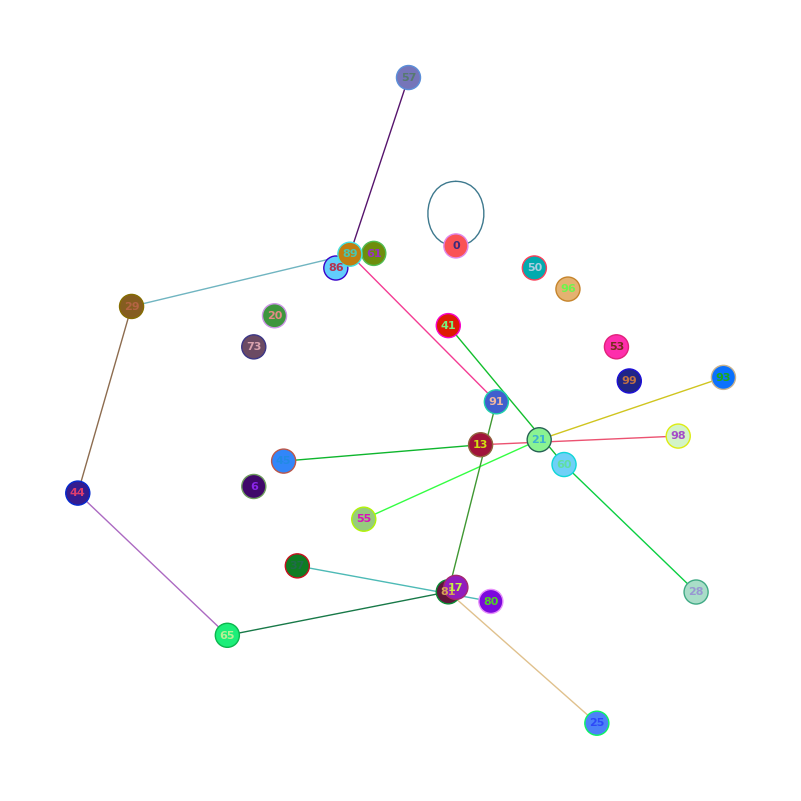

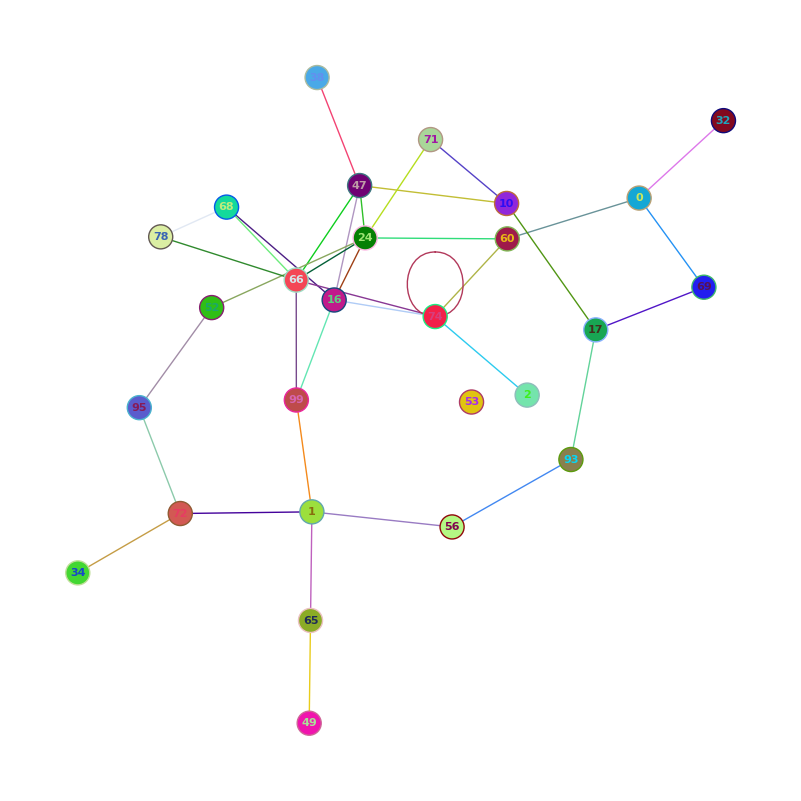

In [120]:
data_gv0 = generate_data(50, nx.nx_pydot.graphviz_layout, False, gv0)
data_gv1 = generate_data(50, nx.nx_pydot.graphviz_layout, True, gv1)
data_kk0 = generate_data(50, nx.kamada_kawai_layout, False, kk0)
data_kk1 = generate_data(50, nx.kamada_kawai_layout, True, kk1)

**This should be in Model**
This is dataloader used for training

In [121]:
import torch
from torch.utils.data import Dataset, DataLoader

In [122]:
class GraphImageDataset(Dataset):
    def __init__(self, data):
        self.data = data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        sample = self.data[index]
        # Assuming each sample is a tuple (input, target)
        input_data, target = sample

        # Convert the data to PyTorch tensors
        input_data = torch.tensor(input_data, dtype=torch.float32)
        target_tensors = {torch.tensor(key): torch.tensor(value) for key, value in target.items()}

        return input_data, target_tensors